In [1]:
# Initialize notebook 

# %matplotlib notebook
%matplotlib widget

import numpy as np
import math
import scipy as sp
from scipy.interpolate import LinearNDInterpolator,griddata,RegularGridInterpolator,RBFInterpolator,NearestNDInterpolator
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import matplotlib.ticker as ticker
from mpl_toolkits.mplot3d import Axes3D
import os
import re
import scipy.io as si
import scipy.signal as ss
from scipy.interpolate import RegularGridInterpolator as RGI
from time import time, localtime, strftime
from datetime import date
from itertools import islice
import matplotlib.animation as anim

import tifffile as tif
from xrayutilities.io import spec
# import cmath
from matplotlib import cm
import imutils as imu
from PIL import Image as pim

import h5py as h5
from skimage.restoration import unwrap_phase

# from xraylib import *
import xraylib as xb

from multiprocessing import Pool, cpu_count
from functools import partial
from function_test import *

from IPython.display import display

from ipywidgets import interact,widgets,Box

import sys
sys.path.append('/nsls2/users/ccheu/')
from Functions_File_Operation import *
from Functions_General_Geometry import *
from Functions_General_Algebra import *
from Functions_BCDI_DataProc import *
from Functions_Crystallography import *

# del Pool, cpu_count

Eqtools.trispline() is not available !


# Refra-index / critical angle calculation

In [2]:
# Pure element 
photonE = 5   # [keV]
element_Z = 14   # 13 - Al, 14 - Si, 24 - Cr, 29 - Cu, 74 - W, 79 - Au

if True:   # get constants 
    # Index of Refraction = (1-delta) - i(beta)
    delta = 1 - xb.Refractive_Index_Re(xb.AtomicNumberToSymbol(element_Z), photonE, xb.ElementDensity(element_Z))
    beta  = xb.Refractive_Index_Im(xb.AtomicNumberToSymbol(element_Z), photonE, xb.ElementDensity(element_Z))
    print('Photon energy:    %.3f keV ' %photonE )
    print('Wave length:      %.3f nm ' %(1.2398 / photonE) )
    print('--------------------')
    print('Element/material: %s ' %xb.AtomicNumberToSymbol(element_Z) )
    print('Density:          %.3f g/cm3 ' %xb.ElementDensity(element_Z))
    print('--------------------')
    print('Refra_index: delta = %g' %delta )
    print('             beta  = %g' %beta )
    print('Critical angle:   %.6f rad ' %np.sqrt(2*delta))
    print('                  %.6f deg ' %(np.sqrt(2*delta)*180/3.14) )
    if True:   # clean variables
        del photonE, element_Z
        del delta, beta

Photon energy:    5.000 keV 
Wave length:      0.248 nm 
--------------------
Element/material: Si 
Density:          2.330 g/cm3 
--------------------
Refra_index: delta = 1.98104e-05
             beta  = 1.12679e-06
Critical angle:   0.006294 rad 
                  0.360831 deg 


In [11]:
# Compound 
photonE = 5   # [keV]
compound = 'C5O2H8'

if True:   # get constants 
    # Index of Refraction = (1-delta) - i(beta)
    density = xb.GetCompoundDataNISTByIndex(xb.NIST_COMPOUND_POLYMETHYL_METHACRALATE_LUCITE_PERSPEX)['density']
    delta = 1 - xb.Refractive_Index_Re(compound, photonE, density)
    beta  = xb.Refractive_Index_Im(compound, photonE, density)
    print('Photon energy:    %.3f keV ' %photonE )
    print('Wave length:      %.3f nm ' %(1.2398 / photonE) )
    print('--------------------')
    print('Element/material: %s ' %compound )
    print('Density:          %.3f g/cm3 ' %density )
    print('--------------------')
    print('Refra_index: delta = %g' %delta )
    print('             beta  = %g' %beta )
    print('Critical angle:   %.6f rad ' %np.sqrt(2*delta))
    print('                  %.6f deg ' %(np.sqrt(2*delta)*180/3.14) )
    if True:   # clean variables 
        del photonE, compound
        del density, delta, beta

Photon energy:    5.000 keV 
Wave length:      0.248 nm 
--------------------
Element/material: C5O2H8 
Density:          1.190 g/cm3 
--------------------
Refra_index: delta = 1.0745e-05
             beta  = 6.29492e-08
Critical angle:   0.004636 rad 
                  0.265743 deg 


In [15]:
xb.CompoundParser('C5O2H8')

{'nElements': 3,
 'nAtomsAll': 15.0,
 'Elements': (1, 6, 8),
 'massFractions': (0.08069509637471288,
  0.5997203635274143,
  0.3195845400978728),
 'nAtoms': (8.0, 5.0, 2.0),
 'molarMass': 100.13}

In [30]:
xb.GetCompoundDataNISTByIndex(xb.NIST_COMPOUND_POLYMETHYL_METHACRALATE_LUCITE_PERSPEX)

{'name': 'Polymethyl Methacralate (Lucite, Perspex)',
 'nElements': 3,
 'density': 1.19,
 'Elements': (1, 6, 8),
 'massFractions': (0.080538, 0.599848, 0.319614)}

# GISAX on Si substrate

In [ ]:
##Input Parameters
print('Wave Propagation Size:')
wave_prop_size = input()
print('Wave Grid Step:')
wave_grid_step = list(float(i) for i in ((input().split(','))))
print(wave_grid_step)

In [97]:
wave_prop_step = widgets.FloatText(value = 0, description = 'Wave Propogation Step', disabled = False)
wave_prop_dist = widgets.FloatText(value = 0, description = 'Wave Propagation Distance', disabled = False)

Box(children = [wave_prop_step,wave_prop_dist])

Box(children=(FloatText(value=0.0, description='Wave Propogation Step'), FloatText(value=0.0, description='Wav…

In [98]:
wave_prop_step = wave_prop_step.value

In [2]:
wave_prop_size = [3020, 5000]   # [x pix, y pix]
wave_grid_step = [5.0, 5.0]   # [nm], [X, Y]
wave_prop_step = 5   # [nm]
wave_prop_dist = 200 * 1e3   # [nm]
dist_to_focal = -100 * 1e3   # [nm]

photonE = 17.2   # 1.772e-3   # [keV]
gau_width_param = [10e3,10e3]#[18.25e3, 18.25e3]   # [nm]
gau_cen_offset = [0, 0.0e3]   # [nm]
beam_flux = 1.0e13   # [ph/s]
incident_ang = 0.1 # [deg]
y_ang = 0.0
rot_ax = [1,0]

temp = wave_grid_step[1] * np.sin(np.deg2rad(incident_ang)) / (1.2398 / photonE) * 2
if np.remainder(temp, 2) >=1: 
    print(' Potential sampling issue !!!')

prop_dist = 200
layers = prop_dist/wave_prop_step

In [3]:
dist_to_samp = wave_prop_step*50

In [4]:
x_ang = np.linspace(-30,30,9)
y_list = np.linspace(-30,30,9)

In [5]:
zeros = np.zeros((1,len(x_ang)))
zerosy = np.zeros((1,len((x_ang))))

In [6]:
zeros[0]

array([0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [7]:
x_ang2 = np.linspace(-0.1,0.1,20)
y_list2 = np.linspace(-0.1,0.1,20)

In [8]:
x_inv = np.negative(x_ang)
y_inv = np.negative(y_list)

In [9]:
start_gau_cen_x = dist_to_samp*np.tan(np.deg2rad(x_ang))

In [10]:
start_gau_cen_x

array([-144.3375673 , -103.55339059,  -66.98729811,  -32.9131244 ,
          0.        ,   32.9131244 ,   66.98729811,  103.55339059,
        144.3375673 ])

In [11]:
gau_cen_offset[1]

0.0

In [12]:
x_ang

array([-30. , -22.5, -15. ,  -7.5,   0. ,   7.5,  15. ,  22.5,  30. ])

In [13]:
CalLat_beamspec_estimate(z=5e6, fwhm=1e6, wave_len=700)

fwhm_0 = 1000.000 [um]   # fwhm at waist
z_bar  = 1.122 [m]   # Rayleigh range
fwhm_z = 1.000 [mm]   # fwhm at z
R_o_C  = 251.781 [m]   # radius of curvature


In [14]:
a = list(zip(x_ang,y_list))

In [15]:
a2 = list(zip(x_ang2,y_list2))

In [16]:
b = list(zip(x_inv,y_inv))

In [17]:
rot_list = []
for i in np.arange(0,len(x_ang)):
    rot = [1,0]#np.random.choice(2),np.random.choice(2)]
    rot_list.append(rot)

In [18]:
rot_list2 = []
for i in np.arange(0,len(x_inv)):
    rot = [1,0]#np.random.choice(2),np.random.choice(2)]
    rot_list2.append(rot)

In [19]:
len(x_ang)

9

In [20]:
angles = np.array(list(zip(a,rot_list)))

In [21]:
angles[0]

array([[-30., -30.],
       [  1.,   0.]])

In [22]:
inv_ang = np.array(list(zip(b,rot_list2)))

In [23]:
zerozip = list(zip(zeros,zerosy))
zerozip

[(array([0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([0., 0., 0., 0., 0., 0., 0., 0., 0.]))]

In [24]:
zero_ang = list(zip(list(zip(zeros[0],zerosy[0]),),rot_list))

In [25]:
rot_list
print(angles)

[[[-30.  -30. ]
  [  1.    0. ]]

 [[-22.5 -22.5]
  [  1.    0. ]]

 [[-15.  -15. ]
  [  1.    0. ]]

 [[ -7.5  -7.5]
  [  1.    0. ]]

 [[  0.    0. ]
  [  1.    0. ]]

 [[  7.5   7.5]
  [  1.    0. ]]

 [[ 15.   15. ]
  [  1.    0. ]]

 [[ 22.5  22.5]
  [  1.    0. ]]

 [[ 30.   30. ]
  [  1.    0. ]]]


In [26]:
rot_list

[[1, 0], [1, 0], [1, 0], [1, 0], [1, 0], [1, 0], [1, 0], [1, 0], [1, 0]]

In [27]:
#for a,b in angles:
#    print(a)

In [28]:
len(x_ang)

9

In [29]:
zero_ang

[((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0]),
 ((0.0, 0.0), [1, 0])]

## Create incident wave

In [30]:
def gaussplots(*args):
    # Gaussian wave at focal plane (backup)
    flag_plot = True

    x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
    y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1] 
    # amplitude
    wf_fc_amp = Gaussian_2D(x_ax,y_ax,1,0, gau_cen_offset[0]-args[0], gau_width_param[0]/2.355, gau_cen_offset[1],gau_width_param[1]/2.355)
    # phase
    wf_fc_ph = np.zeros(wave_prop_size)
    wf_fc = wf_fc_amp * np.exp(-1j * wf_fc_ph)
    # wavefront at focal plane
    print(np.shape(wf_fc))
    wf_fc *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc * np.conjugate(wf_fc))))
    print('%g' %np.sum( np.abs(wf_fc * np.conjugate(wf_fc)) ) )
    if flag_plot:   # 1D plot of wavefront 
        temp = wf_fc
        lim_region = False
        plot_region = [-10, 10]

        a = plt.figure(figsize=(10,3.5))
        plt.subplot(121)
        plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
        plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
        plt.legend(); plt.xlabel('x/y_ax [um]')
        if lim_region: 
            plt.xlim(plot_region)
        plt.subplot(122)
        plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
        plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
        plt.legend(); plt.xlabel('x/y_ax [um]')
        if lim_region: 
            plt.xlim(plot_region)
        plt.tight_layout()
        del temp, plot_region, lim_region
        plt.close()
    if flag_plot:   # 2D plot of wavefront 
        temp = wf_fc
        lim_region = False
        plot_region = [-10, 10, -10, 10]

        b = plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.abs(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Amplitude'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.subplot(122)
        plt.imshow(np.angle(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Phase'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.tight_layout()
        del temp, plot_region, lim_region
    del wf_fc_amp, wf_fc_ph, x_ax, y_ax, flag_plot
    plt.close()
    return wf_fc,a,b

In [31]:
wf_fc_list = []
for i in np.arange(len(start_gau_cen_x)):
    wf_fc_sub,a,b = gaussplots(start_gau_cen_x[i])
    wf_fc_list.append(wf_fc_sub)

(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13


In [32]:
# Modify wavefront 
def mod_wave(*args):
    flag_plot = True
    
    x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
    y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
    # amplitude
    wf_fc = args[0]
    wf_fc_amp = np.abs(wf_fc)
    y_ang = args[1][0][1]
    incident_ang = args[1][0][0]
    rot_ax = args[1][1]
    # phase
    wf_fc_ph_ramp = np.zeros(wave_prop_size)
    if  rot_ax[0] != 0 and rot_ax[1] == 0:   # rot around axis=0 
        for ii in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[ii, :] = (y_ax) * np.sin(np.deg2rad(incident_ang)) / (1.2398 / photonE) * 2 * np.pi
        wf_fc_mod = wf_fc_amp * np.exp(-1j * (wf_fc_ph_ramp + np.angle(wf_fc)) )
        print(np.shape(wf_fc))
        wf_fc_mod *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc * np.conjugate(wf_fc))))
    if  rot_ax[1] != 0 and rot_ax[0] == 0:   # rot around axis=0 
        for jj in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[:,jj] += (x_ax) * np.sin(np.deg2rad(y_ang)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] != 0:   # rot around axis=0 
        for ii in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
            for jj in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
                a = (x_ax[jj]) * np.sin(np.deg2rad(y_ang)) / (1.2398 / photonE) * 2 * np.pi
                b = (y_ax[ii]) * np.sin(np.deg2rad(incident_ang)) / (1.2398 / photonE) * 2 * np.pi
                wf_fc_ph_ramp[jj,ii] += a + b
        #((x_ax[jj]) * np.sin(np.deg2rad(y_ang))/ (1.2398 / photonE) * 2 * np.pi)**2 + ((y_ax[ii]) * np.sin(np.deg2rad(incident_ang))/ (1.2398 / photonE) * 2 * np.pi)**2+2*(y_ax[ii]* np.sin(np.deg2rad(incident_ang))*x_ax[jj]* np.sin(np.deg2rad(y_ang)))*np.cos(0.5)/((1.2398 / photonE) * 2 * np.pi*(1.2398 / photonE) * 2 * np.pi)
    #Look at the DOI paper for reference
    
    print('%g' %np.sum( np.abs(wf_fc * np.conjugate(wf_fc)) ) )
    if flag_plot:   # 1D plot incident wavefront 
        temp = wf_fc_mod
        plt.figure(figsize=(10,3.5))
        plt.subplot(121)
        plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
        plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
        plt.legend(); plt.xlabel('x/y_ax [um]')
        plt.subplot(122)
        plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
        plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
        plt.legend(); plt.xlabel('x/y_ax [um]')
        plt.tight_layout()
        del temp
    if flag_plot:   # 2D plot incident wavefront 
        temp = wf_fc_mod
        lim_region = False
        plot_region = [-.1, .1, -2.1, -1.9]
        
        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.abs(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Amplitude'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.subplot(122)
        plt.imshow(np.angle(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Phase'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.tight_layout()
        del temp, plot_region, lim_region
    #plt.close()
    return wf_fc_mod
    del wf_fc_amp, wf_fc_ph_ramp, x_ax, y_ax, flag_plot

In [33]:
modlist = []

In [598]:
for i in np.arange(len(y_list)):
    wavesub = wave_mod(wf_fc_list[i],angles[i])
    modlist.append(wavesub)

NameError: name 'wave_mod' is not defined

(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13
(3020, 5000)
1e+13


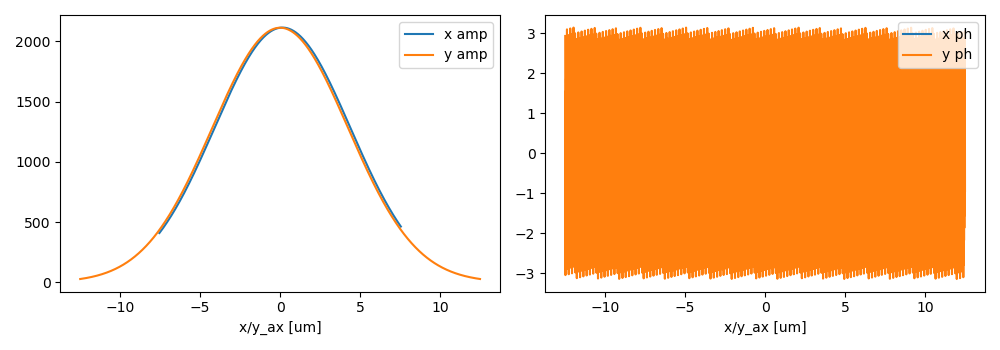

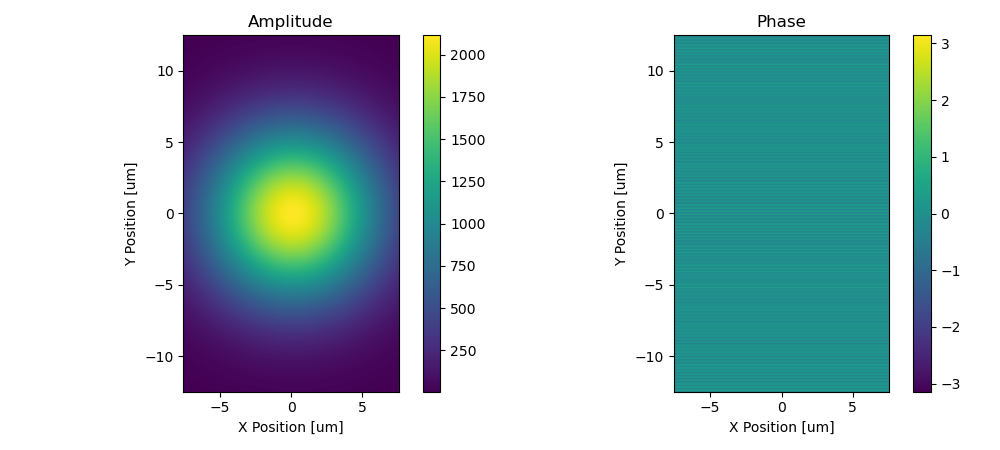

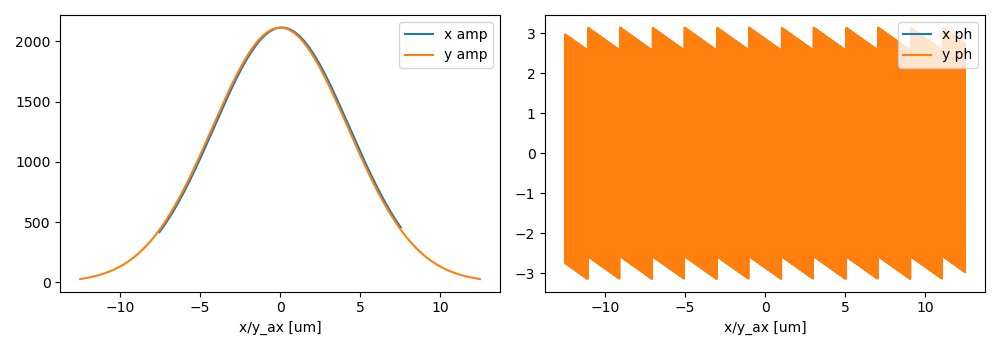

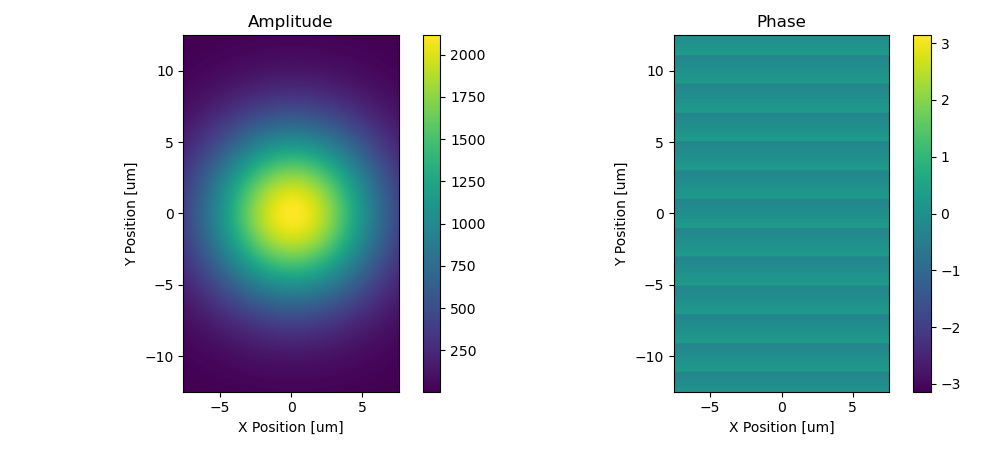

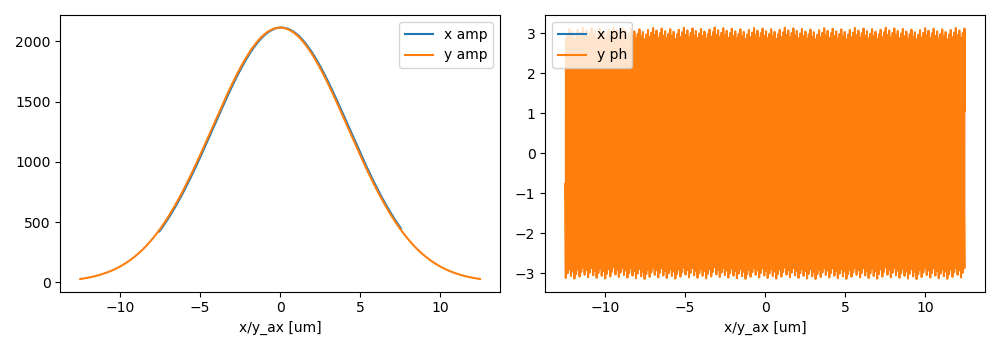

...

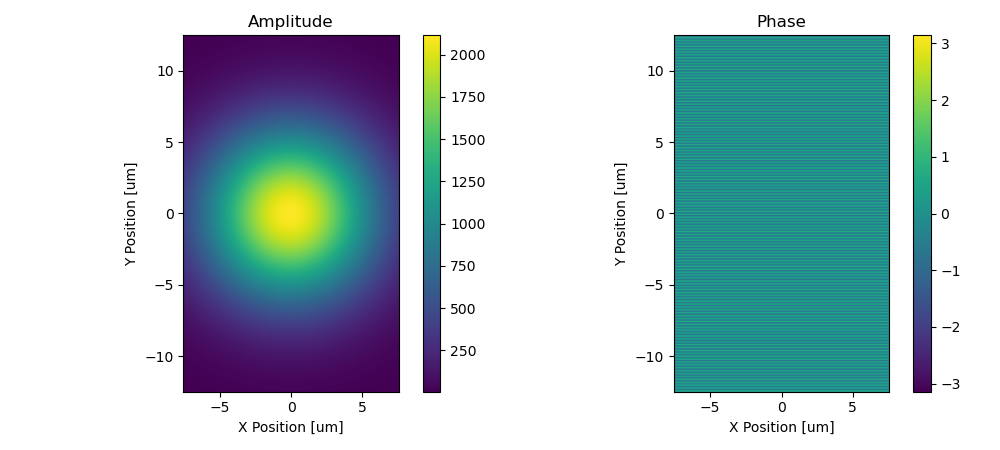

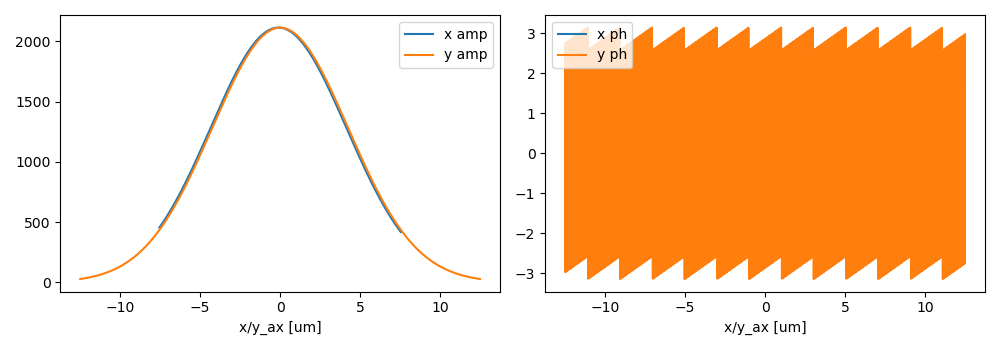

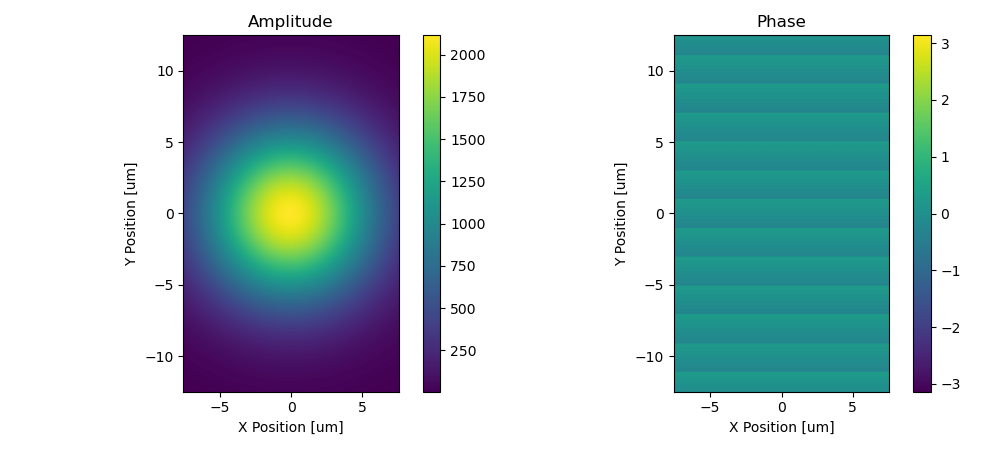

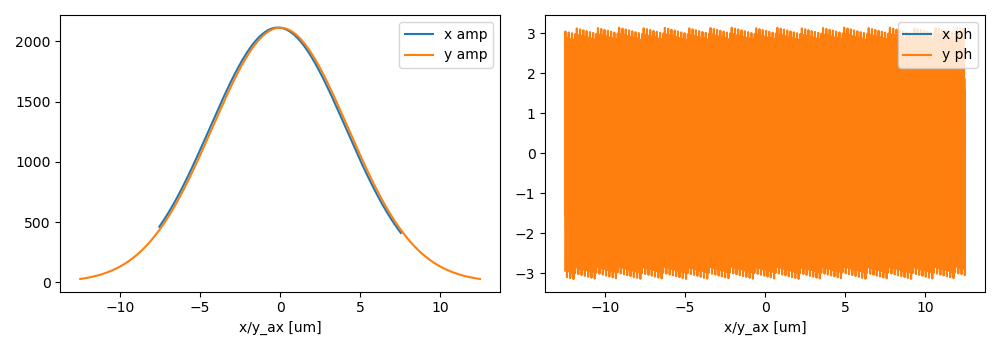

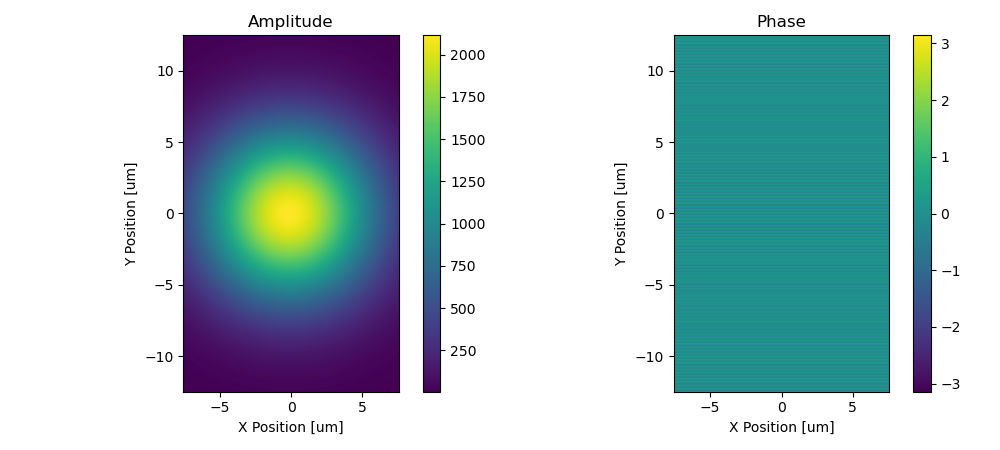

In [34]:
for i in np.arange(len(x_ang)):
    wavesub = mod_wave(wf_fc_list[i],angles[i])
    modlist.append(wavesub)

modlist = []

In [208]:
# Modify wavefront Batch (Inverse)
flag_plot = True

x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
wf_fc_list = []
wf_ramp_inv = []
for b, rot_ax in angles:
    print(a)
    x = a[0]
    y = a[1]
    print(rot_ax)
    # amplitude
    wf_fc_amp = np.abs(wf_fc)
    # phase
    wf_fc_ph_ramp = np.zeros(wave_prop_size)
    if  rot_ax[0] != 0 and rot_ax[1] == 0:   # rot around axis=0 
        for ii in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[ii,:] = (y_ax) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] == 0:   # rot around axis=0 
        for jj in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[:,jj] += (x_ax) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] != 0:   # rot around axis=0 
        for ii in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
            for jj in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
                a = (x_ax[jj]) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
                b = (y_ax[ii]) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
                wf_fc_ph_ramp[jj,ii] += a + b
    #((x_ax[jj]) * np.sin(np.deg2rad(y_ang))/ (1.2398 / photonE) * 2 * np.pi)**2 + ((y_ax[ii]) * np.sin(np.deg2rad(incident_ang))/ (1.2398 / photonE) * 2 * np.pi)**2+2*(y_ax[ii]* np.sin(np.deg2rad(incident_ang))*x_ax[jj]* np.sin(np.deg2rad(y_ang)))*np.cos(0.5)/((1.2398 / photonE) * 2 * np.pi*(1.2398 / photonE) * 2 * np.pi)
    #Look at the DOI paper for reference
    wf_fc_mod = wf_fc_amp * np.exp(-1j * (wf_fc_ph_ramp + np.angle(wf_fc)) )
    print(np.shape(wf_fc))
    wf_fc_mod *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc * np.conjugate(wf_fc))))
    wf_ramp_inv.append(wf_fc_ph_ramp)
print('%g' %np.sum( np.abs(wf_fc * np.conjugate(wf_fc)) ) )
if flag_plot:   # 1D plot incident wavefront 
    temp = wf_fc_mod
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.tight_layout()
    del temp
if flag_plot:   # 2D plot incident wavefront 
    temp = wf_fc_mod
    lim_region = False
    plot_region = [-.1, .1, -2.1, -1.9]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.tight_layout()
    del temp, plot_region, lim_region
del wf_fc_amp, wf_fc_ph_ramp, x_ax, y_ax, flag_plot

Figure(1000x350)


TypeError: 'Figure' object is not subscriptable

In [1]:
len(wf_fc_list)

NameError: name 'wf_fc_list' is not defined

In [ ]:
# Back propagation 
flag_plot = True

back_prop_size = wave_prop_size
back_prop_dist = dist_to_focal
back_prop_step = back_prop_dist   # [nm] 
back_prop_grid = wave_grid_step   # [nm]

x_ax = (np.arange(back_prop_size[0]) - int(back_prop_size[0]/2)) * back_prop_grid[0]
y_ax = (np.arange(back_prop_size[1]) - int(back_prop_size[1]/2)) * back_prop_grid[1]

N = int(np.abs(back_prop_dist / back_prop_step))
print(N)
if N != 1: 
    wf_record = np.zeros((N, wave_prop_size[0], wave_prop_size[1])) * (1 + 1j)
wf_temp = wf_fc_mod.copy()
for ii in range(N): 
    print('Back propagating %d / %d' %(ii+1, N), end='\r')
    wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=back_prop_step, grid_size=back_prop_grid, 
                                          wave_len=1.2398 / photonE, pad_size=back_prop_size, flag_cropout=False)
    if N != 1: 
        wf_record[ii] = wf_temp
print('Back propagating %d / %d' %(ii+1, N), end='\n' )
wf_bp = wf_temp
if flag_plot:   # 1D plot of wavefront 
    temp = wf_bp
    lim_region = False
    plot_region = [-10, 10]
    
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    if lim_region: 
        plt.xlim(plot_region)
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    if lim_region: 
        plt.xlim(plot_region)
    plt.tight_layout()
    del temp, plot_region, lim_region
if flag_plot:   # 2D plot of wavefront 
    temp = wf_bp
    lim_region = False
    plot_region = [-10, 10, -10, 10]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('Position [um]'); plt.ylabel('Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('Position [um]'); plt.ylabel('Position [um]')
    plt.tight_layout()
    del temp, plot_region, lim_region
del wf_temp, x_ax, y_ax, flag_plot
if N != 1: 
    plot_region = [-60, 0, -30, 30]
    if True:   # 2D plot of wavefront 
        temp = np.abs(wf_record)
        lim_region = True

        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.log10(temp[:, :, int(np.shape(temp)[2]/2 + gau_cen_offset[1]/wave_grid_step[1])]).transpose(), origin='lower', 
                   extent=[ 0, back_prop_dist/1e4, 
                           -np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3, 
                            np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.colorbar(); plt.title('XZ slice at Y = %0.3f [um]' %(gau_cen_offset[1]/1e3))
        plt.ylabel('X [um]'); plt.xlabel('Z [x10 um]')
        plt.tight_layout()
        plt.subplot(122)
        plt.imshow(np.log10(temp[:, int(np.shape(temp)[1]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]).transpose(), origin='lower', 
                   extent=[ 0, back_prop_dist/1e4, 
                           -np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3, 
                            np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.colorbar(); plt.title('YZ slice at X = %0.3f [um]' %(gau_cen_offset[0]/1e3))
        plt.ylabel('Y [um]'); plt.xlabel('Z [x10 um]')
        plt.tight_layout()
        del temp, lim_region
    del plot_region, wf_record

1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1


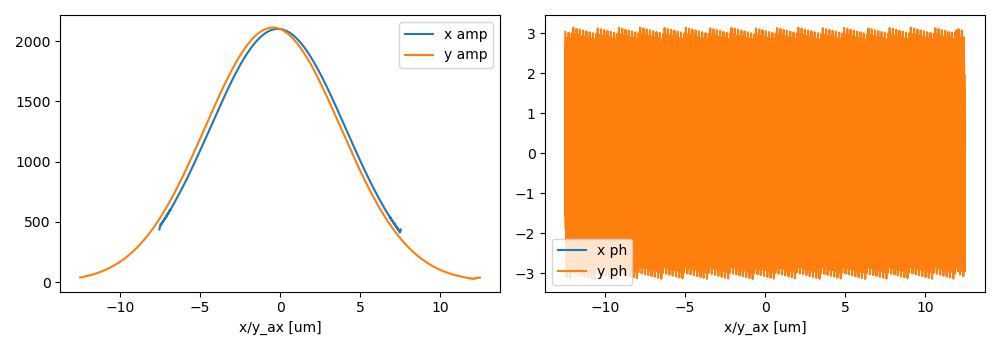

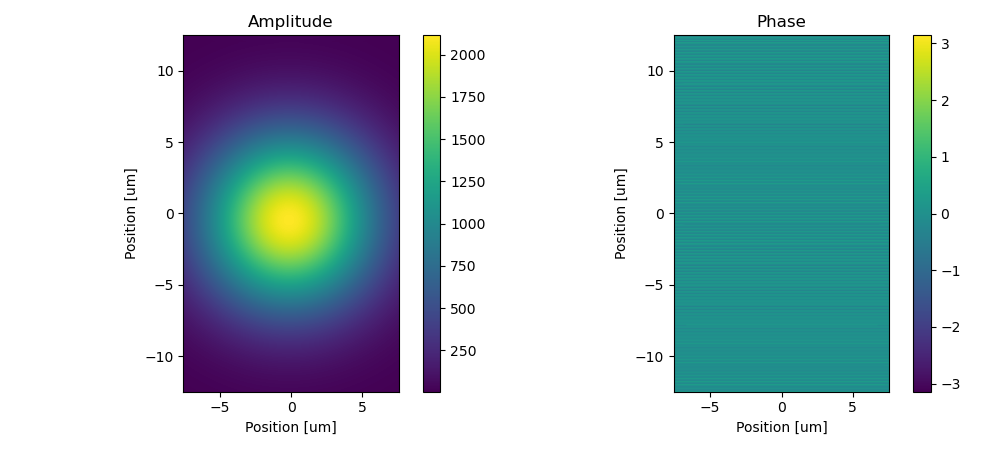

In [35]:
# Back propagation Batch
flag_plot = True

back_prop_size = wave_prop_size
back_prop_dist = dist_to_focal
back_prop_step = back_prop_dist   # [nm] 
back_prop_grid = wave_grid_step   # [nm]

x_ax = (np.arange(back_prop_size[0]) - int(back_prop_size[0]/2)) * back_prop_grid[0]
y_ax = (np.arange(back_prop_size[1]) - int(back_prop_size[1]/2)) * back_prop_grid[1]

N = int(np.abs(back_prop_dist / back_prop_step))
print(N)
wf_bp_list = []
for b in modlist:
    if N != 1: 
        wf_record = np.zeros((N, wave_prop_size[0], wave_prop_size[1])) * (1 + 1j)
#for b in wf_fc_list:
    wf_temp = b.copy()
    for ii in range(N): 
        print('Back propagating %d / %d' %(ii+1, N), end='\r')
        wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=back_prop_step, grid_size=back_prop_grid, 
                                              wave_len=1.2398 / photonE, pad_size=back_prop_size, flag_cropout=False)
        if N != 1: 
            wf_record[ii] = wf_temp
    print('Back propagating %d / %d' %(ii+1, N), end='\n' )
    wf_bp = wf_temp
    wf_bp_list.append(wf_bp)
if flag_plot:   # 1D plot of wavefront 
    temp = wf_bp
    lim_region = False
    plot_region = [-10, 10]
    
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    if lim_region: 
        plt.xlim(plot_region)
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    if lim_region: 
        plt.xlim(plot_region)
    plt.tight_layout()
    del temp, plot_region, lim_region
if flag_plot:   # 2D plot of wavefront 
    temp = wf_bp
    lim_region = False
    plot_region = [-10, 10, -10, 10]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('Position [um]'); plt.ylabel('Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('Position [um]'); plt.ylabel('Position [um]')
    plt.tight_layout()
    del temp, plot_region, lim_region
del wf_temp, x_ax, y_ax, flag_plot
if N != 1: 
    plot_region = [-60, 0, -30, 30]
    if True:   # 2D plot of wavefront 
        temp = np.abs(wf_record)
        lim_region = True

        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.log10(temp[:, :, int(np.shape(temp)[2]/2 + gau_cen_offset[1]/wave_grid_step[1])]).transpose(), origin='lower', 
                   extent=[ 0, back_prop_dist/1e4, 
                           -np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3, 
                            np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.colorbar(); plt.title('XZ slice at Y = %0.3f [um]' %(gau_cen_offset[1]/1e3))
        plt.ylabel('X [um]'); plt.xlabel('Z [x10 um]')
        plt.tight_layout()
        plt.subplot(122)
        plt.imshow(np.log10(temp[:, int(np.shape(temp)[1]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]).transpose(), origin='lower', 
                   extent=[ 0, back_prop_dist/1e4, 
                           -np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3, 
                            np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.colorbar(); plt.title('YZ slice at X = %0.3f [um]' %(gau_cen_offset[0]/1e3))
        plt.ylabel('Y [um]'); plt.xlabel('Z [x10 um]')
        plt.tight_layout()
        del temp, lim_region
    plt.close()
    del plot_region, wf_record

### Free propagation for sanity check

In [407]:
wf_in = wf_bp.copy()

In [812]:
# Simulation parameters 
print('wave_prop_size: ', wave_prop_size)
print('wave_prop_dist: %f [nm]' %wave_prop_dist)
print('wave_prop_step: %f [nm]' %wave_prop_step)
print('dist_to_focal: %f [nm]' %dist_to_focal)
print('wave_grid_step: [%f, %f] [nm]' %(tuple(wave_grid_step)))
farf_prop_size = [5001, 5001]
wave_len = 1.2398 / photonE   # [nm]

flag_mask_beam = False   # whether mask out the direct beam 
# Keep flag_mask_beam = False, otherwise normalization is not correct
flag_bin_result = False   # whether bin the diffraction pattern at farfield 
bin_size = [5, 5]   # size of binning 
flag_crop_result = False   # whether crop the diffraction pattern at farfield 
result_size = [2001,2001]   # size of cropped result 

wave_prop_size:  [1000, 1000]
wave_prop_dist: 200000.000000 [nm]
wave_prop_step: 100.000000 [nm]
dist_to_focal: -100000.000000 [nm]
wave_grid_step: [25.000000, 25.000000] [nm]


In [813]:
# Propagate in free space 
P = int(np.abs(wave_prop_dist) / wave_prop_step)
print('Started ' + strftime('%H:%M:%S', localtime()) )
if not np.array_equal(np.shape(wf_in), wave_prop_size):  
    wf_temp = Array_zeropad_2D(wf_in, AddTo=wave_prop_size)
else: 
    wf_temp = np.copy(wf_in)
wf_rec = np.zeros((P+1, wave_prop_size[0], wave_prop_size[1])).astype('complex128')
wf_rec[0] = wf_temp
for ii in range(P): 
    print('ii = %d / %d' %(ii+1, P), end='\r')
    wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=wave_prop_step, grid_size=wave_grid_step, 
                                          wave_len=wave_len, pad_size=wave_prop_size, flag_cropout=False)
    wf_rec[ii+1] = wf_temp
print('Finished ' + strftime('%H:%M:%S', localtime()) )
print(np.shape(wf_rec))
if True: 
    Save_tif(np.abs(wf_rec), 'wf_rec_freeprop_amp.tif', OverWrite=True)
    Save_tif(np.angle(wf_rec),  'wf_rec_freeprop_ph.tif',  OverWrite=True)
del wf_temp, wf_rec, P

Started 14:16:51
Finished 14:22:40
(2001, 1000, 1000)
>>>>>> Error! File already exists. 
>>>>>> Existing file is overwritten! 
>>>>>> Error! File already exists. 
>>>>>> Existing file is overwritten! 


In [814]:
wf_rec_amp = Read_tif('wf_rec_freeprop_amp.tif')
wf_rec_ph = Read_tif('wf_rec_freeprop_ph.tif')

In [815]:
print(np.shape(wf_rec_amp))
print(np.shape(wf_rec_ph))

(2001, 1000, 1000)
(2001, 1000, 1000)


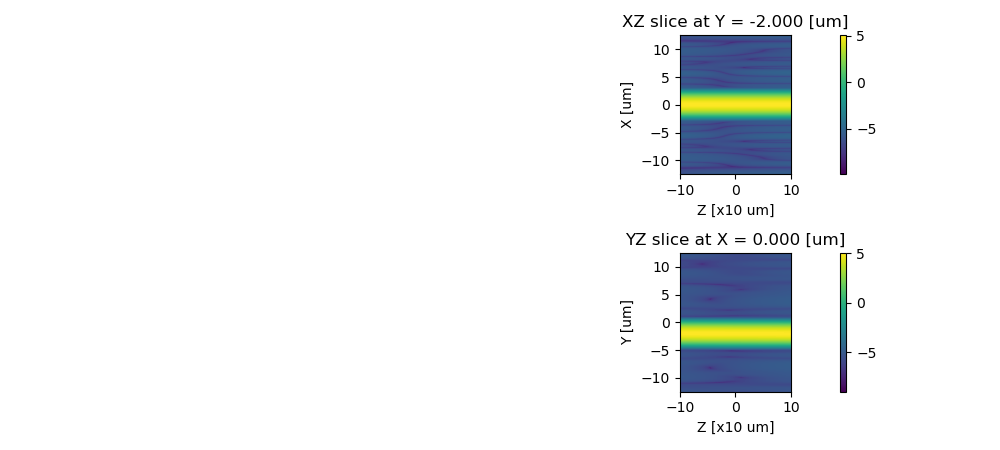

In [816]:
if True:   # 2D plot of wavefront 
    temp = wf_rec_amp
    lim_region = False
    plot_region = [-60, 60, -10, 10]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(211)
    plt.imshow(np.log10(temp[:, :, int(np.shape(temp)[2]/2 + gau_cen_offset[1]/wave_grid_step[1])]).transpose(), origin='lower', 
               extent=[-wave_prop_dist/2/1e4, wave_prop_dist/2/1e4, 
                       -np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3, 
                        np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.colorbar(); plt.title('XZ slice at Y = %0.3f [um]' %(gau_cen_offset[1]/1e3))
    plt.ylabel('X [um]'); plt.xlabel('Z [x10 um]')
    plt.tight_layout()
    plt.subplot(212)
    plt.imshow(np.log10(temp[:, int(np.shape(temp)[1]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]).transpose(), origin='lower', 
               extent=[-wave_prop_dist/2/1e4, wave_prop_dist/2/1e4, 
                       -np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3, 
                        np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.colorbar(); plt.title('YZ slice at X = %0.3f [um]' %(gau_cen_offset[0]/1e3))
    plt.ylabel('Y [um]'); plt.xlabel('Z [x10 um]')
    plt.tight_layout()
    del temp, plot_region, lim_region

## Create substrate

In [72]:
pixels = 40
control = pixels*2
division = 0.5
limit = int(control*division*0.5)
controllimit = limit

In [73]:
np.linspace(0,1000,1001)
limit

20

In [74]:
ratios = [0.75]
divisions = np.reciprocal(ratios)
limits = pixels*divisions*0.5
limits
divisions
limits

array([26.66666667])

In [75]:
half_top = control
start_top = pixels

In [76]:
start_top

40

In [77]:
t = np.arange(0,wave_prop_size[1])
m = np.array([1 if np.isin(math.floor(d)%int(pixels*1.5),range(0,start_top)) else 1 if np.isin(math.floor(d)%int(pixels*1.5),range(int(pixels*1.5) - start_top,int(pixels*1.5))) else 0 for d in t])
#m = np.array([1 if np.isin(math.floor(d)%int(control),range(0,int(controllimit))) else 1 if np.isin(math.floor(d)%int(control),range(int(control) - int(controllimit),int(control))) else 0 for d in t])
#m = np.array([1 if np.isin(math.floor(d)%int(pixels*1.5),range(0,half_top)) else 1 if np.isin(math.floor(d)%int(pixels*1.5),range(int(pixels*1.5) - half_top,int(pixels*1.5))) else 0 for d in t])
gap = np.array([1 if np.isin(math.floor(d)%100,range(1,81)) else 0 for d in t])
gap[240:264] = 700 #defect allowed
#m[570:580] = 520
#u = np.arange(0,500)
#t1 = np.tile(t,500)
#m1 = np.tile(m,500)
#substrate = np.array([t1,m1,u1]).T
#substrate
#fig = plt.figure()
#ax = fig.add_subplot(111, projection = '3d')
#test = ax.plot_trisurf(t1,u1,m1)
#plt.show()
#for i in range(len(u)):
#    for j in range(len(m)):
#        substrate.append([t[j],m[j],u[i]])
#substrate.reshape((1000,2,500))

In [78]:
setmat = []
for i in np.arange(0,len(limits)):
    setmat.append(np.array([1 if np.isin(math.floor(d)%pixels,range(0,int(limits[i]))) else 1 if np.isin(math.floor(d)%pixels,range(pixels - int(limits[i]),pixels)) else 0 for d in t]))

In [79]:
setmat

[array([1, 1, 1, ..., 1, 1, 1])]

In [80]:
mat3d = np.zeros((wave_prop_size[0],wave_prop_size[1]))
base = np.ones((50,wave_prop_size[0],wave_prop_size[1]))
start = np.zeros((50,wave_prop_size[0],wave_prop_size[1]))
end = np.zeros((50,wave_prop_size[0],wave_prop_size[1]))

In [75]:
base

array([[[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       ...,

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1.

In [44]:
for i in range(len(t)):
    if m[i] == 1:
        mat3d[:,t[i]] = 1
#    if gap[i] >0:
#        matb[:,t[i]] = 1
fin = np.broadcast_to(mat3d,(int(layers),wave_prop_size[0],wave_prop_size[1]))
print(fin)

[[[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]

 ...

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]]


In [363]:
#for i in range(len(t)):
#    if m[i] == 1:
#        mat3d[:,t[i]] = 1
fin = ()
intervals = 1
levels = (half_top - start_top)//intervals
for j in np.arange(0,len(limits)):
    for w in np.arange(half_top/2,(start_top/2)-1,-1):
        print(w)
       # offset = w%intervals
        for i in np.arange(0,int(layers/((half_top-start_top))+1)):
            m = np.array([1 if np.isin(math.floor(d)%int(pixels*1.5),range(0,int(w))) else 1 if np.isin(math.floor(d)%int(pixels*1.5),range(int(pixels*1.5) - int(w),int(pixels*1.5))) else 0 for d in t])
            mat3d = np.zeros((wave_prop_size[0],wave_prop_size[1]))
            for b in range(len(t)):
                if m[b] == 1:
                    mat3d[:,t[b]] = 1
            fin = fin + (mat3d,)
#    if gap[i] >0:
#        matb[:,t[i]] = 1
#fin = np.broadcast_to(mat3d,(50,wave_prop_size[0],wave_prop_size[1]))
#fin.shape()

6.0
5.0
4.0
3.0


In [35]:
levels = np.arange(0,1,1/8)

In [36]:
coords = levels*(half_top - start_top)

In [1146]:
mat3d
int(layers)
int(layers/((half_top-start_top)))

2

In [59]:
layers
half_top - start_top

6

In [49]:
mat3d.T

array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

In [81]:
#for i in range(len(t)):
#    if m[i] == 1:
#        mat3d[:,t[i]] = 1
fin = ()
intervals = 5
levels = 200//intervals
for j in np.arange(0,len(limits)):
    increment = 0
    for w in np.arange(start_top/2,(half_top/2)+1,1):
        print(w)
        for i in np.arange(0,int(layers/((0.5*(half_top-start_top))+1))):
            m = np.array([1 if np.isin(math.floor(d)%int(control*2),range(0,int(w))) else 1 if np.isin(math.floor(d)%int(control*2),range(int(control*2) - int(w),int(control*2))) else 0 for d in t])
            mat3d = np.zeros((wave_prop_size[0],wave_prop_size[1]))
            for b in range(len(t)):
                if m[b] == 1:
                    mat3d[:,t[b]] = 1
            fin = fin + (mat3d,)
#    if gap[i] >0:
#        matb[:,t[i]] = 1
#fin = np.broadcast_to(mat3d,(50,wave_prop_size[0],wave_prop_size[1]))
#fin.shape()

20.0
21.0
22.0
23.0
24.0
25.0
26.0
27.0
28.0
29.0
30.0
31.0
32.0
33.0
34.0
35.0
36.0
37.0
38.0
39.0
40.0


In [449]:
for i in range(len(t)):
    if gap[i] > 1:
        for d in range(gap[i],gap[i] + 24,1):
            mat3d[t[i],d] = 0
#    if gap[i] >0:
#        for d in range(gap[i],500,1):
#            matb[d,t[i]] = 1

In [79]:
mat3d

array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

In [82]:
#test = mat3d
#testb = matb
#testsub = matsub
#sub = np.tile(testb,(10,1,1))
#substrate = np.tile(test,(345,1,1))
stacks = ()
#for i in range(100):
#    stacks = stacks + (testb,)
#for i in range(50):
#    stacks = stacks + (test,)
#for i in range(10):
##    stacks = stacks + (testsub,)
#for i in range(325):
#    stacks = stacks + (testb,)
substratea = np.concatenate((start,fin,base,end),axis = 0)

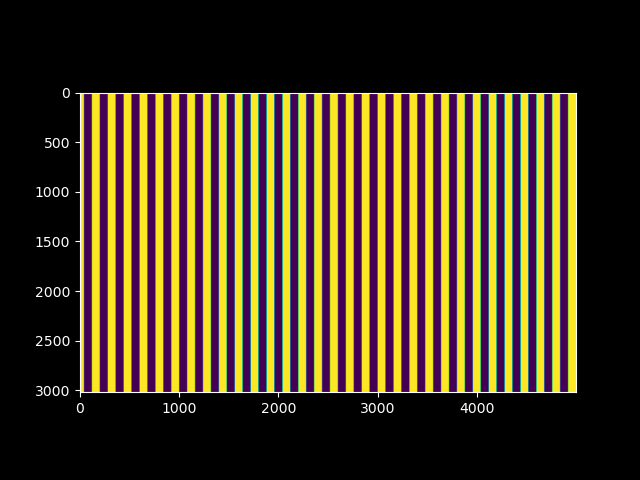

In [83]:
plt.figure()
plt.imshow(mat3d)
plt.show()

In [84]:
substrate = np.transpose(substratea,(1,2,0))

In [85]:
np.shape(substrate)

(3020, 5000, 171)

In [323]:
substrate = np.zeros((190, wave_prop_size[0], wave_prop_size[1]))
print(np.shape(substrate))

(190, 100, 1000)


In [324]:
substrate[:, :, :int(wave_prop_size[1]/2 + gau_cen_offset[1]/wave_grid_step[1])] = 1
# substrate[:, :, int(wave_prop_size[1]/2 + gau_cen_offset[1]/wave_grid_step[1]):] = 1

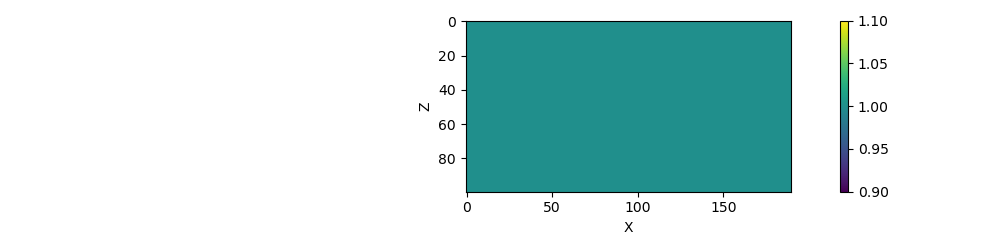

In [322]:
if True:   # 2D plot of substrate cross-section 
    #Note: origin by default keeps correct axis. 'lower' flips it!
    plt.figure(figsize=(10, 2.5))
    plt.imshow(substrate[:,:,250].transpose()
               #, origin='lower', 
               #substrate[:, int(np.shape(substrate)[1]/2), :].transpose(), origin='lower', 
               # extent=[-wave_prop_dist/1e3, wave_prop_dist/1e3, 
               #         -wave_prop_size[1]/2 * wave_grid_step[1] / 1e3, 
               #          wave_prop_size[1]/2 * wave_grid_step[1] / 1e3]
              )
    # plt.ylim([-10, 10])
    
    plt.xlabel('X')
    plt.ylabel('Z')
    plt.colorbar()
    plt.tight_layout()

## Create surface structure

In [82]:
# Sample modification 
file_name = 'square_dot'
if False: # Read sample from bmp 
    im = pim.open(file_name + '.bmp')
    image = np.asarray(im)
    if True: 
        plt.figure()
        plt.imshow(image); plt.colorbar()
    if True: 
        Save_tif(image!=255, file_name + '.tif', OverWrite=False)
if False: # Read sample from tif 
    image = Read_tif(file_name + '.tif')
    print(np.shape(image))

    image_pad = Array_size_adjust(image, adj_to=[np.shape(substrate)[0], 
                                                 np.shape(substrate)[1]])
    print(np.shape(image_pad))
    if False: # Plot image 
        plt.figure()
        plt.imshow(image_pad); 
        plt.colorbar(); plt.tight_layout()
if False: # Gaussian function for edge softening 
    gau_size = [31, 31]
    gau_width = [1.0, 1.0]
    x_ax = (np.arange(gau_size[0]) - int(gau_size[0]/2))
    y_ax = (np.arange(gau_size[1]) - int(gau_size[1]/2))
    gau_fun = Gaussian_2D(x_ax, y_ax, 1, 0, 0, gau_width[0], 0, gau_width[1])
    gau_fun = gau_fun / np.sum(gau_fun.reshape(-1))
    if False: 
        plt.figure(figsize=(4.5, 4.5))
        plt.imshow(gau_fun)
        plt.colorbar(); plt.tight_layout()
if False: # soften the edges 
    if True: 
        print('Started ' + strftime('%H:%M:%S', localtime()) )
        image_soft = np.zeros_like(image_pad)
        image_soft = sp.signal.convolve2d(image_pad, gau_fun, mode='same', boundary='fill', fillvalue=0)
        print('Finished ' + strftime('%H:%M:%S', localtime()) )
        print(np.shape(image_soft))
    if True: # Plot image 
        plt.figure()
        plt.imshow(image_soft); 
        plt.colorbar()
    if False: 
        Save_tif(image_soft.astype('float16'), file_name + '_softedge.tif', OverWrite=True)
if False: # load existing image 
    # image_soft = Read_tif(file_name + '_softedge.tif')
    image_soft = Array_zeropad_2D(Read_tif(file_name + '_softedge.tif'), AddTo=np.shape(substrate)[:2])
    if False: # Plot image 
        plt.figure()
        plt.imshow(image_soft); 
        plt.colorbar()

In [ ]:
surf_str = np.repeat(image_soft[:, :, np.newaxis], 5, axis=2) * 2
print(np.shape(surf_str))

In [ ]:
pillar_size = [590000, 10000, 6]   # [nm], [Z, X, Y]
flag_array = False
pillar_rep = [5, 7]   # repetition of the pillar in [Z, X]
pillar_sep = [35000, 1350]   # seperation of the pillars in [Z, X]

surf_str = np.zeros(np.shape(substrate)[:2])
print(np.shape(surf_str))
pillar_pix = np.asarray([pillar_size[0] / wave_prop_step, pillar_size[1]/wave_grid_step[0], pillar_size[2]/wave_grid_step[1]]).astype('int')
print(pillar_pix)
surf_str[int(np.shape(substrate)[0]/2 - pillar_pix[0]/2):int(np.shape(substrate)[0]/2 + pillar_pix[0]/2), 
         int(np.shape(substrate)[1]/2 - pillar_pix[1]/2):int(np.shape(substrate)[1]/2 + pillar_pix[1]/2)] = 1
if flag_array: 
    pillar_sep_pix = np.asarray([pillar_sep[0] / wave_prop_step, pillar_sep[1]/wave_grid_step[0]]).astype('int')
    print(pillar_sep_pix)
    for i in range(pillar_rep[0]): 
        for j in range(pillar_rep[1]): 
            print('')
surf_str = np.repeat(surf_str[:, :, np.newaxis], pillar_pix[2], axis=2) * 2

## Create the sample

In [46]:
a,b = np.mgrid[0:5,0:5]
radius = (a**2) + (b**2)
circle = (radius < 5)
circle

array([[ True,  True,  True, False, False],
       [ True,  True, False, False, False],
       [ True, False, False, False, False],
       [False, False, False, False, False],
       [False, False, False, False, False]])

In [86]:
sample = substrate
if False: 
    sample [:, :, int(wave_prop_size[1]/2 + gau_cen_offset[1]/wave_grid_step[1]):
                 (int(wave_prop_size[1]/2 + gau_cen_offset[1]/wave_grid_step[1]) + np.shape(surf_str)[2] )]= surf_str

In [87]:
np.shape(sample)

(3020, 5000, 171)

[Text(0.0, 0, '0'), Text(50.0, 0, '50'), Text(100.0, 0, '100'), Text(150.0, 0, '150'), Text(200.0, 0, '200')]
[Text(0, 0.0, '0'), Text(0, 1000.0, '1000'), Text(0, 2000.0, '2000'), Text(0, 3000.0, '3000'), Text(0, 4000.0, '4000'), Text(0, 5000.0, '5000')]


/tmp/ipykernel_2372967/811592425.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labx)
/tmp/ipykernel_2372967/811592425.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(laby)
/tmp/ipykernel_2372967/811592425.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(labx)
/tmp/ipykernel_2372967/811592425.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_yticklabels(laby)
/tmp/ipykernel_2372967/811592425.py:65: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax3.set_xticklabels(labx)
/tmp/ipykernel_2372967

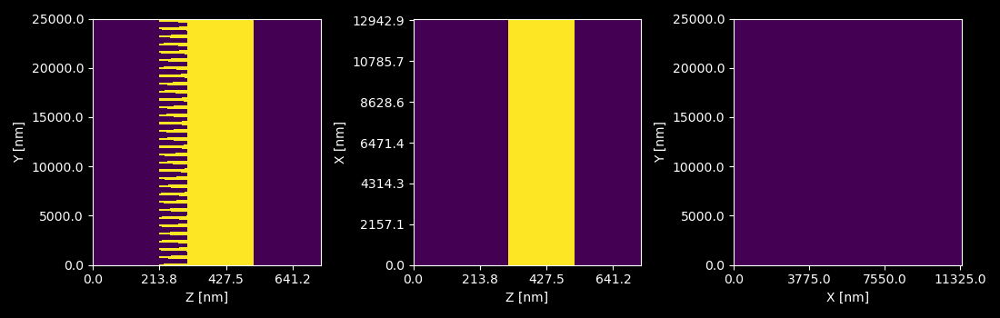

In [88]:
y_plot_offset = 0
cross = []
if True: 
    plt.figure(figsize=(11, 3.5))
    
    ax = plt.subplot(131)
    idx = int(np.shape(sample)[0]/2)
    plt.pcolormesh(sample[idx, :, :]#.transpose(), origin='lower', 
               # extent=[-wave_prop_dist/2/1e5, wave_prop_dist/2/1e5, 
               #         -wave_prop_size[1]/2 * wave_grid_step[1] / 1e3, 
               #          wave_prop_size[1]/2 * wave_grid_step[1] / 1e3]
              )
    # plt.ylim([-5, 5])
    plt.xlabel('Z [nm]')
    plt.ylabel('Y [nm]')
    xlabs = ax.get_xticklabels()
    ylabs = ax.get_yticklabels()
    print(xlabs)
    print(ylabs)
    labx = np.round(np.linspace(0, (sample.shape[2])*wave_grid_step[0],len(xlabs)),1)
    laby = np.round(np.linspace(0, (sample.shape[1])*wave_grid_step[1],len(ylabs)),1)
    ax.set_xticklabels(labx)
    ax.set_yticklabels(laby)

    # plt.tight_layout()
    
    ax2 = plt.subplot(132)
    idx = int(np.shape(sample)[1]/2 + gau_cen_offset[1]/wave_grid_step[1] + y_plot_offset)
    plt.pcolormesh(sample[:, idx, :]#.transpose()
               #, origin='lower', 
               #extent=[-wave_prop_dist/2/1e5, wave_prop_dist/2/1e5, 
               #        -wave_prop_size[0]/2 * wave_grid_step[0] / 1e3, 
               #         wave_prop_size[0]/2 * wave_grid_step[0] / 1e3]
              )
    # plt.ylim([-5, 5])
    plt.xlabel('Z [nm]')
    plt.ylabel('X [nm]')
    xlabs = ax2.get_xticklabels()
    ylabs = ax2.get_yticklabels()
    labx = np.round(np.linspace(0, (sample.shape[2])*wave_grid_step[0],len(xlabs)),1)
    laby = np.round(np.linspace(0, (sample.shape[0])*wave_grid_step[1],len(ylabs)),1)
    ax2.set_xticklabels(labx)
    ax2.set_yticklabels(laby)

    # plt.tight_layout()
    
    ax3 = plt.subplot(133)
    idx = int(np.shape(sample)[2]/2)
    plt.pcolormesh(sample[:, :, idx-10].transpose()
              # , origin='lower', 
              # extent=[-wave_prop_size[0]/2 * wave_grid_step[0] / 1e3, 
              #          wave_prop_size[0]/2 * wave_grid_step[0] / 1e3, 
              #         -wave_prop_size[1]/2 * wave_grid_step[1] / 1e3, 
              #          wave_prop_size[1]/2 * wave_grid_step[1] / 1e3]
              )
    cross = sample[:,:,idx]
    # plt.xlim([-5, 5])
    # plt.ylim([-5, 5])
    plt.xlabel('X [nm]')
    plt.ylabel('Y [nm]')
    xlabs = ax3.get_xticklabels()
    ylabs = ax3.get_yticklabels()
    labx = np.round(np.linspace(0, (sample.shape[0])*wave_grid_step[0],len(xlabs)),1)
    laby = np.round(np.linspace(0, (sample.shape[1])*wave_grid_step[1],len(ylabs)),1)
    ax3.set_xticklabels(labx)
    ax3.set_yticklabels(laby)

    plt.tight_layout()
del y_plot_offset

In [89]:
sample = sample.transpose((2,0,1))

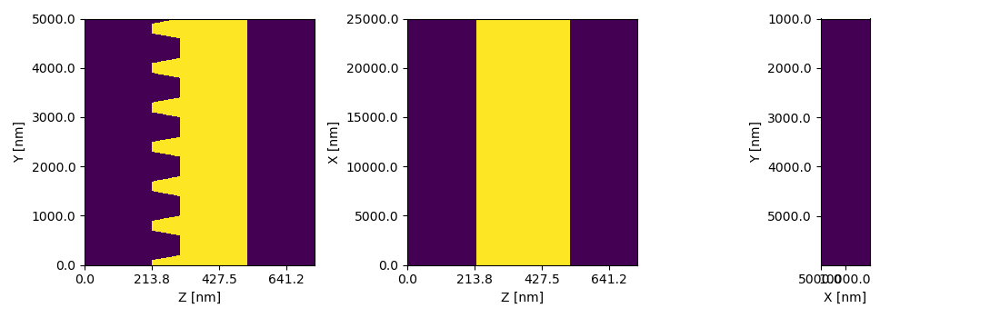

In [247]:
np.where(cross == 1)
plt.imshow(cross)
plt.show()

(5000, 5000)


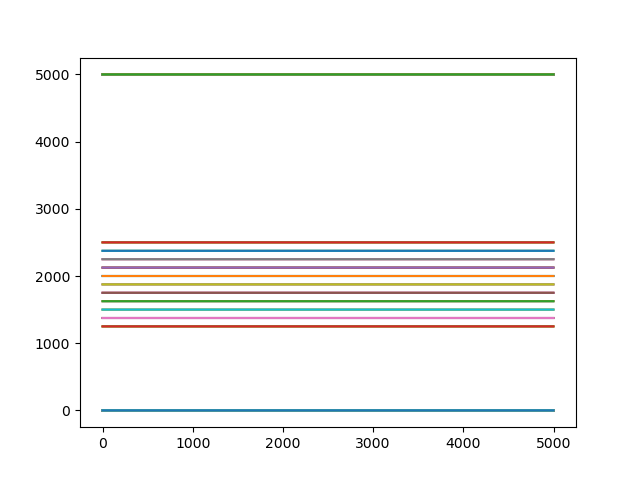

In [81]:
print(cross.shape)
crossft = np.fft.fftn(sum(sample))
ax10 = plt.figure().add_subplot()
plt.plot(((np.fft.fftshift(sum(sample.T)))))
plt.show()

In [57]:
crossft

array([[ 1.25000000e+07   +0.j        , -7.89776212e-01+1256.96771462j,
        -3.16160173e+00+2515.92138888j, ...,
        -7.12298646e+00-3778.85720861j, -3.16160173e+00-2515.92138888j,
        -7.89776212e-01-1256.96771462j],
       [ 0.00000000e+00   +0.j        ,  0.00000000e+00   +0.j        ,
         0.00000000e+00   +0.j        , ...,
         0.00000000e+00   +0.j        ,  0.00000000e+00   +0.j        ,
         0.00000000e+00   +0.j        ],
       [ 0.00000000e+00   +0.j        ,  0.00000000e+00   +0.j        ,
         0.00000000e+00   +0.j        , ...,
         0.00000000e+00   +0.j        ,  0.00000000e+00   +0.j        ,
         0.00000000e+00   +0.j        ],
       ...,
       [ 0.00000000e+00   +0.j        ,  0.00000000e+00   +0.j        ,
         0.00000000e+00   +0.j        , ...,
         0.00000000e+00   +0.j        ,  0.00000000e+00   +0.j        ,
         0.00000000e+00   +0.j        ],
       [ 0.00000000e+00   +0.j        ,  0.00000000e+00   +0.j      

## Wave propagation

In [1242]:
# Simulation parameters 
wf_in = wf_bp.copy()
flag_subonly = False

print('wave_prop_size: ', wave_prop_size)
print('wave_prop_dist: %f [nm]' %wave_prop_dist)
print('wave_prop_step: %f [nm]' %wave_prop_step)
print('dist_to_focal: %f [nm]' %dist_to_focal)
print('wave_grid_step: [%f, %f] [nm]' %(tuple(wave_grid_step)))
''' ---------- Ignore for now ---------- '''
farf_prop_size = [3000, 3000]
wave_len = 1.2398 / photonE   # [nm]

flag_mask_beam = False   # whether mask out the direct beam 
# Keep flag_mask_beam = False, otherwise normalization is not correct
flag_bin_result = False   # whether bin the diffraction pattern at farfield 
bin_size = [5, 5]   # size of binning 
flag_crop_result = False   # whether crop the diffraction pattern at farfield 
result_size = [2001,2001]   # size of cropped result
''' ---------- Ignore for now ---------- '''

wave_prop_size:  [3000, 3000]
wave_prop_dist: 200000.000000 [nm]
wave_prop_step: 5.000000 [nm]
dist_to_focal: -100000.000000 [nm]
wave_grid_step: [10.000000, 10.000000] [nm]


' ---------- Ignore for now ---------- '

In [90]:
# Simulation parameters 
wf_in_list = wf_bp_list.copy()
flag_subonly = False

print('wave_prop_size: ', wave_prop_size)
print('wave_prop_dist: %f [nm]' %wave_prop_dist)
print('wave_prop_step: %f [nm]' %wave_prop_step)
print('dist_to_focal: %f [nm]' %dist_to_focal)
print('wave_grid_step: [%f, %f] [nm]' %(tuple(wave_grid_step)))
''' ---------- Ignore for now ---------- '''
farf_prop_size = [10000, 10000]
wave_len = 1.2398 / photonE   # [nm]

flag_mask_beam = False   # whether mask out the direct beam 
# Keep flag_mask_beam = False, otherwise normalization is not correct
flag_bin_result = False   # whether bin the diffraction pattern at farfield 
bin_size = [5, 5]   # size of binning 
flag_crop_result = False   # whether crop the diffraction pattern at farfield 
result_size = [5000,5000]   # size of cropped result
''' ---------- Ignore for now ---------- '''

wave_prop_size:  [3020, 5000]
wave_prop_dist: 200000.000000 [nm]
wave_prop_step: 5.000000 [nm]
dist_to_focal: -100000.000000 [nm]
wave_grid_step: [5.000000, 5.000000] [nm]


' ---------- Ignore for now ---------- '

In [91]:
# Propagation parameters 
print('Photon energy is %.3f keV ' %photonE)
element_Z = np.asarray([14])   # 13 - Al, 14 - Si, 24 - Cr, 29 - Cu, 74 - W, 79 - Au
print('sample array shape: ', np.shape(sample))
print('wf_in array shape: ', np.shape(wf_in_list[0]))

Photon energy is 17.200 keV 
sample array shape:  (171, 3020, 5000)
wf_in array shape:  (3020, 5000)


In [ ]:
# Propagation - multiple elements 
rec_ratio = 20 #Save 1 every 20 images
flag_lowthres = False

wave_vec = 2*np.pi/wave_len   # [nm-1]
density = np.zeros(np.shape(element_Z))
delta = np.zeros(np.shape(element_Z))
beta  = np.zeros(np.shape(element_Z))

for i in range(len(element_Z)): 
    if True: # Get refractive index from database
        density[i] = xb.ElementDensity(element_Z[i])   # [g/cm3]
        # Index of Refraction = (1-delta) - i(beta)
        delta[i] = 1 - xb.Refractive_Index_Re(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
        beta[i]  = xb.Refractive_Index_Im(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
    else: # manually define refractive index 
        density[i] = 3.0
        delta[i] = -0.5
        beta[i] = 0.0
print('Started ' + strftime('%H:%M:%S', localtime()) )
P = np.shape(sample)[0]
if not np.array_equal(np.shape(wf_in), wave_prop_size):  
    wf_temp = Array_zeropad_2D(wf_in, AddTo=wave_prop_size)
else: 
    wf_temp = np.copy(wf_in)
wf_rec = np.zeros((int(P/rec_ratio)+1, wave_prop_size[0], wave_prop_size[1])).astype('complex128')
wf_rec[0] = wf_temp
# Actual propagation part
for ii in range(P): # loop for slices
    print('Propagating %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()), end='\r')
    sample_temp = Array_zeropad_2D(sample[ii, :,:], AddTo=wave_prop_size)
    # photon-matter interaction
    for i in range(len(element_Z)): # loop elements 
        sample_elem = (sample_temp == (i+1))
        # attenuation 
        sample_abs = np.exp(- wave_vec * beta[i] * sample_elem * wave_prop_step)
        wf_temp *= sample_abs
        # phase delay 
        sample_phd = np.exp(-1j * wave_vec * delta[i] * sample_elem * wave_prop_step)
        wf_temp *= sample_phd
        del sample_elem, sample_abs, sample_phd
    # wave propagation in free space
    wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=wave_prop_step, grid_size=wave_grid_step, 
                                          wave_len=wave_len, pad_size=wave_prop_size, lowthres=1.0, 
                                          flag_cropout=False, flag_norm=False, flag_lowthres=flag_lowthres)
    if np.remainder(ii+1, rec_ratio) == 0: 
        wf_rec[int((ii+1)/rec_ratio)] = wf_temp
print('Finished    %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()))
wf_rec = wf_rec.transpose(1,2,0)
print(np.shape(wf_rec))
if True: 
    if flag_subonly: 
        Save_tif(np.abs(wf_rec), 'wf_rec_subonly_amp.tif', OverWrite=True)
        Save_tif(np.angle(wf_rec), 'wf_rec_subonly_ph.tif', OverWrite=True)
    else: 
        Save_tif(np.abs(wf_rec), 'wf_rec_pillars_amp.tif', OverWrite=True)
        Save_tif(np.angle(wf_rec), 'wf_rec_pillars_ph.tif', OverWrite=True)
del wf_temp, P, sample_temp
# del wf_rec

Started 02:28:47
Propagating 27 / 160   02:29:14

In [106]:
P = np.shape(sample)[0]

In [92]:
# Propagation - multiple elements (Batch)
rec_ratio = 20 #Save 1 every 20 images
flag_lowthres = False
count = 0
wave_vec = 2*np.pi/wave_len   # [nm-1]
density = np.zeros(np.shape(element_Z))
delta = np.zeros(np.shape(element_Z))
beta  = np.zeros(np.shape(element_Z))

for i in range(len(element_Z)): 
    if True: # Get refractive index from database
        density[i] = xb.ElementDensity(element_Z[i])   # [g/cm3]
        # Index of Refraction = (1-delta) - i(beta)
        delta[i] = 1 - xb.Refractive_Index_Re(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
        beta[i]  = xb.Refractive_Index_Im(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
    else: # manually define refractive index 
        density[i] = 3.0
        delta[i] = -0.5
        beta[i] = 0.0
print('Started ' + strftime('%H:%M:%S', localtime()) )
P = np.shape(sample)[0]
wf_rec_list = []

qtif = []
angtif = []
for wf in wf_in_list:
    P = np.shape(sample)[0]
    if not np.array_equal(np.shape(wf), wave_prop_size):  
        wf_temp = Array_zeropad_2D(wf, AddTo=wave_prop_size)
    else: 
        wf_temp = np.copy(wf)
    wf_rec = np.zeros((int(P/rec_ratio)+1, wave_prop_size[0], wave_prop_size[1])).astype('complex128')
    wf_rec[0] = wf_temp
    # Actual propagation part
    for ii in range(P): # loop for slices
        print('Propagating %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()), end='\r')
        sample_temp = Array_zeropad_2D(sample[ii, :,:], AddTo=wave_prop_size)
        # photon-matter interaction
        for i in range(len(element_Z)): # loop elements 
            sample_elem = (sample_temp == (i+1))
            # attenuation 
            sample_abs = np.exp(- wave_vec * beta[i] * sample_elem * wave_prop_step)
            wf_temp *= sample_abs
            # phase delay 
            sample_phd = np.exp(-1j * wave_vec * delta[i] * sample_elem * wave_prop_step)
            wf_temp *= sample_phd
            del sample_elem, sample_abs, sample_phd
        # wave propagation in free space
        wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=wave_prop_step, grid_size=wave_grid_step, 
                                              wave_len=wave_len, pad_size=wave_prop_size, lowthres=1.0, 
                                              flag_cropout=False, flag_norm=False, flag_lowthres=flag_lowthres)
        if np.remainder(ii+1, rec_ratio) == 0: 
            wf_rec[int((ii+1)/rec_ratio)] = wf_temp
    print('Finished    %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()))
    wf_rec = wf_rec.transpose(1,2,0)
    wf_rec_list.append(wf_rec)
    print(np.shape(wf_rec))
    if True: 
        if flag_subonly: 
            Save_tif(np.abs(wf_rec), 'wf_rec_subonly_amp.tif', OverWrite=True)
            Save_tif(np.angle(wf_rec), 'wf_rec_subonly_ph.tif', OverWrite=True)
        else:
            ampname = 'wf_rec_pillars_amp' + str(count) +'.tif'
            qtif.append(np.abs(wf_rec))
            angname = 'wf_rec_pillars_ph' + str(count) + '.tif'
            angtif.append(np.angle(wf_rec))
            #Save_tif(np.abs(wf_rec), ampname, OverWrite=True)
            #Save_tif(np.angle(wf_rec), angname, OverWrite=True)
    del wf_temp, P, sample_temp
    count += 1
# del wf_rec

Started 13:13:01
Finished    171 / 171   13:23:28
(3020, 5000, 9)
Finished    171 / 171   13:33:55
(3020, 5000, 9)
Finished    171 / 171   13:44:22
(3020, 5000, 9)
Finished    171 / 171   13:54:49
(3020, 5000, 9)
Finished    171 / 171   14:05:15
(3020, 5000, 9)
Finished    171 / 171   14:15:41
(3020, 5000, 9)
Finished    171 / 171   14:26:07
(3020, 5000, 9)
Finished    171 / 171   14:36:32
(3020, 5000, 9)
Finished    171 / 171   14:46:58
(3020, 5000, 9)


In [93]:
# Propagation - multiple elements (Batch) Tilting from sample
rec_ratio = 20 #Save 1 every 20 images
flag_lowthres = False
count = 0
wave_vec = 2*np.pi/wave_len   # [nm-1]
density = np.zeros(np.shape(element_Z))
delta = np.zeros(np.shape(element_Z))
beta  = np.zeros(np.shape(element_Z))

for i in range(len(element_Z)): 
    if True: # Get refractive index from database
        density[i] = xb.ElementDensity(element_Z[i])   # [g/cm3]
        # Index of Refraction = (1-delta) - i(beta)
        delta[i] = 1 - xb.Refractive_Index_Re(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
        beta[i]  = xb.Refractive_Index_Im(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
    else: # manually define refractive index 
        density[i] = 3.0
        delta[i] = -0.5
        beta[i] = 0.0
print('Started ' + strftime('%H:%M:%S', localtime()) )
P = np.shape(sample)[0]
wf_rec_list_sample = []

qtif_sample = []
angtif_sample = []
for wf in wf_rec_list:
    P = np.shape(sample)[0]
    if not np.array_equal(np.shape(wf[:,:,-1]), wave_prop_size):  
        wf_temp = Array_zeropad_2D(wf[:,:,-1], AddTo=wave_prop_size)
    else: 
        wf_temp = np.copy(wf[:,:,-1])
    wf_rec = np.zeros((int(P/rec_ratio)+1, wave_prop_size[0], wave_prop_size[1])).astype('complex128')
    wf_rec[0] = wf_temp
    # Actual propagation part
    for ii in range(P): # loop for slices
        print('Propagating %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()), end='\r')
        sample_temp = Array_zeropad_2D(sample[ii, :,:], AddTo=wave_prop_size)
        # photon-matter interaction
        for i in range(len(element_Z)): # loop elements 
            sample_elem = (sample_temp == (i+1))
            # attenuation 
            sample_abs = np.exp(- wave_vec * beta[i] * sample_elem * wave_prop_step)
            wf_temp *= sample_abs
            # phase delay 
            sample_phd = np.exp(-1j * wave_vec * delta[i] * sample_elem * wave_prop_step)
            wf_temp *= sample_phd
            del sample_elem, sample_abs, sample_phd
        # wave propagation in free space
        wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=wave_prop_step, grid_size=wave_grid_step, 
                                              wave_len=wave_len, pad_size=wave_prop_size, lowthres=1.0, 
                                              flag_cropout=False, flag_norm=False, flag_lowthres=flag_lowthres)
        if np.remainder(ii+1, rec_ratio) == 0: 
            wf_rec[int((ii+1)/rec_ratio)] = wf_temp
    print('Finished    %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()))
    wf_rec = wf_rec.transpose(1,2,0)
    wf_rec_list_sample.append(wf_rec)
    print(np.shape(wf_rec))
    if True: 
        if flag_subonly: 
            Save_tif(np.abs(wf_rec), 'wf_rec_subonly_amp.tif', OverWrite=True)
            Save_tif(np.angle(wf_rec), 'wf_rec_subonly_ph.tif', OverWrite=True)
        else:
            ampname = 'wf_rec_pillars_amp' + str(count) +'.tif'
            qtif_sample.append(np.abs(wf_rec))
            angname = 'wf_rec_pillars_ph' + str(count) + '.tif'
            angtif_sample.append(np.angle(wf_rec))
            #Save_tif(np.abs(wf_rec), ampname, OverWrite=True)
            #Save_tif(np.angle(wf_rec), angname, OverWrite=True)
    del wf_temp, P, sample_temp
    count += 1
# del wf_rec

Started 14:46:59
Finished    171 / 171   14:57:23
(3020, 5000, 9)
Finished    171 / 171   15:07:52
(3020, 5000, 9)
Finished    171 / 171   15:18:12
(3020, 5000, 9)
Finished    171 / 171   15:28:41
(3020, 5000, 9)
Finished    171 / 171   15:39:02
(3020, 5000, 9)
Finished    171 / 171   15:49:23
(3020, 5000, 9)
Finished    171 / 171   15:59:44
(3020, 5000, 9)
Finished    171 / 171   16:10:12
(3020, 5000, 9)
Finished    171 / 171   16:20:48
(3020, 5000, 9)


In [60]:
# Propagation - multiple elements (Batch) Tilting based on ramping
rec_ratio = 20 #Save 1 every 20 images
flag_lowthres = False
count = 0
wave_vec = 2*np.pi/wave_len   # [nm-1]
density = np.zeros(np.shape(element_Z))
delta = np.zeros(np.shape(element_Z))
beta  = np.zeros(np.shape(element_Z))

for i in range(len(element_Z)): 
    if True: # Get refractive index from database
        density[i] = xb.ElementDensity(element_Z[i])   # [g/cm3]
        # Index of Refraction = (1-delta) - i(beta)
        delta[i] = 1 - xb.Refractive_Index_Re(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
        beta[i]  = xb.Refractive_Index_Im(xb.AtomicNumberToSymbol(element_Z[i]), photonE, density[i])
    else: # manually define refractive index 
        density[i] = 3.0
        delta[i] = -0.5
        beta[i] = 0.0
print('Started ' + strftime('%H:%M:%S', localtime()) )
P = np.shape(sample)[0]
wf_rec_list_tilt = []

qtif_tilt = []
angtif_tilt = []
for wf in wf_fc_out:
    P = np.shape(sample)[0]
    if not np.array_equal(np.shape(wf), wave_prop_size):  
        wf_temp = Array_zeropad_2D(wf, AddTo=wave_prop_size)
    else: 
        wf_temp = np.copy(wf)
    wf_rec = np.zeros((int(P/rec_ratio)+1, wave_prop_size[0], wave_prop_size[1])).astype('complex128')
    wf_rec[0] = wf_temp
    # Actual propagation part
    for ii in range(P): # loop for slices
        print('Propagating %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()), end='\r')
        sample_temp = Array_zeropad_2D(sample[ii, :,:], AddTo=wave_prop_size)
        # photon-matter interaction
        #for i in range(len(element_Z)): # loop elements 
        #    sample_elem = (sample_temp == (i+1))
        #    # attenuation 
        #    sample_abs = np.exp(- wave_vec * beta[i] * sample_elem * wave_prop_step)
        #    wf_temp *= sample_abs
        #    # phase delay 
        #    sample_phd = np.exp(-1j * wave_vec * delta[i] * sample_elem * wave_prop_step)
        #    wf_temp *= sample_phd
        #    del sample_elem, sample_abs, sample_phd
        # wave propagation in free space
        wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=wave_prop_step, grid_size=wave_grid_step, 
                                              wave_len=wave_len, pad_size=wave_prop_size, lowthres=1.0, 
                                              flag_cropout=False, flag_norm=False, flag_lowthres=flag_lowthres)
        if np.remainder(ii+1, rec_ratio) == 0: 
            wf_rec[int((ii+1)/rec_ratio)] = wf_temp
    print('Finished    %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()))
    wf_rec = wf_rec.transpose(1,2,0)
    wf_rec_list_tilt.append(wf_rec)
    print(np.shape(wf_rec))
    if True: 
        if flag_subonly: 
            Save_tif(np.abs(wf_rec), 'wf_rec_subonly_amp.tif', OverWrite=True)
            Save_tif(np.angle(wf_rec), 'wf_rec_subonly_ph.tif', OverWrite=True)
        else:
            ampname = 'wf_rec_pillars_amp' + str(count) +'.tif'
            qtif_tilt.append(np.abs(wf_rec))
            angname = 'wf_rec_pillars_ph' + str(count) + '.tif'
            angtif_tilt.append(np.angle(wf_rec))
            #Save_tif(np.abs(wf_rec), ampname, OverWrite=True)
            #Save_tif(np.angle(wf_rec), angname, OverWrite=True)
    del wf_temp, P, sample_temp
    count += 1
# del wf_rec

Started 09:42:28
Finished    190 / 190   09:52:29
(3020, 5000, 10)
Finished    190 / 190   10:02:29
(3020, 5000, 10)
Finished    190 / 190   10:12:29
(3020, 5000, 10)
Finished    190 / 190   10:22:30
(3020, 5000, 10)
Finished    190 / 190   10:32:37
(3020, 5000, 10)
Finished    190 / 190   10:42:45
(3020, 5000, 10)
Propagating 161 / 190   10:51:20

KeyboardInterrupt: 

In [99]:
np.save('wf_rec_30_9_trapezoid_400nm.npy',wf_rec_list_sample)

In [58]:
wf_rec_list[1].shape

(3020, 5000, 10)

In [89]:
np.save('amp_tif_30_9_trapezoid_400nm.npy',[x[(x.shape[0]/2) - 100:(x.shape[0]/2) + 100,:] for x in qtif_sample])
np.save('ph_tif_30_9_trapezoid_400nm.npy',[y[(y.shape[0]/2) - 100:(y.shape[0]/2)+100,:] for y in angtif_sample])

#Note: can only save 11 npy files

TypeError: slice indices must be integers or None or have an __index__ method

In [156]:
qtif[0].shape

(5000, 5000, 10)

In [157]:
wf_fc_out[count].shape

(5000, 5000)

In [262]:
qtif_0_1_5_400nm = qtif           #10 points, not 5
angtif_0_1_5_400nm = angtif

In [292]:
qtif_1_5_400nm = qtif                 #10 points, not 5
angtif_1_5_400nm = angtif

In [ ]:
qtif_10_5_400nm = qtif                 #5 points
angtif_10_5_400nm = angtif

In [509]:
qtif_30_21_400nm = qtif                 #5 points
angtif_30_21_400nm = angtif

In [409]:
qtif_1_7_400nm = qtif                 #5 points
angtif_1_7_400nm = angtif

In [90]:
print(np.shape(wf_rec))
print(np.shape(wf_rec.transpose(1,2,0)))

(5000, 5000, 10)
(5000, 10, 5000)


[[[ 1.    7.  ]
  [ 1.    0.  ]]

 [[ 0.75  5.25]
  [ 1.    0.  ]]

 [[ 0.5   3.5 ]
  [ 1.    0.  ]]

 [[ 0.25  1.75]
  [ 1.    0.  ]]

 [[-0.   -0.  ]
  [ 1.    0.  ]]

 [[-0.25 -1.75]
  [ 1.    0.  ]]

 [[-0.5  -3.5 ]
  [ 1.    0.  ]]

 [[-0.75 -5.25]
  [ 1.    0.  ]]

 [[-1.   -7.  ]
  [ 1.    0.  ]]]
[1. 7.]
[1. 0.]
[[[ 1.    7.  ]
  [ 1.    0.  ]]

 [[ 0.75  5.25]
  [ 1.    0.  ]]

 [[ 0.5   3.5 ]
  [ 1.    0.  ]]

 [[ 0.25  1.75]
  [ 1.    0.  ]]

 [[-0.   -0.  ]
  [ 1.    0.  ]]

 [[-0.25 -1.75]
  [ 1.    0.  ]]

 [[-0.5  -3.5 ]
  [ 1.    0.  ]]

 [[-0.75 -5.25]
  [ 1.    0.  ]]

 [[-1.   -7.  ]
  [ 1.    0.  ]]]
[0.75 5.25]
[1. 0.]
[[[ 1.    7.  ]
  [ 1.    0.  ]]

 [[ 0.75  5.25]
  [ 1.    0.  ]]

 [[ 0.5   3.5 ]
  [ 1.    0.  ]]

 [[ 0.25  1.75]
  [ 1.    0.  ]]

 [[-0.   -0.  ]
  [ 1.    0.  ]]

 [[-0.25 -1.75]
  [ 1.    0.  ]]

 [[-0.5  -3.5 ]
  [ 1.    0.  ]]

 [[-0.75 -5.25]
  [ 1.    0.  ]]

 [[-1.   -7.  ]
  [ 1.    0.  ]]]
[0.5 3.5]
[1. 0.]
[[[ 1.    7.  ]
  [ 1.    0.

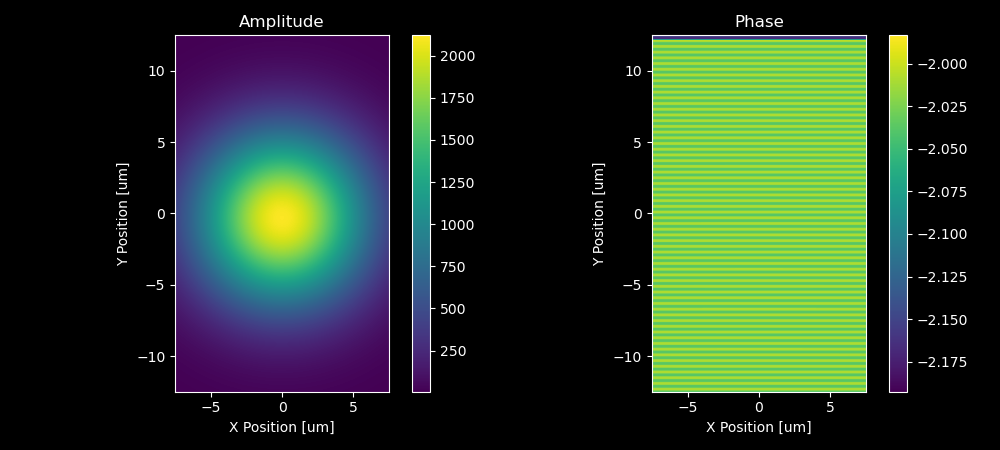

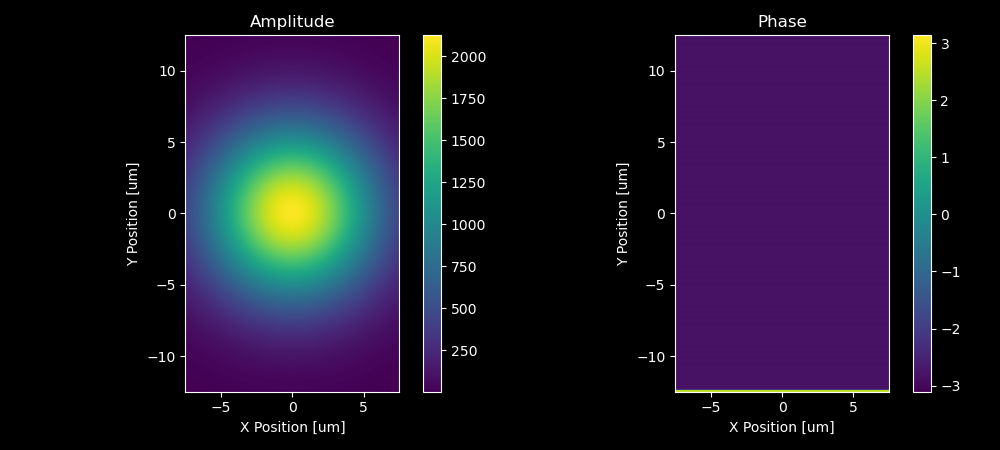

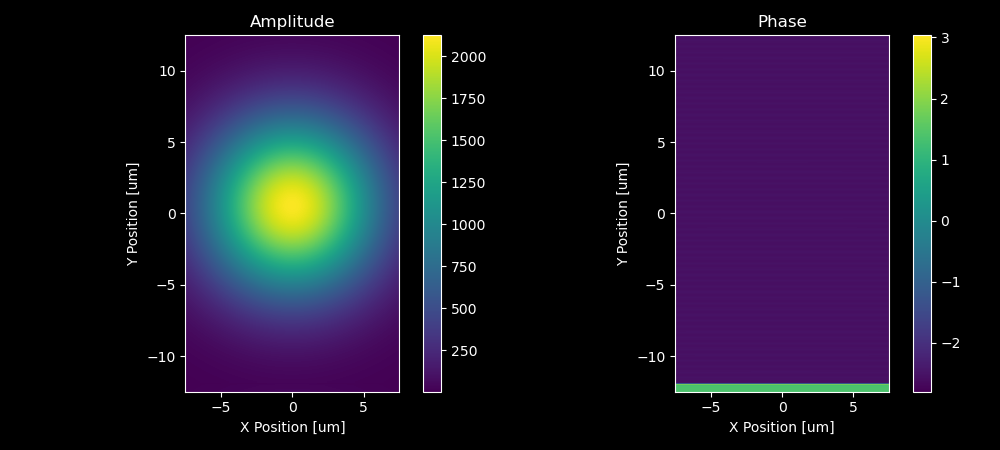

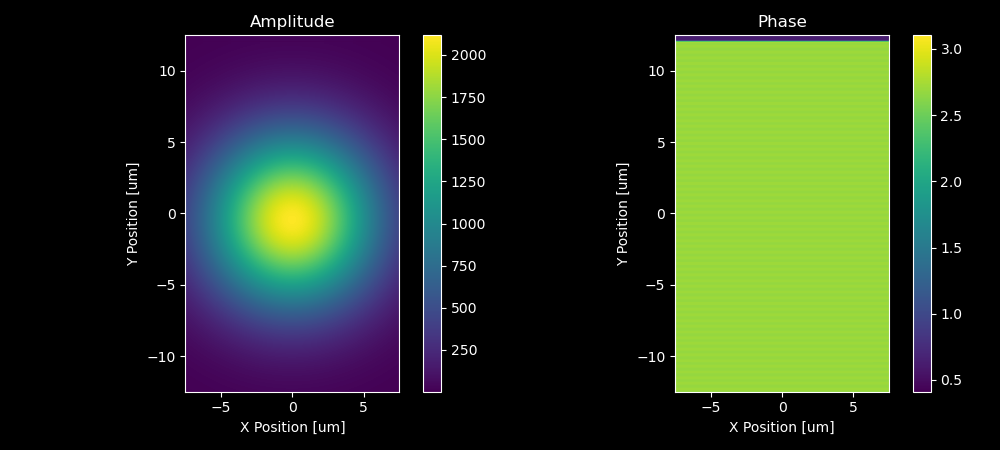

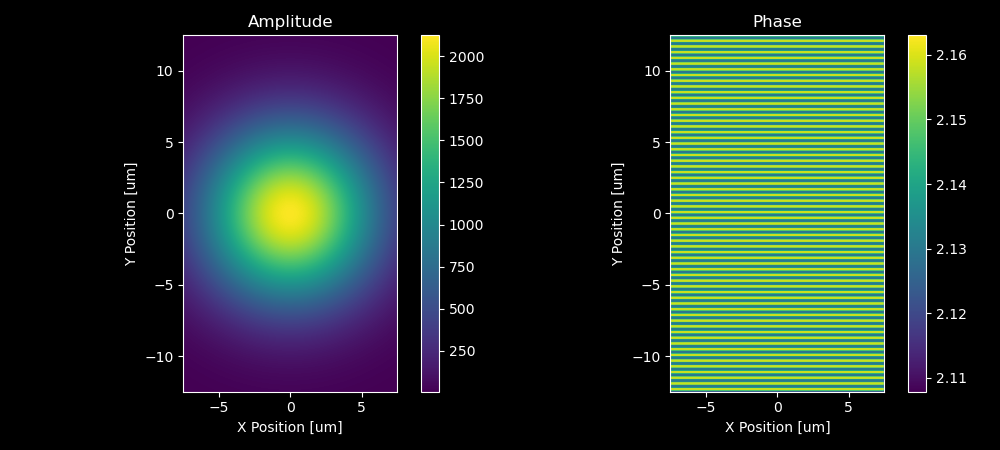

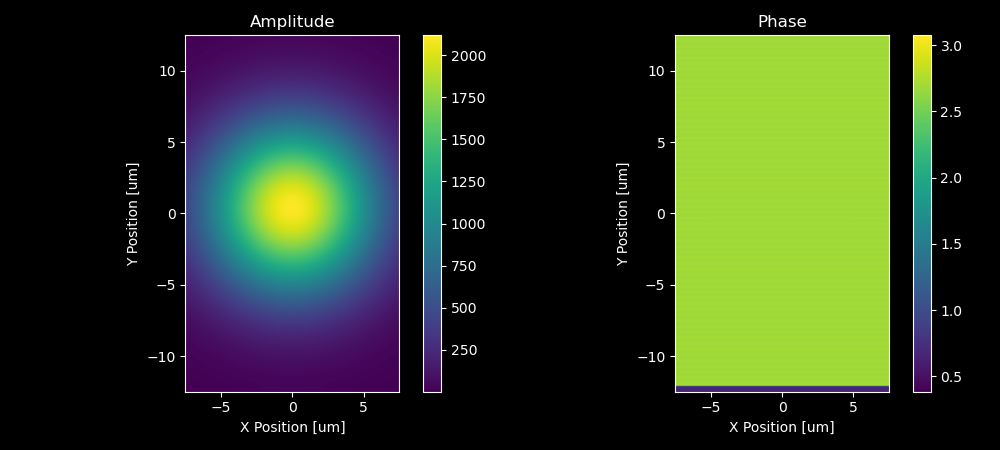

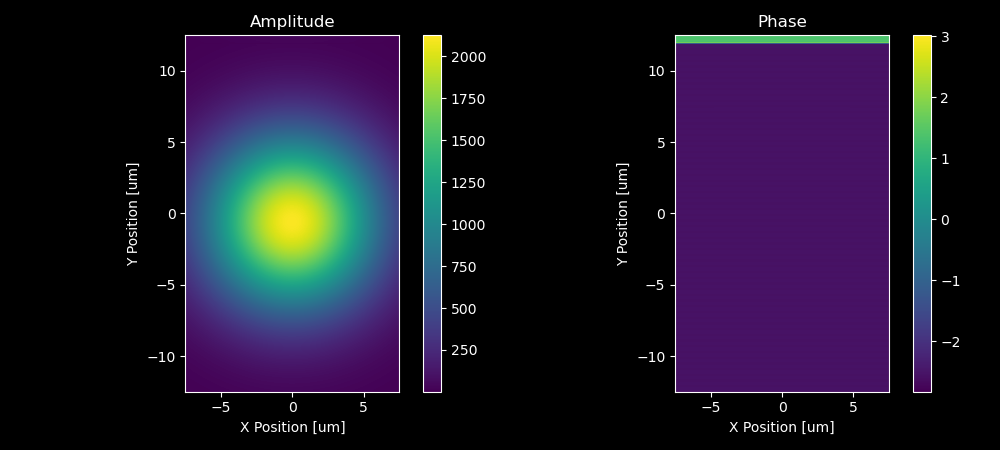

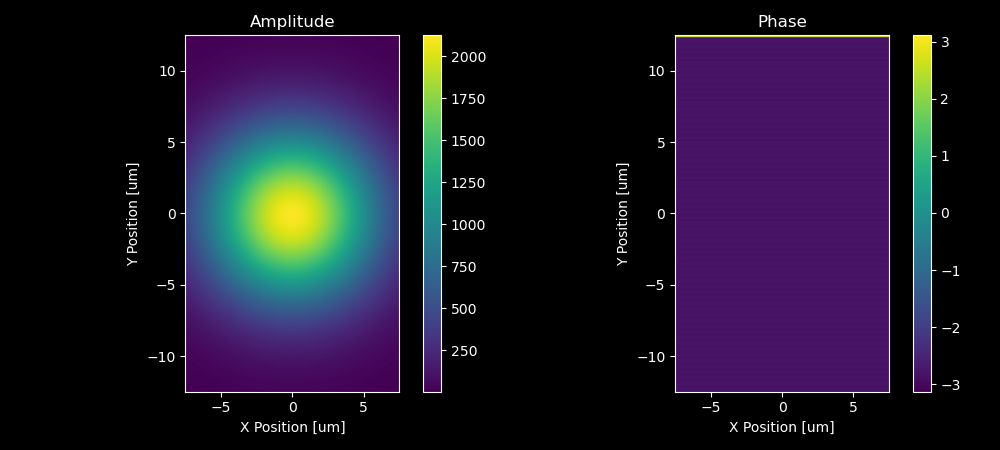

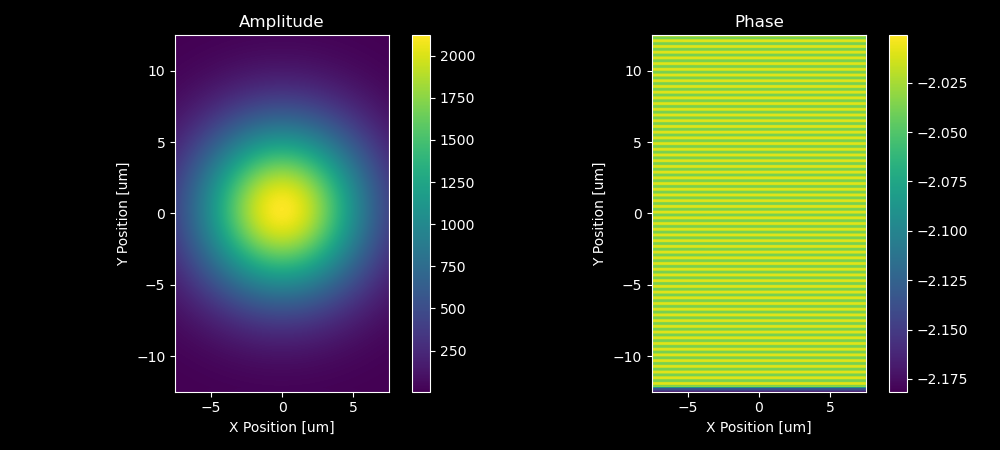

In [372]:
# Modify wavefront Batch -1.75 - 1.75 rectangle
flag_plot = True

x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
wf_fc_out = []
#wf_ramp_list = []
count = 0
for a, rot_ax in inv_ang:
    print(inv_ang)
    print(a)
    x = a[0]
    y = a[1]
    print(rot_ax)
    wf_nearfield_amp = (qtif[count])[:,:,-1]
    wf_nearfield_ph  = (angtif[count])[:,:,-1]
    # amplitude
    wf_fc_wave = wf_nearfield_amp * np.exp(-1j * wf_nearfield_ph)
    wf_fc_wave *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_amp = wf_nearfield_amp
    #np.abs(wf_fc)
    # phase
    wf_fc_ph_ramp = np.zeros(wave_prop_size)
    if  rot_ax[0] != 0 and rot_ax[1] == 0:   # rot around axis=0 
        for ii in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[ii,:] = (y_ax) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] == 0:   # rot around axis=0 
        for jj in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[:,jj] += (x_ax) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] != 0:   # rot around axis=0 
        for ii in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
            for jj in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
                a = (x_ax[jj]) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
                b = (y_ax[ii]) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
                wf_fc_ph_ramp[jj,ii] += a + b
    #((x_ax[jj]) * np.sin(np.deg2rad(y_ang))/ (1.2398 / photonE) * 2 * np.pi)**2 + ((y_ax[ii]) * np.sin(np.deg2rad(incident_ang))/ (1.2398 / photonE) * 2 * np.pi)**2+2*(y_ax[ii]* np.sin(np.deg2rad(incident_ang))*x_ax[jj]* np.sin(np.deg2rad(y_ang)))*np.cos(0.5)/((1.2398 / photonE) * 2 * np.pi*(1.2398 / photonE) * 2 * np.pi)
    #Look at the DOI paper for reference
    wf_fc_mod = wf_fc_amp * np.exp(-1j * (wf_fc_ph_ramp + np.angle(wf_fc_wave)) )
    #print(np.shape(wf_fc))
    wf_fc_mod *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_out.append(wf_fc_mod)
    count += 1
    if flag_plot:   # 2D plot incident wavefront 
        temp = wf_fc_mod
        lim_region = False
        plot_region = [-.1, .1, -2.1, -1.9]
        
        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.abs(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Amplitude'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.subplot(122)
        plt.imshow(np.angle(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Phase'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.tight_layout()
        del temp, plot_region, lim_region
    #wf_ramp_list.append(wf_fc_ph_ramp)
print('%g' %np.sum( np.abs(wf_fc_amp * np.conjugate(wf_fc_amp)) ) )
if flag_plot:   # 1D plot incident wavefront 
    temp = wf_fc_mod
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.tight_layout()
    plt.close()
    del temp
if flag_plot:   # 2D plot incident wavefront 
    temp = wf_fc_mod
    lim_region = False
    plot_region = [-.1, .1, -2.1, -1.9]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.tight_layout()
    plt.close()
    del temp, plot_region, lim_region
del wf_fc_amp, wf_fc_ph_ramp, x_ax, y_ax, flag_plot

[[[ 10.          10.        ]
  [  1.           0.        ]]

 [[  8.57142857   8.57142857]
  [  1.           0.        ]]

 [[  7.14285714   7.14285714]
  [  1.           0.        ]]

 [[  5.71428571   5.71428571]
  [  1.           0.        ]]

 [[  4.28571429   4.28571429]
  [  1.           0.        ]]

 [[  2.85714286   2.85714286]
  [  1.           0.        ]]

 [[  1.42857143   1.42857143]
  [  1.           0.        ]]

 [[ -0.          -0.        ]
  [  1.           0.        ]]

 [[ -1.42857143  -1.42857143]
  [  1.           0.        ]]

 [[ -2.85714286  -2.85714286]
  [  1.           0.        ]]

 [[ -4.28571429  -4.28571429]
  [  1.           0.        ]]

 [[ -5.71428571  -5.71428571]
  [  1.           0.        ]]

 [[ -7.14285714  -7.14285714]
  [  1.           0.        ]]

 [[ -8.57142857  -8.57142857]
  [  1.           0.        ]]

 [[-10.         -10.        ]
  [  1.           0.        ]]]
[10. 10.]
[1. 0.]
[[[ 10.          10.        ]
  [  1.           0.  

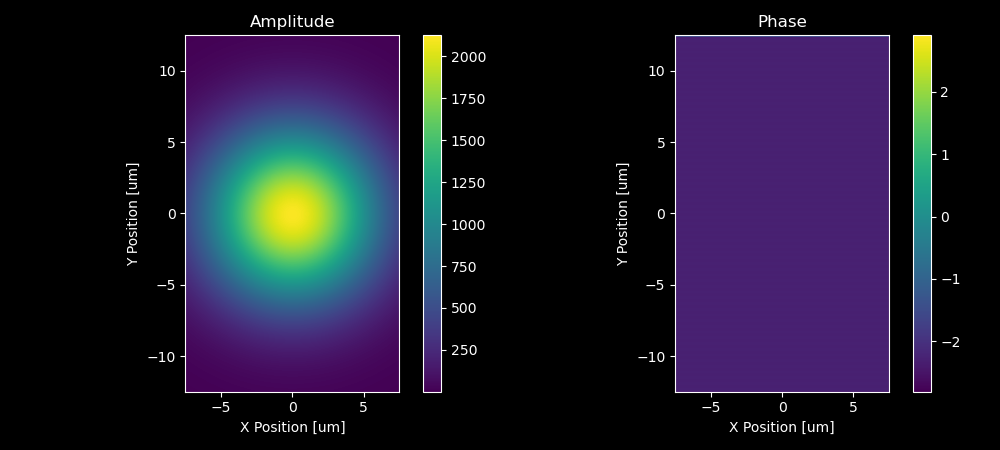

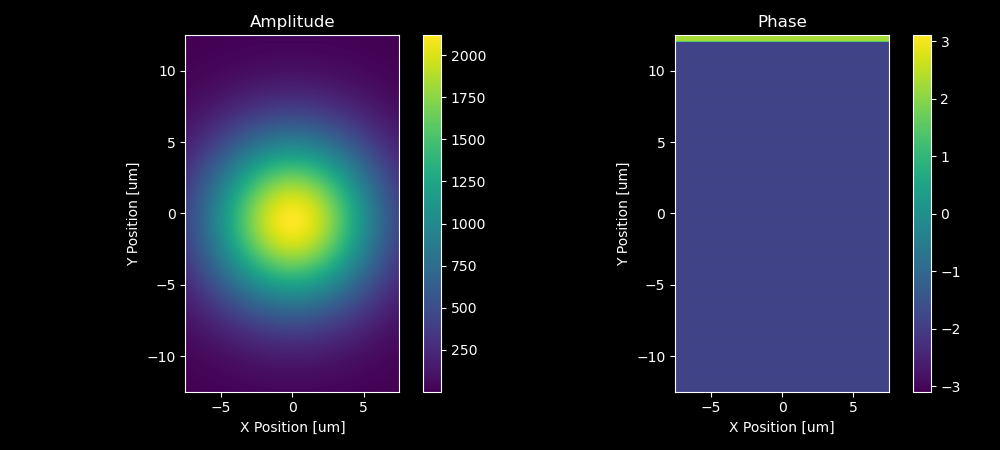

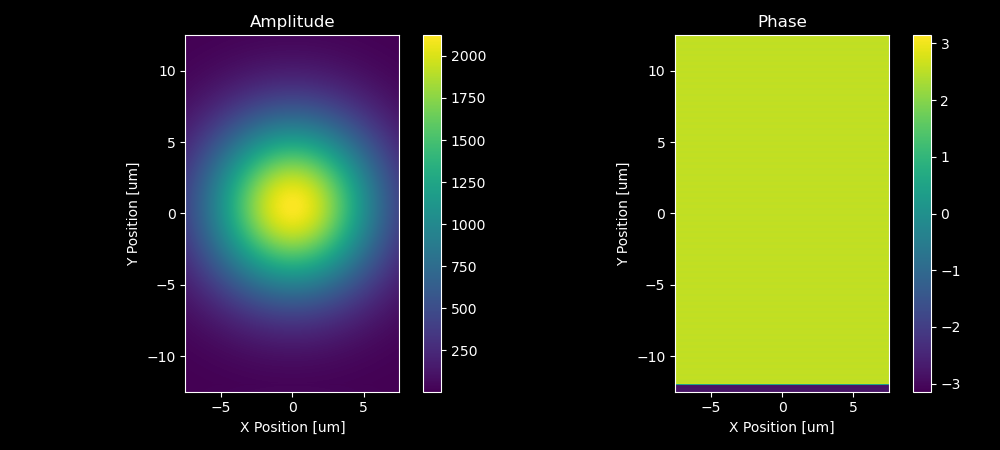

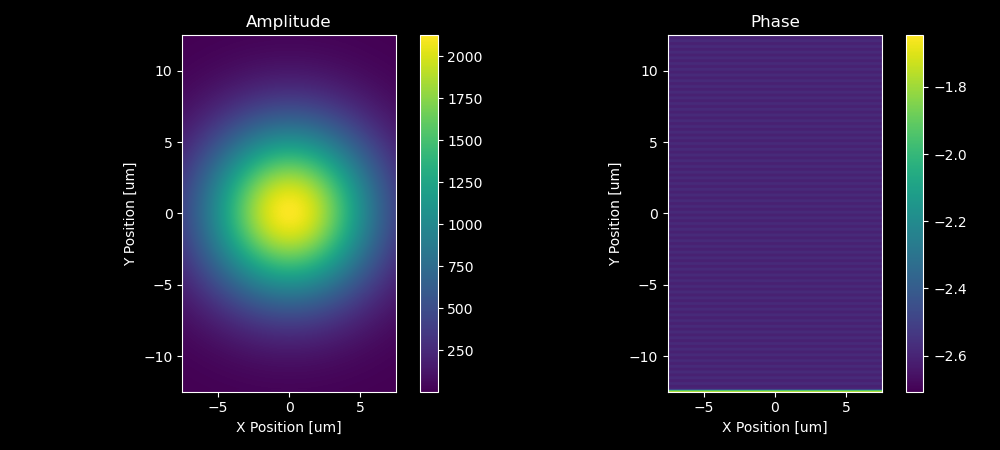

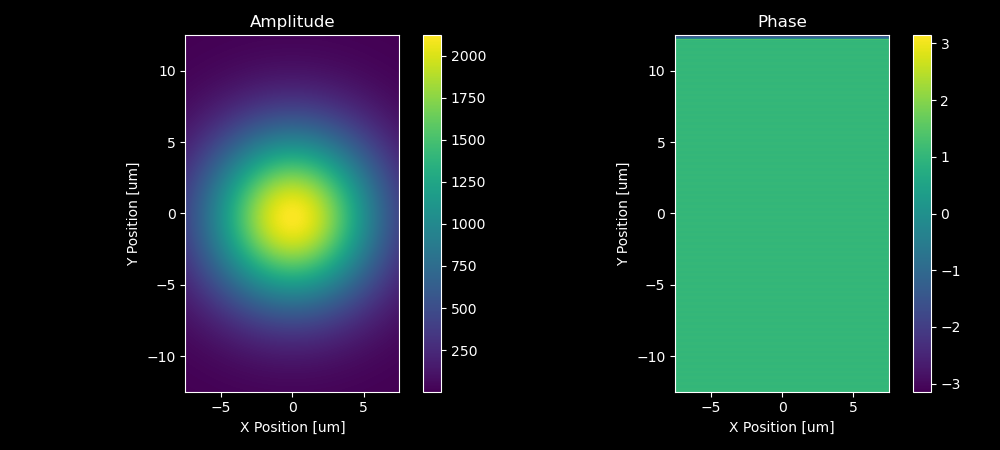

...

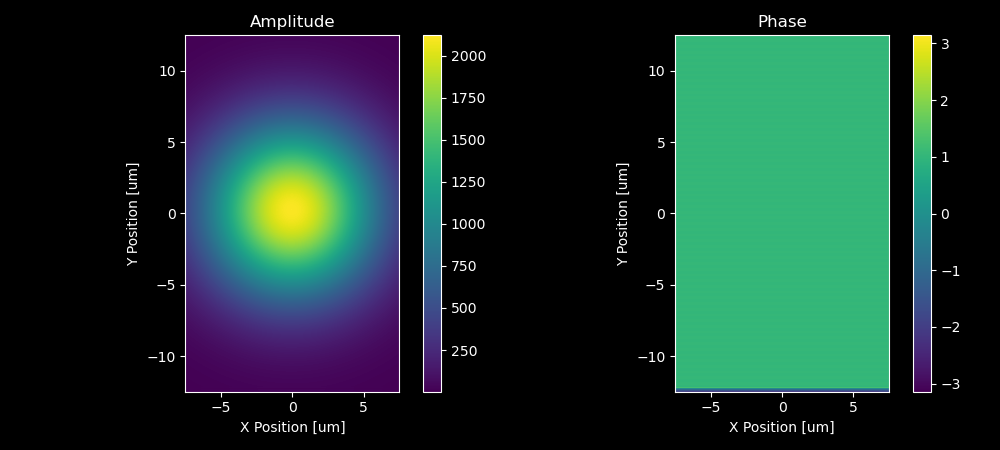

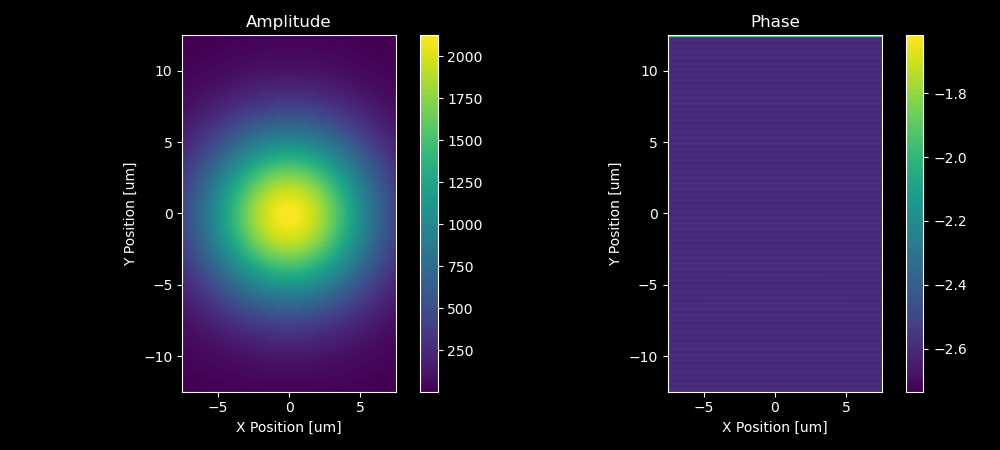

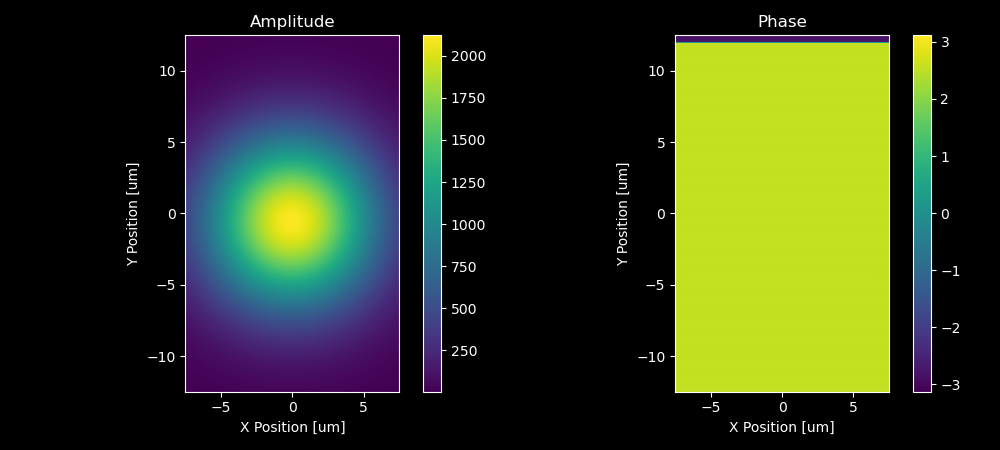

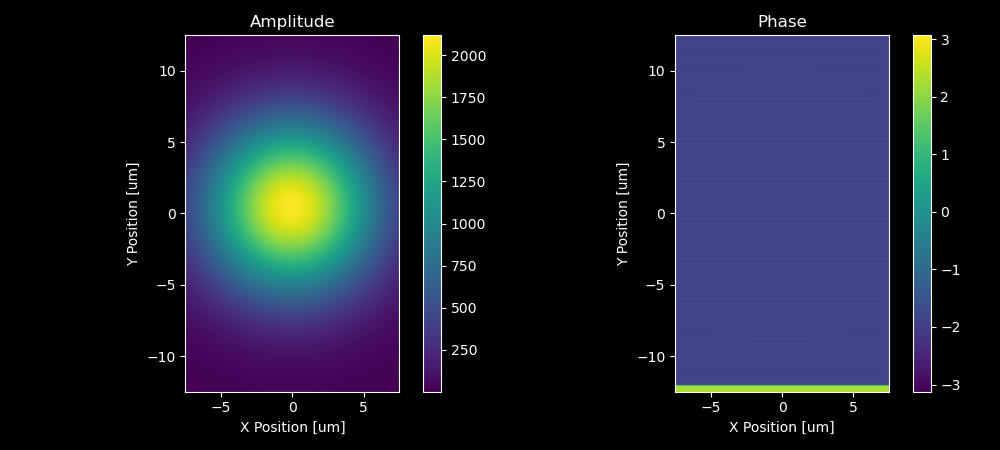

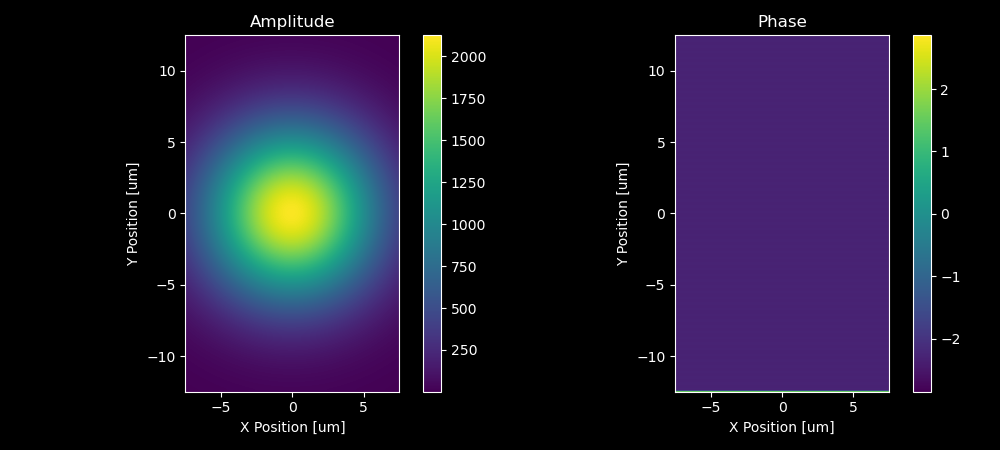

In [447]:
# Modify wavefront Batch -17.5 - 17.5 rectangle
flag_plot = True

x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
wf_fc_out = []
#wf_ramp_list = []
count = 0
for a, rot_ax in inv_ang:
    print(inv_ang)
    print(a)
    x = a[0]
    y = a[1]
    print(rot_ax)
    wf_nearfield_amp = (qtif[count])[:,:,-1]
    wf_nearfield_ph  = (angtif[count])[:,:,-1]
    # amplitude
    wf_fc_wave = wf_nearfield_amp * np.exp(-1j * wf_nearfield_ph)
    wf_fc_wave *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_amp = wf_nearfield_amp
    #np.abs(wf_fc)
    # phase
    wf_fc_ph_ramp = np.zeros(wave_prop_size)
    if  rot_ax[0] != 0 and rot_ax[1] == 0:   # rot around axis=0 
        for ii in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[ii,:] = (y_ax) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] == 0:   # rot around axis=0 
        for jj in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[:,jj] += (x_ax) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] != 0:   # rot around axis=0 
        for ii in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
            for jj in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
                a = (x_ax[jj]) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
                b = (y_ax[ii]) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
                wf_fc_ph_ramp[jj,ii] += a + b
    #((x_ax[jj]) * np.sin(np.deg2rad(y_ang))/ (1.2398 / photonE) * 2 * np.pi)**2 + ((y_ax[ii]) * np.sin(np.deg2rad(incident_ang))/ (1.2398 / photonE) * 2 * np.pi)**2+2*(y_ax[ii]* np.sin(np.deg2rad(incident_ang))*x_ax[jj]* np.sin(np.deg2rad(y_ang)))*np.cos(0.5)/((1.2398 / photonE) * 2 * np.pi*(1.2398 / photonE) * 2 * np.pi)
    #Look at the DOI paper for reference
    wf_fc_mod = wf_fc_amp * np.exp(-1j * (wf_fc_ph_ramp + np.angle(wf_fc_wave)) )
    #print(np.shape(wf_fc))
    wf_fc_mod *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_out.append(wf_fc_mod)
    count += 1
    if flag_plot:   # 2D plot incident wavefront 
        temp = wf_fc_mod
        lim_region = False
        plot_region = [-.1, .1, -2.1, -1.9]
        
        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.abs(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Amplitude'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.subplot(122)
        plt.imshow(np.angle(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Phase'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.tight_layout()
        del temp, plot_region, lim_region
    #wf_ramp_list.append(wf_fc_ph_ramp)
print('%g' %np.sum( np.abs(wf_fc_amp * np.conjugate(wf_fc_amp)) ) )
if flag_plot:   # 1D plot incident wavefront 
    temp = wf_fc_mod
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.tight_layout()
    plt.close()
    del temp
if flag_plot:   # 2D plot incident wavefront 
    temp = wf_fc_mod
    lim_region = False
    plot_region = [-.1, .1, -2.1, -1.9]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.tight_layout()
    plt.close()
    del temp, plot_region, lim_region
del wf_fc_amp, wf_fc_ph_ramp, x_ax, y_ax, flag_plot

[[[ 30.   30. ]
  [  1.    0. ]]

 [[ 22.5  22.5]
  [  1.    0. ]]

 [[ 15.   15. ]
  [  1.    0. ]]

 [[  7.5   7.5]
  [  1.    0. ]]

 [[ -0.   -0. ]
  [  1.    0. ]]

 [[ -7.5  -7.5]
  [  1.    0. ]]

 [[-15.  -15. ]
  [  1.    0. ]]

 [[-22.5 -22.5]
  [  1.    0. ]]

 [[-30.  -30. ]
  [  1.    0. ]]]
[30. 30.]
[1. 0.]
[[[ 30.   30. ]
  [  1.    0. ]]

 [[ 22.5  22.5]
  [  1.    0. ]]

 [[ 15.   15. ]
  [  1.    0. ]]

 [[  7.5   7.5]
  [  1.    0. ]]

 [[ -0.   -0. ]
  [  1.    0. ]]

 [[ -7.5  -7.5]
  [  1.    0. ]]

 [[-15.  -15. ]
  [  1.    0. ]]

 [[-22.5 -22.5]
  [  1.    0. ]]

 [[-30.  -30. ]
  [  1.    0. ]]]
[22.5 22.5]
[1. 0.]
[[[ 30.   30. ]
  [  1.    0. ]]

 [[ 22.5  22.5]
  [  1.    0. ]]

 [[ 15.   15. ]
  [  1.    0. ]]

 [[  7.5   7.5]
  [  1.    0. ]]

 [[ -0.   -0. ]
  [  1.    0. ]]

 [[ -7.5  -7.5]
  [  1.    0. ]]

 [[-15.  -15. ]
  [  1.    0. ]]

 [[-22.5 -22.5]
  [  1.    0. ]]

 [[-30.  -30. ]
  [  1.    0. ]]]
[15. 15.]
[1. 0.]
[[[ 30.   30. ]
  [  1.   

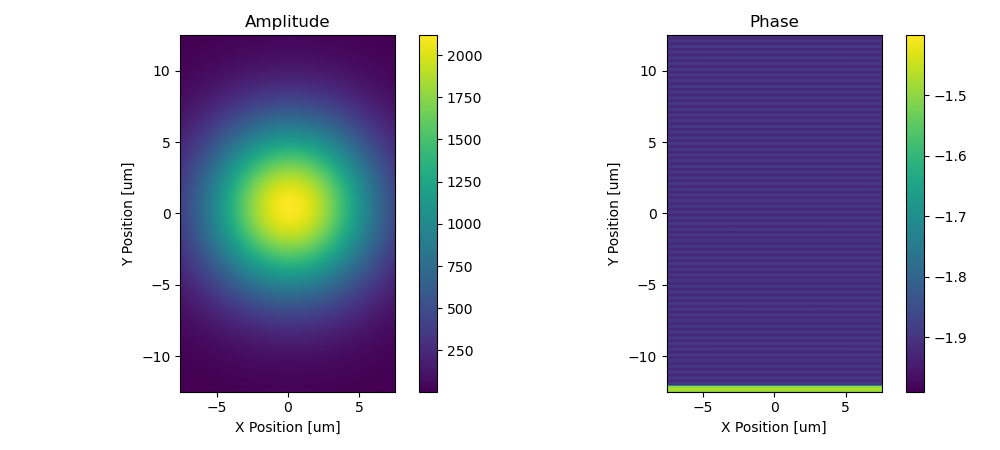

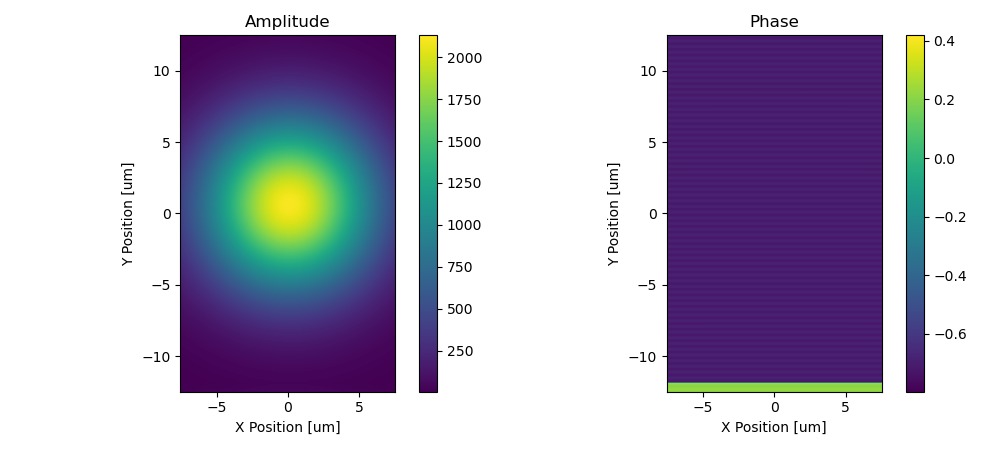

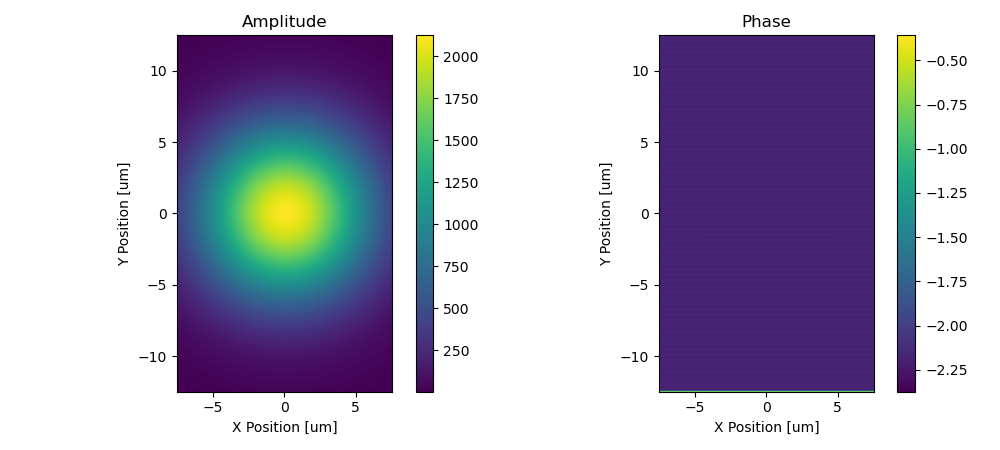

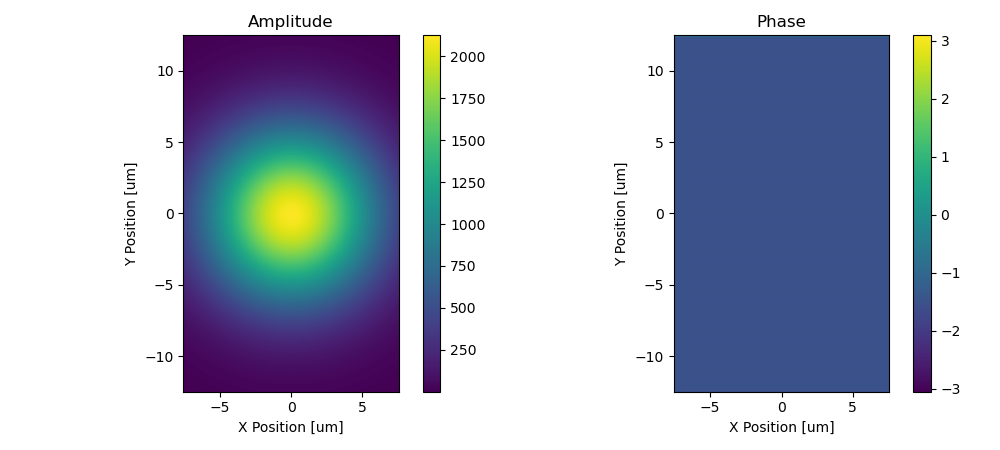

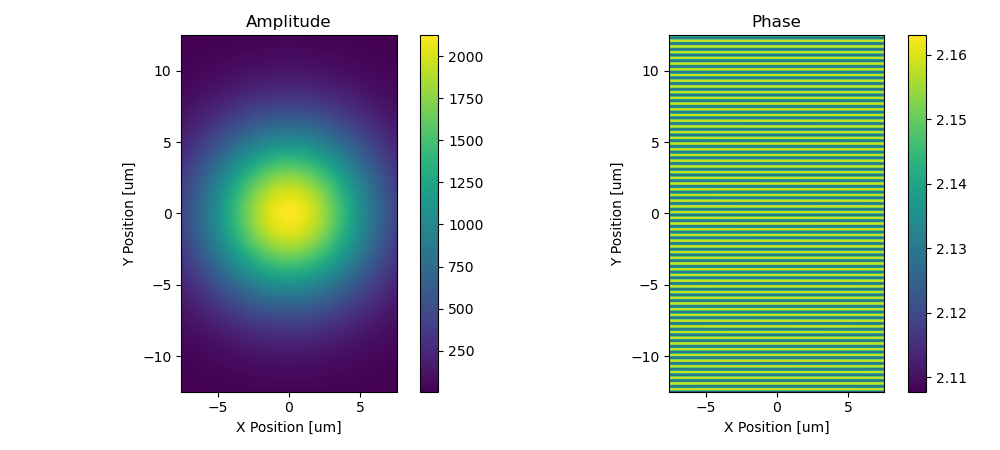

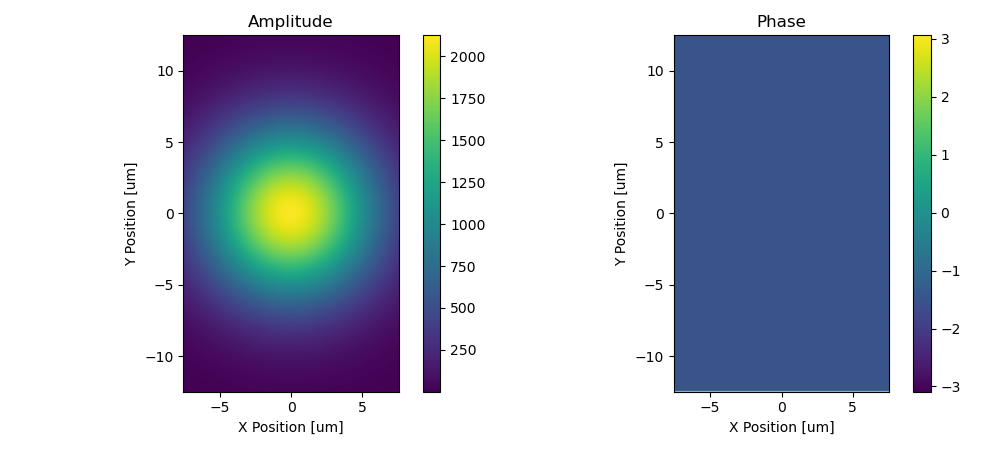

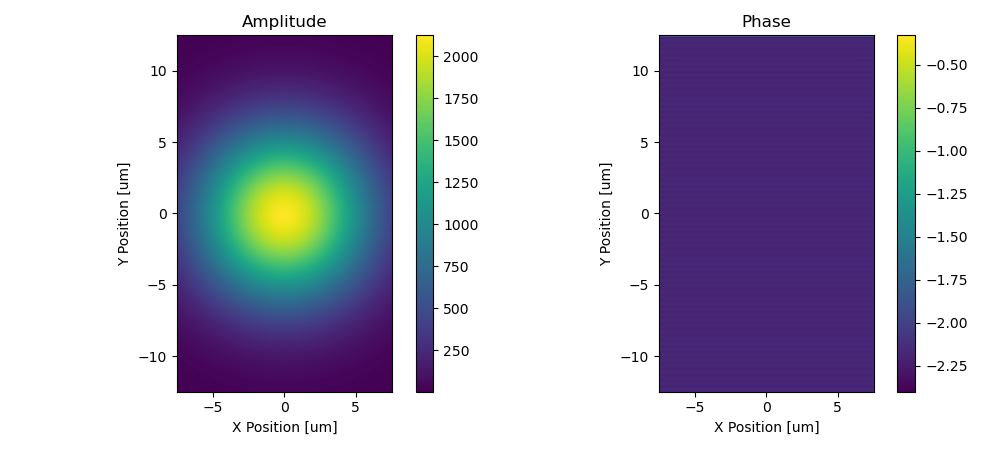

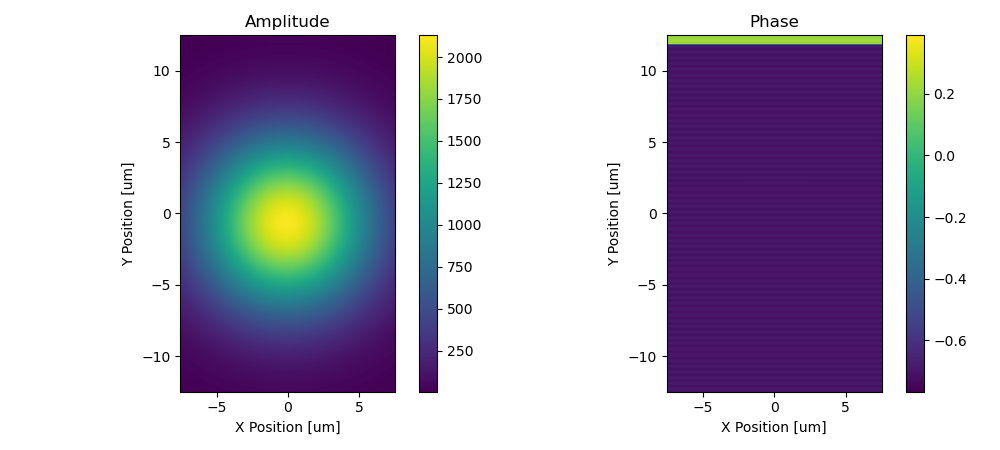

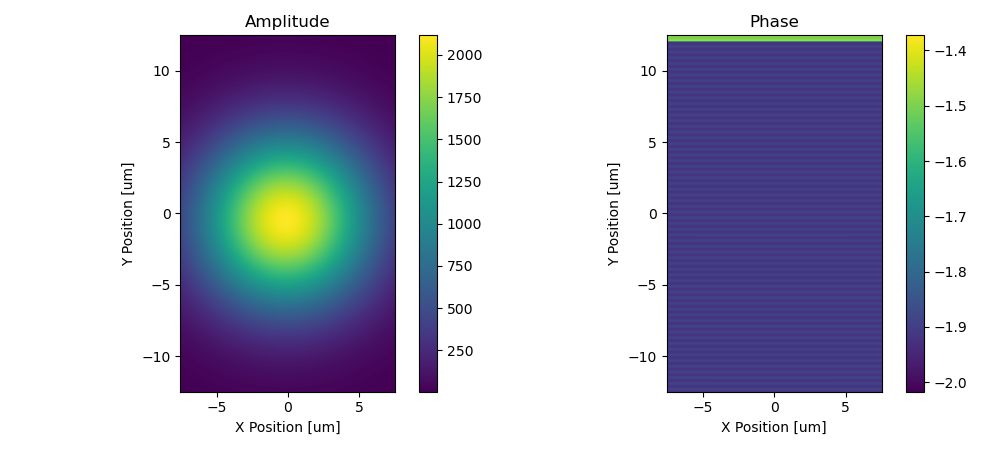

In [62]:
# Modify wavefront Batch -30deg - 30deg rectangle
flag_plot = True

x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
wf_fc_out = []
#wf_ramp_list = []
count = 0
for a, rot_ax in inv_ang:
    print(inv_ang)
    print(a)
    x = a[0]
    y = a[1]
    print(rot_ax)
    wf_nearfield_amp = (qtif[count])[:,:,-1]
    wf_nearfield_ph  = (angtif[count])[:,:,-1]
    # amplitude
    wf_fc_wave = wf_nearfield_amp * np.exp(-1j * wf_nearfield_ph)
    wf_fc_wave *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_amp = wf_nearfield_amp
    #np.abs(wf_fc)
    # phase
    wf_fc_ph_ramp = np.zeros(wave_prop_size)
    if  rot_ax[0] != 0 and rot_ax[1] == 0:   # rot around axis=0 
        for ii in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[ii,:] = (y_ax) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] == 0:   # rot around axis=0 
        for jj in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[:,jj] += (x_ax) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] != 0:   # rot around axis=0 
        for ii in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
            for jj in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
                a = (x_ax[jj]) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
                b = (y_ax[ii]) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
                wf_fc_ph_ramp[jj,ii] += a + b
    #((x_ax[jj]) * np.sin(np.deg2rad(y_ang))/ (1.2398 / photonE) * 2 * np.pi)**2 + ((y_ax[ii]) * np.sin(np.deg2rad(incident_ang))/ (1.2398 / photonE) * 2 * np.pi)**2+2*(y_ax[ii]* np.sin(np.deg2rad(incident_ang))*x_ax[jj]* np.sin(np.deg2rad(y_ang)))*np.cos(0.5)/((1.2398 / photonE) * 2 * np.pi*(1.2398 / photonE) * 2 * np.pi)
    #Look at the DOI paper for reference
    wf_fc_mod = wf_fc_amp * np.exp(-1j * (wf_fc_ph_ramp + np.angle(wf_fc_wave)) )
    #print(np.shape(wf_fc))
    wf_fc_mod *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_out.append(wf_fc_mod)
    count += 1
    if flag_plot:   # 2D plot incident wavefront 
        temp = wf_fc_mod
        lim_region = False
        plot_region = [-.1, .1, -2.1, -1.9]
        
        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.abs(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Amplitude'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.subplot(122)
        plt.imshow(np.angle(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Phase'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.tight_layout()
        del temp, plot_region, lim_region
    #wf_ramp_list.append(wf_fc_ph_ramp)
print('%g' %np.sum( np.abs(wf_fc_amp * np.conjugate(wf_fc_amp)) ) )
if flag_plot:   # 1D plot incident wavefront 
    temp = wf_fc_mod
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.tight_layout()
    plt.close()
    del temp
if flag_plot:   # 2D plot incident wavefront 
    temp = wf_fc_mod
    lim_region = False
    plot_region = [-.1, .1, -2.1, -1.9]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.tight_layout()
    plt.close()
    del temp, plot_region, lim_region
del wf_fc_amp, wf_fc_ph_ramp, x_ax, y_ax, flag_plot

[[[ 30.   30. ]
  [  1.    0. ]]

 [[ 22.5  22.5]
  [  1.    0. ]]

 [[ 15.   15. ]
  [  1.    0. ]]

 [[  7.5   7.5]
  [  1.    0. ]]

 [[ -0.   -0. ]
  [  1.    0. ]]

 [[ -7.5  -7.5]
  [  1.    0. ]]

 [[-15.  -15. ]
  [  1.    0. ]]

 [[-22.5 -22.5]
  [  1.    0. ]]

 [[-30.  -30. ]
  [  1.    0. ]]]
[30. 30.]
[1. 0.]
[[[ 30.   30. ]
  [  1.    0. ]]

 [[ 22.5  22.5]
  [  1.    0. ]]

 [[ 15.   15. ]
  [  1.    0. ]]

 [[  7.5   7.5]
  [  1.    0. ]]

 [[ -0.   -0. ]
  [  1.    0. ]]

 [[ -7.5  -7.5]
  [  1.    0. ]]

 [[-15.  -15. ]
  [  1.    0. ]]

 [[-22.5 -22.5]
  [  1.    0. ]]

 [[-30.  -30. ]
  [  1.    0. ]]]
[22.5 22.5]
[1. 0.]
[[[ 30.   30. ]
  [  1.    0. ]]

 [[ 22.5  22.5]
  [  1.    0. ]]

 [[ 15.   15. ]
  [  1.    0. ]]

 [[  7.5   7.5]
  [  1.    0. ]]

 [[ -0.   -0. ]
  [  1.    0. ]]

 [[ -7.5  -7.5]
  [  1.    0. ]]

 [[-15.  -15. ]
  [  1.    0. ]]

 [[-22.5 -22.5]
  [  1.    0. ]]

 [[-30.  -30. ]
  [  1.    0. ]]]
[15. 15.]
[1. 0.]
[[[ 30.   30. ]
  [  1.   

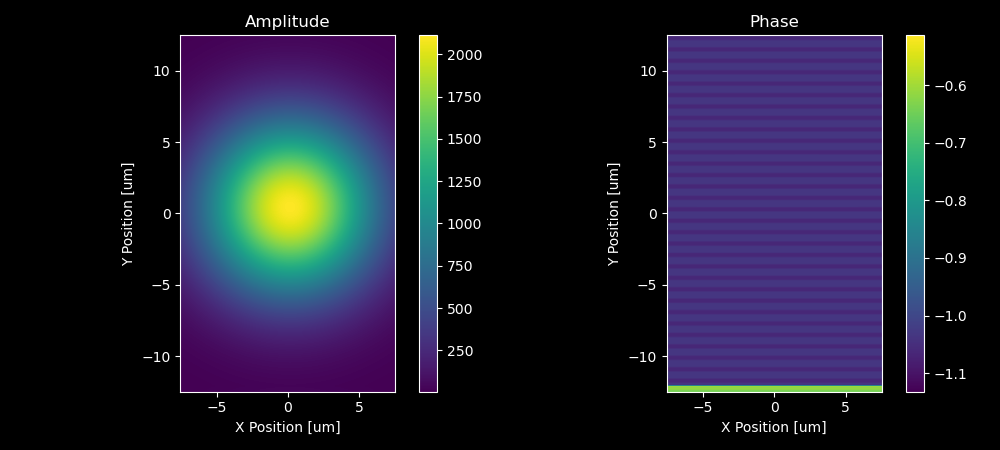

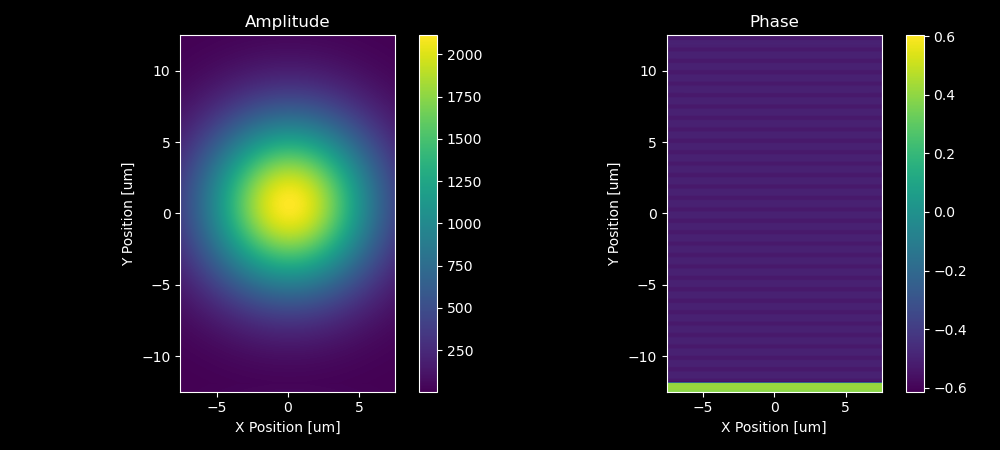

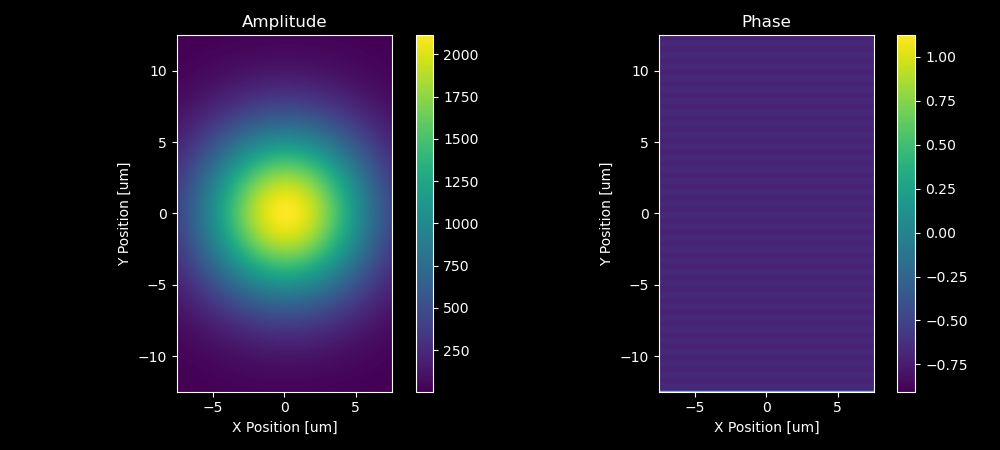

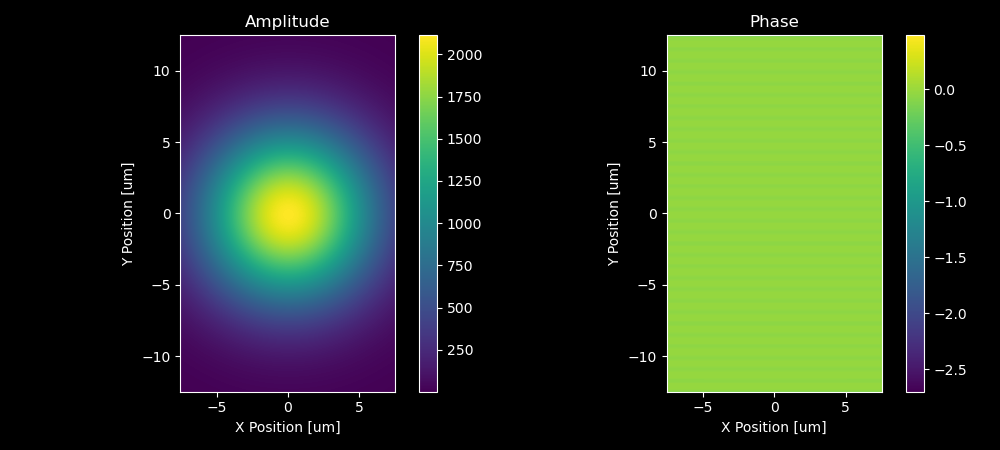

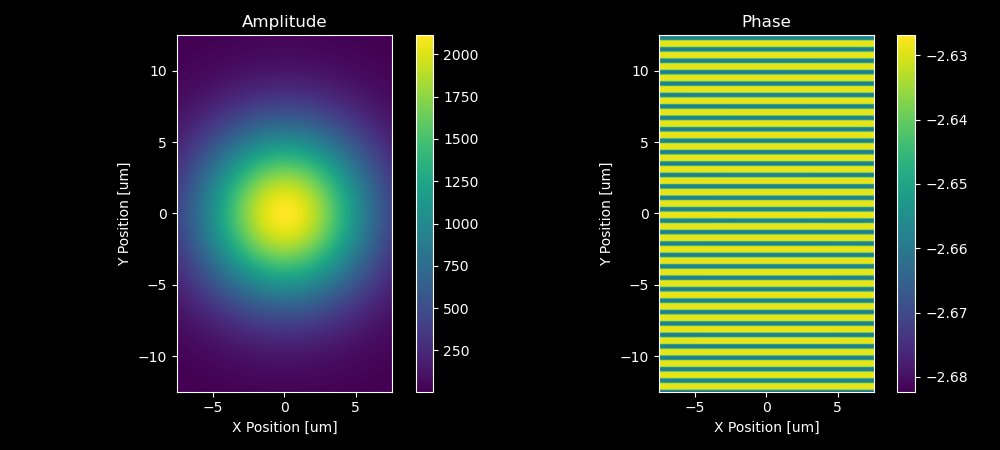

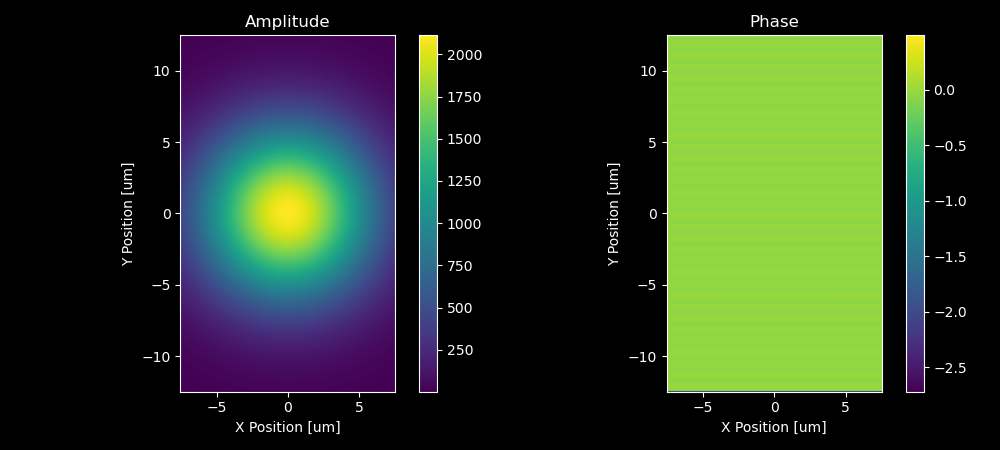

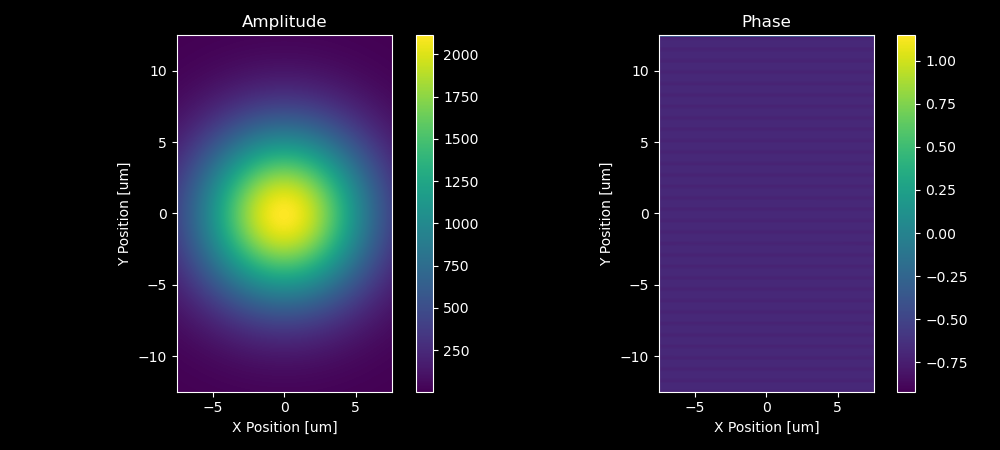

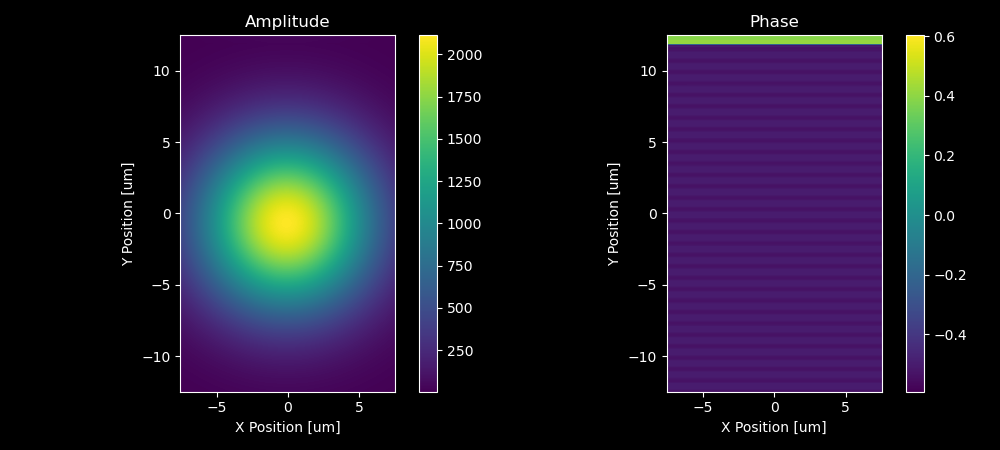

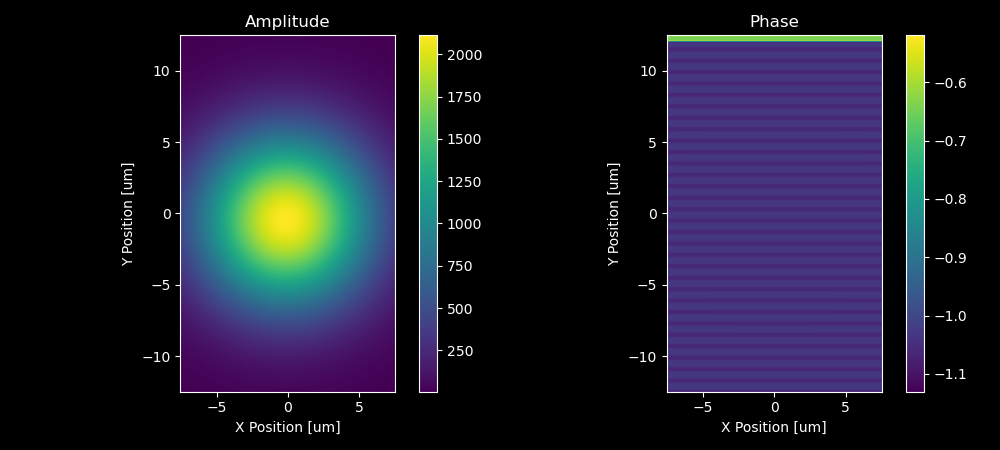

In [95]:
# Modify wavefront Batch -30deg - 30deg trapezoid
flag_plot = True

x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
wf_fc_out = []
#wf_ramp_list = []
count = 0
for a, rot_ax in inv_ang:
    print(inv_ang)
    print(a)
    x = a[0]
    y = a[1]
    print(rot_ax)
    wf_nearfield_amp = (qtif_sample[count])[:,:,-1]
    wf_nearfield_ph  = (angtif_sample[count])[:,:,-1]
    # amplitude
    wf_fc_wave = wf_nearfield_amp * np.exp(-1j * wf_nearfield_ph)
    wf_fc_wave *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_amp = wf_nearfield_amp
    #np.abs(wf_fc)
    # phase
    wf_fc_ph_ramp = np.zeros(wave_prop_size)
    if  rot_ax[0] != 0 and rot_ax[1] == 0:   # rot around axis=0 
        for ii in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[ii,:] = (y_ax) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] == 0:   # rot around axis=0 
        for jj in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[:,jj] += (x_ax) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] != 0:   # rot around axis=0 
        for ii in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
            for jj in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
                a = (x_ax[jj]) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
                b = (y_ax[ii]) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
                wf_fc_ph_ramp[jj,ii] += a + b
    #((x_ax[jj]) * np.sin(np.deg2rad(y_ang))/ (1.2398 / photonE) * 2 * np.pi)**2 + ((y_ax[ii]) * np.sin(np.deg2rad(incident_ang))/ (1.2398 / photonE) * 2 * np.pi)**2+2*(y_ax[ii]* np.sin(np.deg2rad(incident_ang))*x_ax[jj]* np.sin(np.deg2rad(y_ang)))*np.cos(0.5)/((1.2398 / photonE) * 2 * np.pi*(1.2398 / photonE) * 2 * np.pi)
    #Look at the DOI paper for reference
    wf_fc_mod = wf_fc_amp * np.exp(-1j * (wf_fc_ph_ramp + np.angle(wf_fc_wave)) )
    #print(np.shape(wf_fc))
    wf_fc_mod *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_out.append(wf_fc_mod)
    count += 1
    if flag_plot:   # 2D plot incident wavefront 
        temp = wf_fc_mod
        lim_region = False
        plot_region = [-.1, .1, -2.1, -1.9]
        
        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.abs(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Amplitude'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.subplot(122)
        plt.imshow(np.angle(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Phase'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.tight_layout()
        del temp, plot_region, lim_region
    #wf_ramp_list.append(wf_fc_ph_ramp)
print('%g' %np.sum( np.abs(wf_fc_amp * np.conjugate(wf_fc_amp)) ) )
if flag_plot:   # 1D plot incident wavefront 
    temp = wf_fc_mod
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.tight_layout()
    plt.close()
    del temp
if flag_plot:   # 2D plot incident wavefront 
    temp = wf_fc_mod
    lim_region = False
    plot_region = [-.1, .1, -2.1, -1.9]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.tight_layout()
    plt.close()
    del temp, plot_region, lim_region
del wf_fc_amp, wf_fc_ph_ramp, x_ax, y_ax, flag_plot

In [ ]:
# Modify wavefront Batch (2nd ramp)
flag_plot = True

x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
wf_fc_out2 = []
#wf_ramp_list = []
count = 0
for a, rot_ax in zero_ang:
    print(zero_ang)
    print(a)
    x = a[0]
    y = a[1]
    print(rot_ax)
    wf_nearfield_amp = np.abs(wf_fc_out[count])
    wf_nearfield_ph  = np.angle(wf_fc_out[count])
    # amplitude
    wf_fc_wave = wf_nearfield_amp * np.exp(-1j * wf_nearfield_ph)
    wf_fc_wave *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_amp = wf_nearfield_amp
    #np.abs(wf_fc)
    # phase
    wf_fc_ph_ramp = np.zeros(wave_prop_size)
    if  rot_ax[0] != 0 and rot_ax[1] == 0:   # rot around axis=0 
        for ii in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[ii,:] = (y_ax) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] == 0:   # rot around axis=0 
        for jj in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
            wf_fc_ph_ramp[:,jj] += (x_ax) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
    if  rot_ax[1] != 0 and rot_ax[0] != 0:   # rot around axis=0 
        for ii in range(np.dot([0,1], np.shape(wf_fc_ph_ramp))): 
            for jj in range(np.dot([1,0], np.shape(wf_fc_ph_ramp))): 
    #Look at the DOI paper for reference
                a = (x_ax[jj]) * np.sin(np.deg2rad(y)) / (1.2398 / photonE) * 2 * np.pi
                b = (y_ax[ii]) * np.sin(np.deg2rad(x)) / (1.2398 / photonE) * 2 * np.pi
                wf_fc_ph_ramp[jj,ii] += a + b
    #((x_ax[jj]) * np.sin(np.deg2rad(y_ang))/ (1.2398 / photonE) * 2 * np.pi)**2 + ((y_ax[ii]) * np.sin(np.deg2rad(incident_ang))/ (1.2398 / photonE) * 2 * np.pi)**2+2*(y_ax[ii]* np.sin(np.deg2rad(incident_ang))*x_ax[jj]* np.sin(np.deg2rad(y_ang)))*np.cos(0.5)/((1.2398 / photonE) * 2 * np.pi*(1.2398 / photonE) * 2 * np.pi)
    #Look at the DOI paper for reference
    wf_fc_mod = wf_fc_amp * np.exp(-1j * (wf_fc_ph_ramp + np.angle(wf_fc_wave)) )
    #print(np.shape(wf_fc))
    wf_fc_mod *= np.sqrt(beam_flux / np.sum( np.abs(wf_fc_wave * np.conjugate(wf_fc_wave))))
    wf_fc_out.append(wf_fc_mod)
    count += 1
    if flag_plot:   # 2D plot incident wavefront 
        temp = wf_fc_mod
        lim_region = False
        plot_region = [-.1, .1, -2.1, -1.9]
        
        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.abs(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Amplitude'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.subplot(122)
        plt.imshow(np.angle(temp).transpose(), origin='lower', 
                   extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                           y_ax.min()/1e3, y_ax.max()/1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.title('Phase'); plt.colorbar()
        plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
        plt.tight_layout()
        del temp, plot_region, lim_region
    #wf_ramp_list.append(wf_fc_ph_ramp)
print('%g' %np.sum( np.abs(wf_fc_amp * np.conjugate(wf_fc_amp)) ) )
if flag_plot:   # 1D plot incident wavefront 
    temp = wf_fc_mod
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.tight_layout()
    plt.close()
    del temp
if flag_plot:   # 2D plot incident wavefront 
    temp = wf_fc_mod
    lim_region = False
    plot_region = [-.1, .1, -2.1, -1.9]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.tight_layout()
    plt.close()
    del temp, plot_region, lim_region
del wf_fc_amp, wf_fc_ph_ramp, x_ax, y_ax, flag_plot

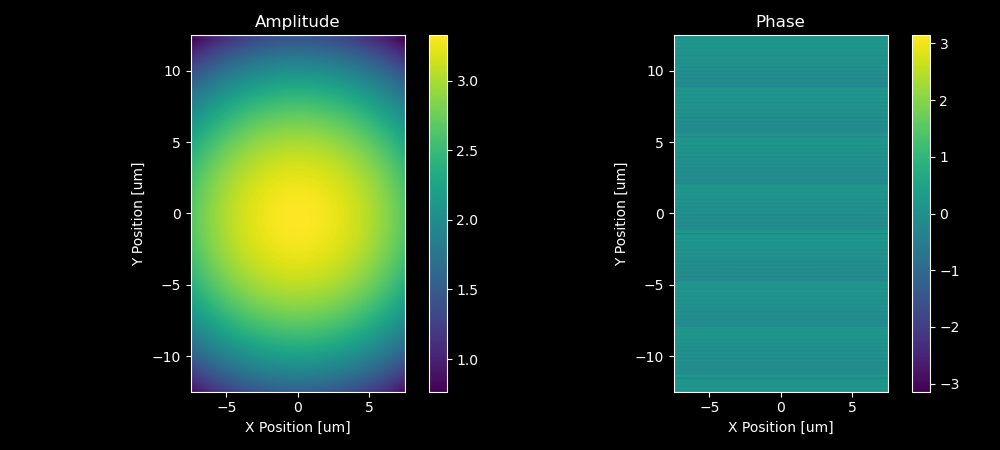

In [347]:
x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
plot_region = [-.1, .1, -2.1, -1.9]
#for i in np.arange(0,len(qtif)):
plt.figure(figsize=(10,4.5))
plt.subplot(121)
plt.imshow(np.log10(qtif[0][:,:,-1]).transpose(), origin='lower', 
            extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                    y_ax.min()/1e3, y_ax.max()/1e3])
if True: 
    #plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.subplot(122)
    plt.imshow(angtif[0][:,:,-1].transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
if True: 
    #plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('X Position [um]'); plt.ylabel('Y Position [um]')
    plt.tight_layout()

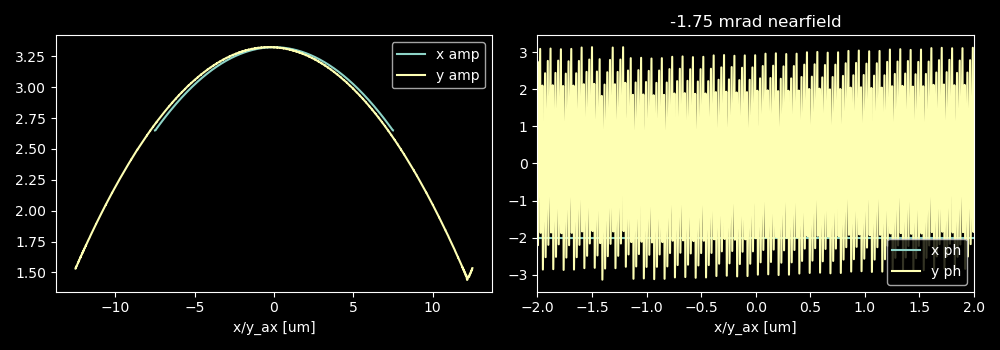

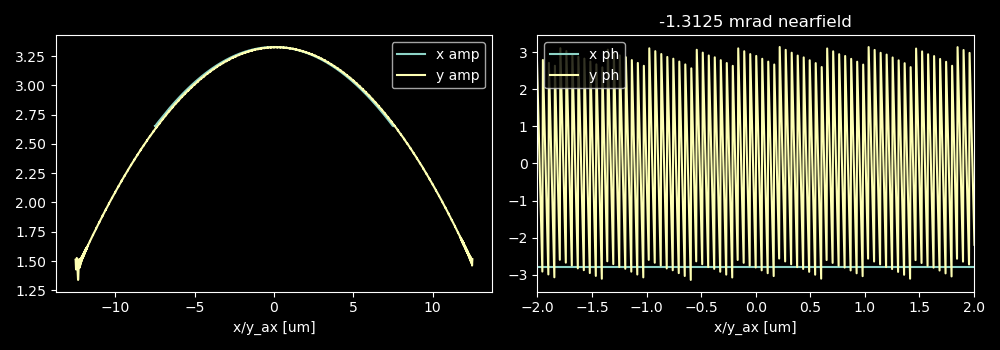

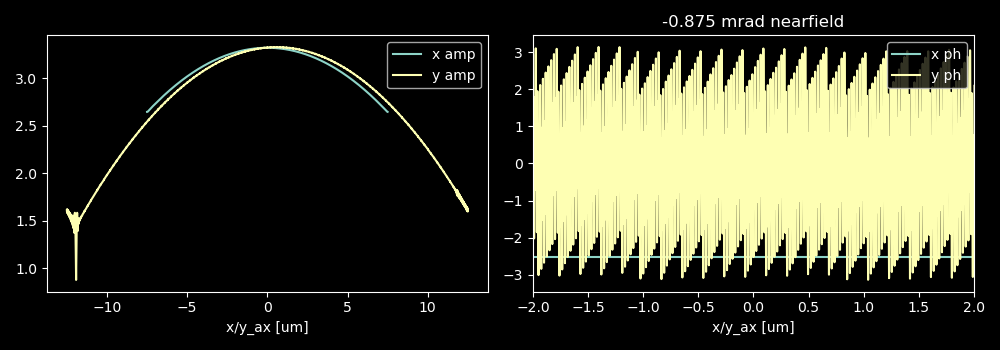

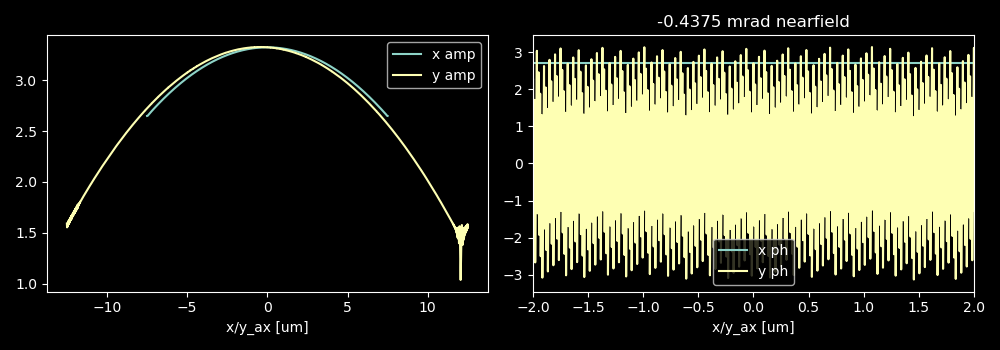

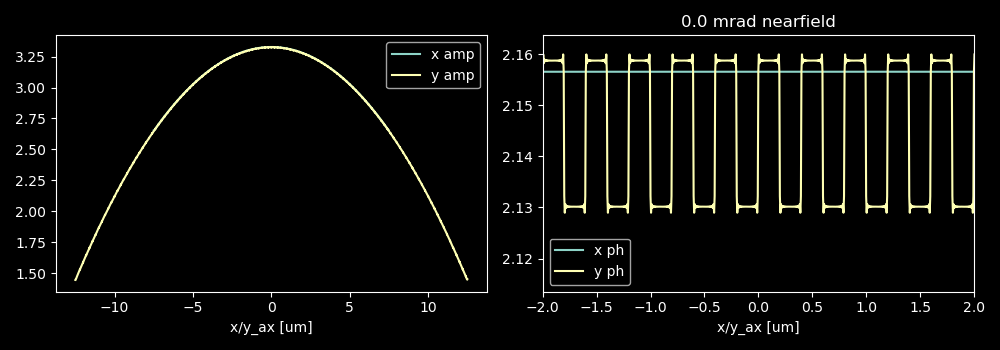

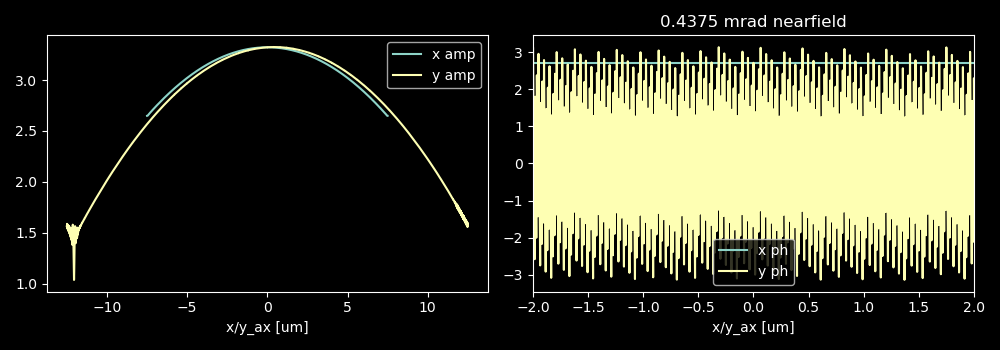

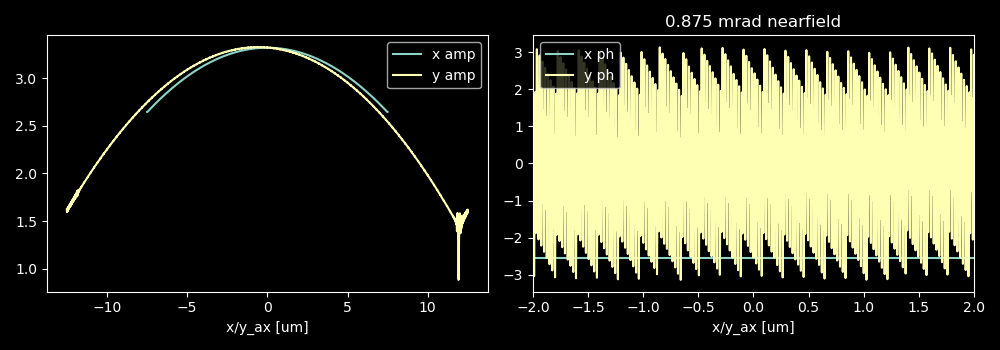

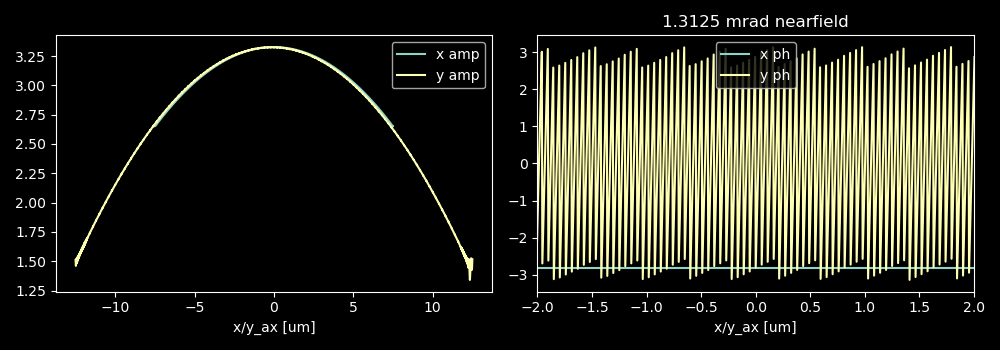

In [ ]:
import cv2
#if True:   # 1D plot incident wavefront #Rectangle -1.75 - 1.75 mrad
#    plt.figure(figsize=(10,3.5))
#    plt.subplot(121)
#    plt.plot(x_ax/1e3, np.log10(qtif[3][:,int(qtif[3].shape[1]/2),-1])#np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])]
#             , label='x amp')
#    plt.plot(y_ax/1e3, np.log10(qtif[3][int(qtif[3].shape[0]/2),:,-1])#np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]
#             , label='y amp')
#    #plt.ylim(3.09,3.11)
#    #plt.xlim(-2,2)
#    plt.legend(); plt.xlabel('x/y_ax [um]')
#    plt.subplot(122)
#    plt.plot(x_ax/1e3, angtif[3][:,int(angtif[3].shape[1]/2),-1]#np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])]
#             , label='x ph')
#    plt.plot(y_ax/1e3, angtif[3][int(angtif[3].shape[0]/2),:,-1]#np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]
#             , label='y ph')
#    plt.xlim(-2,2)
#    plt.legend(); plt.xlabel('x/y_ax [um]')
#    plt.tight_layout()

nearabs = []
for i in np.arange(0,len(qtif)):
    ax10 = plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.log10(qtif[i][:,int(qtif[3].shape[1]/2),-1])#np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])]
             , label='x amp')
    plt.plot(y_ax/1e3, np.log10(qtif[i][int(qtif[3].shape[0]/2),:,-1])#np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]
             , label='y amp')
    #plt.ylim(3.09,3.11)
    #plt.xlim(-2,2)
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, angtif[i][:,int(angtif[3].shape[1]/2),-1]#np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])]
             , label='x ph')
    plt.plot(y_ax/1e3, angtif[i][int(angtif[3].shape[0]/2),:,-1]#np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]
             , label='y ph')
    plt.xlim(-2,2)
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.title(str(x_ang[i]*1.75) + ' mrad nearfield')
    plt.tight_layout()

(3020, 5000)
(3020, 5000)
(3020, 5000)
(3020, 5000)
(3020, 5000)
(3020, 5000)
(3020, 5000)
(3020, 5000)
(3020, 5000)


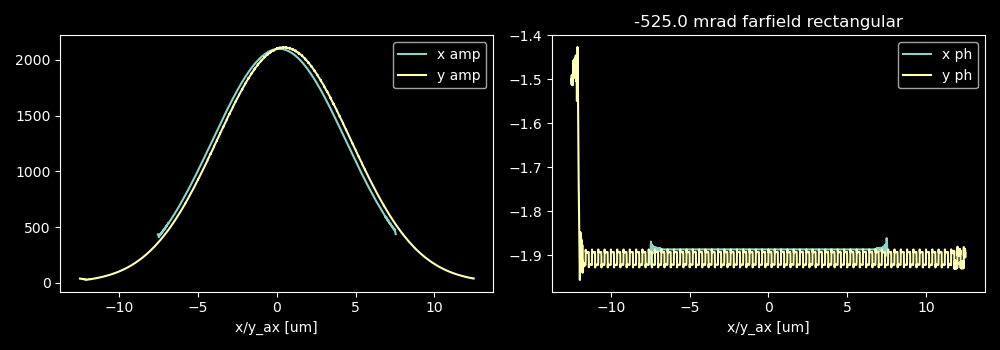

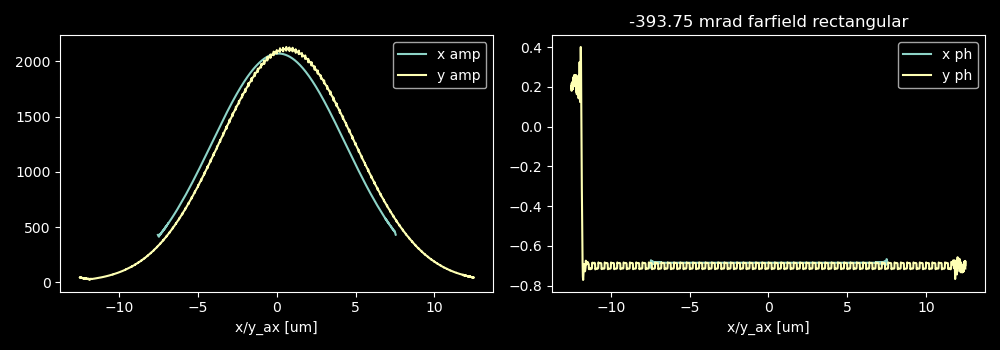

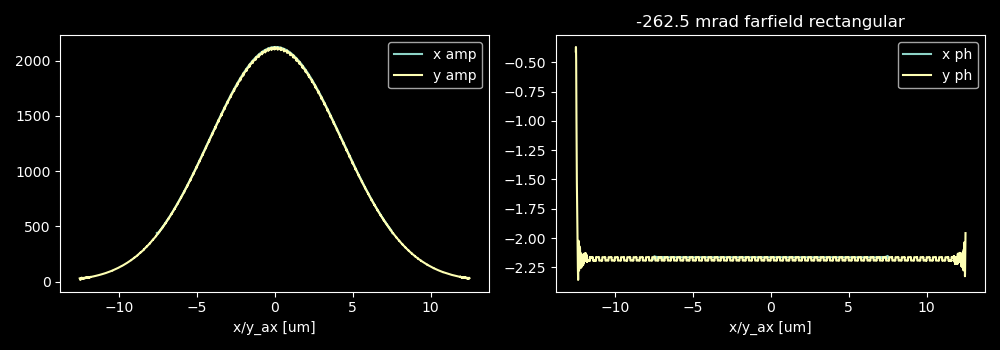

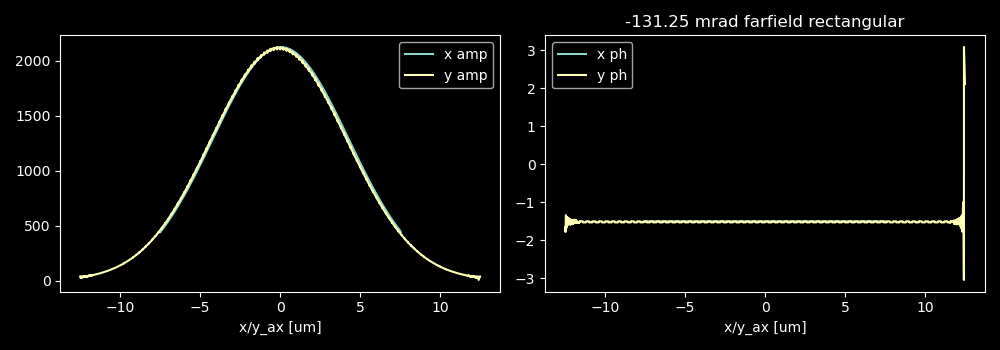

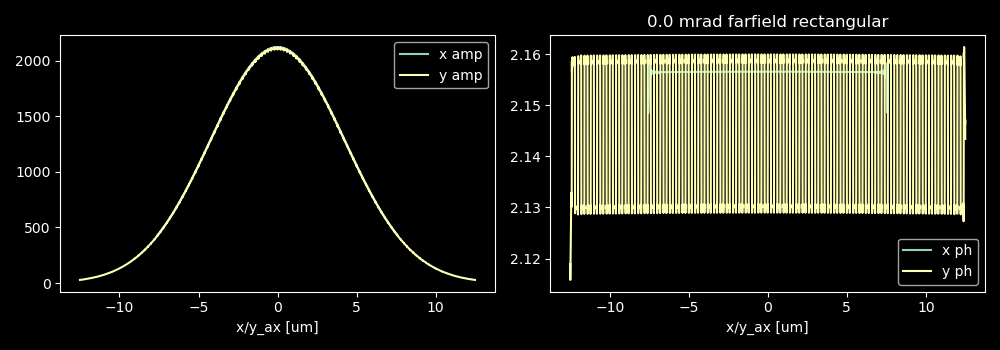

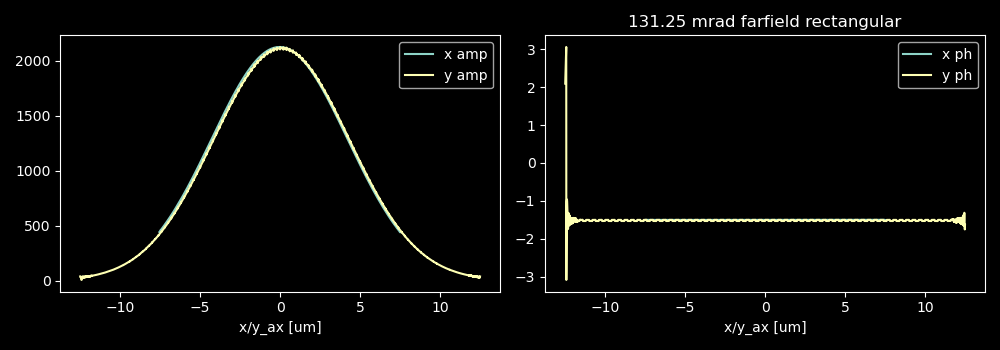

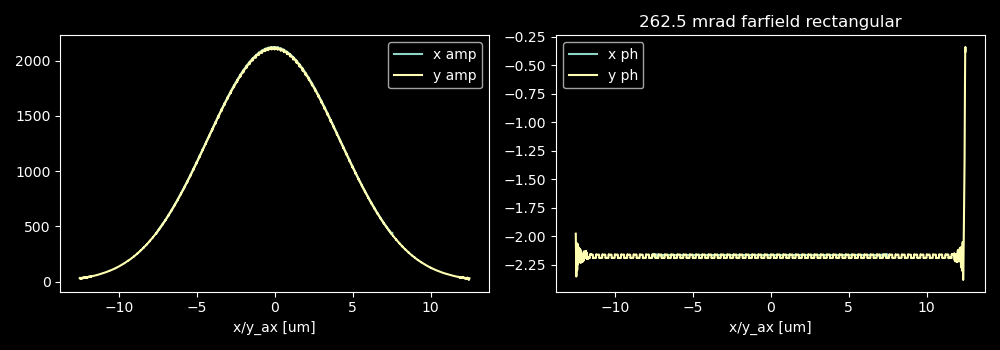

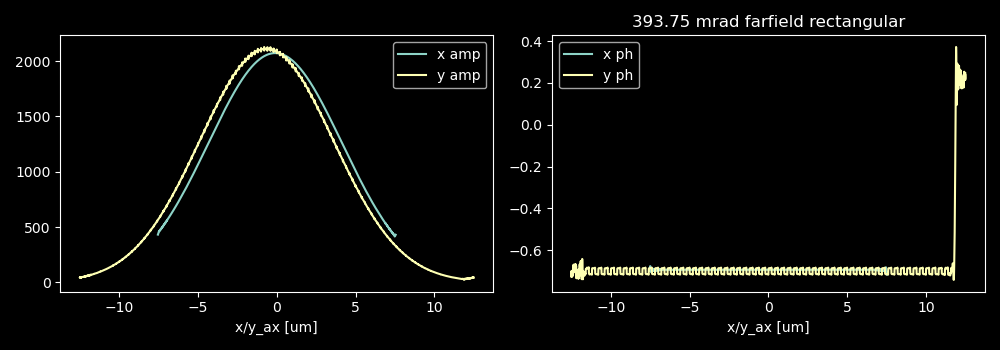

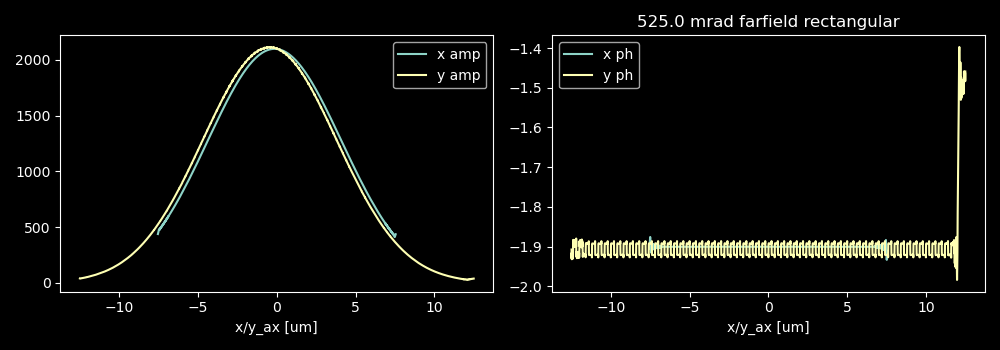

In [190]:
x_ax = (np.arange(wave_prop_size[0]) - int(wave_prop_size[0]/2)) * wave_grid_step[0]
y_ax = (np.arange(wave_prop_size[1]) - int(wave_prop_size[1]/2)) * wave_grid_step[1]
for i in np.arange(0, len(qtif)):   # 1D plot incident wavefront -1.75 - 1.75 farfield rectangle
    temp = wf_fc_out[i]
    print(wf_fc_out[i].shape)
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])]
             , label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]
             , label='y amp')
    #plt.ylim(1200,1400)
    #plt.xlim(-2,2)
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])]
             , label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]
             , label='y ph')
    #plt.xlim(-2,2)
    #plt.ylim(-2.5,-2)
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.title(str(x_ang[i]*17.5) + ' mrad farfield rectangular')
    plt.tight_layout()

(10000, 10000)


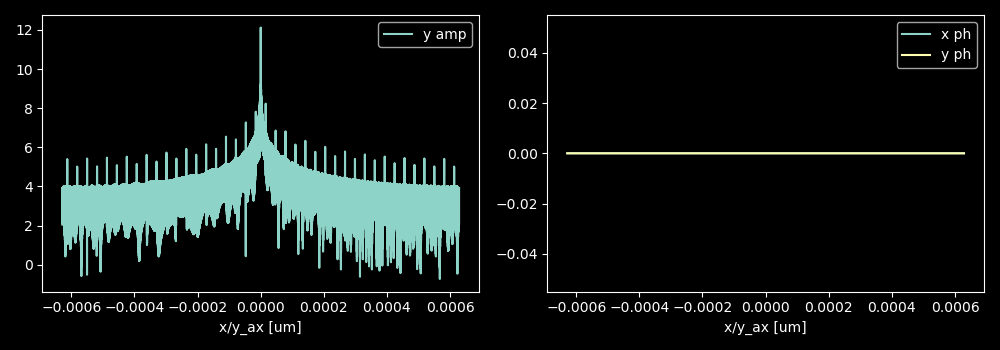

In [116]:
if True:   # 1D plot incident wavefront 
    temp = plotname2[0]
    print(plotname2[0].shape)
    x_ax = qang2[0]
    y_ax = yang2[0]
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    #plt.plot(x_ax/1e3, np.log10(np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])])
    #         , label='x amp')
    plt.plot(y_ax/1e3, np.log10(np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :])
             , label='y amp')
    #plt.ylim(1200,1400)
    #plt.xlim(-2,2)
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])]
             , label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]
             , label='y ph')
    #plt.xlim(-2,2)
    #plt.ylim(-2.5,-2)
    plt.legend(); plt.xlabel('x/y_ax [um]')
    plt.tight_layout()

imgamp = []

In [84]:
qtif[0].shape
qtif[0].shape[1]

5000

In [88]:
angtif[0].shape

(3000, 5000, 10)

1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1
Back propagating 1 / 1


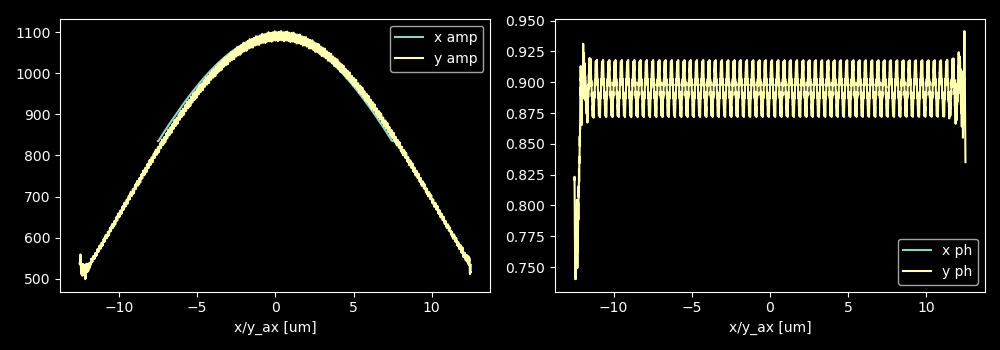

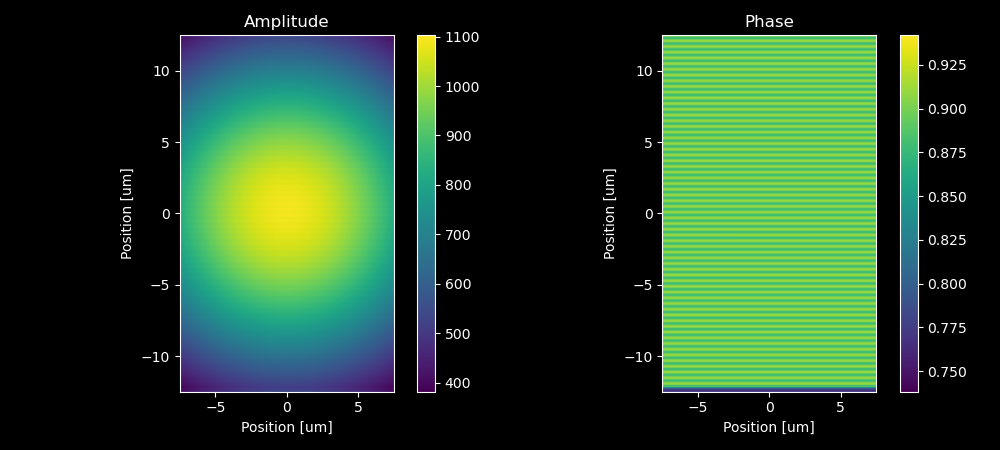

In [301]:
# Back propagation Batch
flag_plot = True

back_prop_size = wave_prop_size
back_prop_dist = dist_to_focal
back_prop_step = back_prop_dist   # [nm] 
back_prop_grid = wave_grid_step   # [nm]

x_ax = (np.arange(back_prop_size[0]) - int(back_prop_size[0]/2)) * back_prop_grid[0]
y_ax = (np.arange(back_prop_size[1]) - int(back_prop_size[1]/2)) * back_prop_grid[1]

N = int(np.abs(back_prop_dist / back_prop_step))
print(N)
wf_out_list = []
for b in wf_fc_out:
    if N != 1: 
        wf_record = np.zeros((N, wave_prop_size[0], wave_prop_size[1])) * (1 + 1j)
#for b in wf_fc_list:
    wf_temp = b.copy()
    for ii in range(N): 
        print('Back propagating %d / %d' %(ii+1, N), end='\r')
        wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=back_prop_step, grid_size=back_prop_grid, 
                                              wave_len=1.2398 / photonE, pad_size=back_prop_size, flag_cropout=False)
        if N != 1: 
            wf_record[ii] = wf_temp
    print('Back propagating %d / %d' %(ii+1, N), end='\n' )
    wf_bp = wf_temp
    wf_out_list.append(wf_bp)
if flag_plot:   # 1D plot of wavefront 
    temp = wf_bp
    lim_region = False
    plot_region = [-10, 10]
    
    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plot(x_ax/1e3, np.abs(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x amp')
    plt.plot(y_ax/1e3, np.abs(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y amp')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    if lim_region: 
        plt.xlim(plot_region)
    plt.subplot(122)
    plt.plot(x_ax/1e3, np.angle(temp)[:, int(np.shape(temp)[1]/2 + gau_cen_offset[1]/wave_grid_step[1])], label='x ph')
    plt.plot(y_ax/1e3, np.angle(temp)[int(np.shape(temp)[0]/2 + gau_cen_offset[0]/wave_grid_step[0]), :], label='y ph')
    plt.legend(); plt.xlabel('x/y_ax [um]')
    if lim_region: 
        plt.xlim(plot_region)
    plt.tight_layout()
    del temp, plot_region, lim_region
if flag_plot:   # 2D plot of wavefront 
    temp = wf_bp
    lim_region = False
    plot_region = [-10, 10, -10, 10]
    
    plt.figure(figsize=(10,4.5))
    plt.subplot(121)
    plt.imshow(np.abs(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Amplitude'); plt.colorbar()
    plt.xlabel('Position [um]'); plt.ylabel('Position [um]')
    plt.subplot(122)
    plt.imshow(np.angle(temp).transpose(), origin='lower', 
               extent=[x_ax.min()/1e3, x_ax.max()/1e3, 
                       y_ax.min()/1e3, y_ax.max()/1e3])
    if lim_region: 
        plt.axis(plot_region)
    plt.title('Phase'); plt.colorbar()
    plt.xlabel('Position [um]'); plt.ylabel('Position [um]')
    plt.tight_layout()
    del temp, plot_region, lim_region
del wf_temp, x_ax, y_ax, flag_plot
if N != 1: 
    plot_region = [-60, 0, -30, 30]
    if True:   # 2D plot of wavefront 
        temp = np.abs(wf_record)
        lim_region = True

        plt.figure(figsize=(10,4.5))
        plt.subplot(121)
        plt.imshow(np.log10(temp[:, :, int(np.shape(temp)[2]/2 + gau_cen_offset[1]/wave_grid_step[1])]).transpose(), origin='lower', 
                   extent=[ 0, back_prop_dist/1e4, 
                           -np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3, 
                            np.shape(temp)[1]/2 * wave_grid_step[0] / 1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.colorbar(); plt.title('XZ slice at Y = %0.3f [um]' %(gau_cen_offset[1]/1e3))
        plt.ylabel('X [um]'); plt.xlabel('Z [x10 um]')
        plt.tight_layout()
        plt.subplot(122)
        plt.imshow(np.log10(temp[:, int(np.shape(temp)[1]/2 + gau_cen_offset[0]/wave_grid_step[0]), :]).transpose(), origin='lower', 
                   extent=[ 0, back_prop_dist/1e4, 
                           -np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3, 
                            np.shape(temp)[2]/2 * wave_grid_step[1] / 1e3])
        if lim_region: 
            plt.axis(plot_region)
        plt.colorbar(); plt.title('YZ slice at X = %0.3f [um]' %(gau_cen_offset[0]/1e3))
        plt.ylabel('Y [um]'); plt.xlabel('Z [x10 um]')
        plt.tight_layout()
        del temp, lim_region
    plt.close()
    del plot_region, wf_record

In [ ]:
''' # for reading only
# Propagation - single element 
wave_vec = 2*np.pi/wave_len   # [nm-1]
density = xb.ElementDensity(element_Z)   # [g/cm3]
# Index of Refraction = (1-delta) - i(beta)
delta = 1 - xb.Refractive_Index_Re(xb.AtomicNumberToSymbol(element_Z), photonE, density)
beta  = xb.Refractive_Index_Im(xb.AtomicNumberToSymbol(element_Z), photonE, density)

print('Started ' + strftime('%H:%M:%S', localtime()) )

P = np.shape(sample)[0]
if not np.array_equal(np.shape(wf_in), wave_prop_size):  
    wf_temp = Array_zeropad_2D(wf_in, AddTo=wave_prop_size)
else: 
    wf_temp = np.copy(wf_in)
wf_rec = np.zeros((int(P/10)+1, wave_prop_size[0], wave_prop_size[1])).astype('complex128')
wf_rec[0] = wf_temp
for ii in range(P): 
    print('Propagating %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()), end='\r')
    sample_temp = Array_zeropad_2D(sample[ii, :,:]*wave_prop_step, AddTo=wave_prop_size)
    # attenuation 
    sample_abs = np.exp(- wave_vec * beta * sample_temp)
    wf_temp *= sample_abs
    # phase delay 
    sample_phd = np.exp(-1j * wave_vec * delta * sample_temp)
    wf_temp *= sample_phd
    # propagation 
    wf_temp = wavefront_propagator_angspc(wf_temp, dist_z=wave_prop_step, grid_size=wave_grid_step, 
                                          wave_len=wave_len, pad_size=wave_prop_size, flag_cropout=False)
    if np.remainder(ii+1, 10) == 0: 
        wf_rec[int((ii+1)/10)] = wf_temp
print('Finished    %d / %d   ' %(ii+1, P) + strftime('%H:%M:%S', localtime()))
print(np.shape(wf_rec))
if True: 
    Save_tif(np.abs(wf_rec), 'wf_rec_subonly_amp.tif', OverWrite=True)
    Save_tif(np.angle(wf_rec), 'wf_rec_subonly_ph.tif', OverWrite=True)
del wf_temp, wf_rec, P, sample_temp
'''

In [151]:
# skip for now
# propagate to farfield 
if flag_subonly: 
    print('Load wf_rec_subonly_*')
    wf_nearfield_amp = Read_tif('wf_rec_subonly_amp.tif')[:,:,-1]
    wf_nearfield_ph  = Read_tif('wf_rec_subonly_ph.tif')[:,:,-1]
else: 
    print('Load wf_rec_pillars_*')
    wf_nearfield_amp = Read_tif('wf_rec_pillars_amp.tif')[:,:,-1]
    wf_nearfield_ph  = Read_tif('wf_rec_pillars_ph.tif')[:,:,-1]
wf_nearfield = wf_nearfield_amp * np.exp(-1j * wf_nearfield_ph)

wf_farfield = sp.fft.fftshift(sp.fft.fft2(Array_zeropad_2D(wf_nearfield, AddTo=farf_prop_size)))
# normalized FFT output
wf_farfield /= np.sqrt(np.product(np.shape(wf_farfield)))
# modify farfield image and save to result 
intensity_farfield = np.abs(wf_farfield * np.conjugate(wf_farfield))
if flag_bin_result: 
    intensity_farfield = Array_binning(intensity_farfield[:-1, :-1], Bin=bin_size)
if flag_crop_result: 
    intensity_farfield = Array_crop_2D(intensity_farfield, CropTo=result_size)
# mask direct beam
if flag_mask_beam: 
    center = (np.asarray(np.shape(intensity_farfield))/2).astype('int')
    intensity_farfield[center[0]-25 : center[0]+25, 
                       center[1]-25 : center[1]+25] = 0 
print(np.shape(intensity_farfield))
farf_q_step = 2 * np.pi / np.asarray(wave_grid_step) / (np.asarray(farf_prop_size)-1)
print(farf_q_step)
if flag_bin_result: 
     farf_q_step *= np.asarray(bin_size)
qx_ax = (np.arange(np.shape(intensity_farfield)[0]) - np.shape(intensity_farfield)[0]/2) * farf_q_step[0]
qy_ax = (np.arange(np.shape(intensity_farfield)[1]) - np.shape(intensity_farfield)[1]/2) * farf_q_step[1]
wave_vec = 2*np.pi/wave_len   # [nm-1]
ax_ax = np.rad2deg(np.arctan(qx_ax / wave_vec))
ay_ax = np.rad2deg(np.arctan(qy_ax / wave_vec))

Load wf_rec_pillars_*
>>>>>> Error! File does NOT exist. 


TypeError: 'NoneType' object is not subscriptable

In [974]:
2 * np.pi / np.asarray(wave_grid_step) / (np.asarray(farf_prop_size)-1)
np.rad2deg(np.arctan(qy_ax / wave_vec))

array([-0.24497847, -0.24491722, -0.24485598, ...,  0.24479473,
        0.24485598,  0.24491722])

In [321]:
# skip for now
# propagate to farfield (Batch)
farfield2 = []
qang2 = []
yang2 = []
xang2 = []
ayang2 = []
count = 0
for a,b in zip(qtif,angtif):
    #if flag_subonly:
    #    print('Load wf_rec_subonly_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    #else: 
    #    print('Load wf_rec_pillars_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    wf_nearfield = wf_fc_out[count]#np.abs(wf_fc_out[count][:,:,-1])*np.exp(-1j*np.angle(wf_fc_out[count][:,:,-1]))#a[:,:,-1] * np.exp(-1j * b[:,:,-1])#wf_fc_out[count]##
    
    wf_farfield = sp.fft.fftshift(sp.fft.fft2(Array_zeropad_2D(wf_nearfield, AddTo=farf_prop_size)))
    # normalized FFT output
    wf_farfield /= np.sqrt(np.product(np.shape(wf_farfield)))
    # modify farfield image and save to result 
    intensity_farfield = np.abs(wf_farfield * np.conjugate(wf_farfield))
    farfield2.append(intensity_farfield)
    if flag_bin_result: 
        intensity_farfield = Array_binning(intensity_farfield[:-1, :-1], Bin=bin_size)
        farfield2.append(intensity_farfield)
    if flag_crop_result: 
        intensity_farfield = Array_crop_2D(intensity_farfield, CropTo=result_size)
        farfield2.append(intensity_farfield)
    # mask direct beam
    if flag_mask_beam: 
        print('Mask')
        center = (np.asarray(np.shape(intensity_farfield))/2).astype('int')
        intensity_farfield[center[0]-25 : center[0]+25, 
                           center[1]-25 : center[1]+25] = 0 
    #print(np.shape(intensity_farfield))
    farf_q_step = 2 * np.pi / np.asarray(wave_grid_step) / (np.asarray(farf_prop_size)-1)
    #print(farf_q_step)
    if flag_bin_result: 
         farf_q_step *= np.asarray(bin_size)
    qx_ax = (np.arange(np.shape(intensity_farfield)[0]) - np.shape(intensity_farfield)[0]/2) * farf_q_step[0]
    qy_ax = (np.arange(np.shape(intensity_farfield)[1]) - np.shape(intensity_farfield)[1]/2) * farf_q_step[1]
    qang2.append(qx_ax)
    yang2.append(qy_ax)
    wave_vec = 2*np.pi/wave_len   # [nm-1]
    ax_ax = np.rad2deg(np.arctan(qx_ax / wave_vec))
    ay_ax = np.rad2deg(np.arctan(qy_ax / wave_vec))
    xang2.append(ax_ax)
    ayang2.append(ay_ax)
    count += 1

In [452]:
# skip for now
# propagate to farfield (Batch) (-17.5 - 17.5 rectangle)
farfield3 = []
qang3 = []
yang3 = []
xang3 = []
ayang3 = []
count = 0
for a,b in zip(qtif,angtif):
    #if flag_subonly:
    #    print('Load wf_rec_subonly_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    #else: 
    #    print('Load wf_rec_pillars_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    wf_nearfield = wf_fc_out[count]#np.abs(wf_fc_out[count][:,:,-1])*np.exp(-1j*np.angle(wf_fc_out[count][:,:,-1]))#a[:,:,-1] * np.exp(-1j * b[:,:,-1])#wf_fc_out[count]##
    
    wf_farfield = sp.fft.fftshift(sp.fft.fft2(Array_zeropad_2D(wf_nearfield, AddTo=farf_prop_size)))
    # normalized FFT output
    wf_farfield /= np.sqrt(np.product(np.shape(wf_farfield)))
    # modify farfield image and save to result 
    intensity_farfield = np.abs(wf_farfield * np.conjugate(wf_farfield))
    farfield3.append(intensity_farfield)
    if flag_bin_result: 
        intensity_farfield = Array_binning(intensity_farfield[:-1, :-1], Bin=bin_size)
        farfield3.append(intensity_farfield)
    if flag_crop_result: 
        intensity_farfield = Array_crop_2D(intensity_farfield, CropTo=result_size)
        farfield3.append(intensity_farfield)
    # mask direct beam
    if flag_mask_beam: 
        print('Mask')
        center = (np.asarray(np.shape(intensity_farfield))/2).astype('int')
        intensity_farfield[center[0]-25 : center[0]+25, 
                           center[1]-25 : center[1]+25] = 0 
    #print(np.shape(intensity_farfield))
    farf_q_step = 2 * np.pi / np.asarray(wave_grid_step) / (np.asarray(farf_prop_size)-1)
    #print(farf_q_step)
    if flag_bin_result: 
         farf_q_step *= np.asarray(bin_size)
    qx_ax = (np.arange(np.shape(intensity_farfield)[0]) - np.shape(intensity_farfield)[0]/2) * farf_q_step[0]
    qy_ax = (np.arange(np.shape(intensity_farfield)[1]) - np.shape(intensity_farfield)[1]/2) * farf_q_step[1]
    qang3.append(qx_ax)
    yang3.append(qy_ax)
    wave_vec = 2*np.pi/wave_len   # [nm-1]
    ax_ax = np.rad2deg(np.arctan(qx_ax / wave_vec))
    ay_ax = np.rad2deg(np.arctan(qy_ax / wave_vec))
    xang3.append(ax_ax)
    ayang3.append(ay_ax)
    count += 1

In [63]:
# skip for now
# propagate to farfield (Batch) (-30 deg - 30deg rectangle)
farfield4 = []
qang4 = []
yang4 = []
xang4 = []
ayang4 = []
count = 0
for a,b in zip(qtif,angtif):
    #if flag_subonly:
    #    print('Load wf_rec_subonly_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    #else: 
    #    print('Load wf_rec_pillars_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    wf_nearfield = wf_fc_out[count]#np.abs(wf_fc_out[count][:,:,-1])*np.exp(-1j*np.angle(wf_fc_out[count][:,:,-1]))#a[:,:,-1] * np.exp(-1j * b[:,:,-1])#wf_fc_out[count]##
    
    wf_farfield = sp.fft.fftshift(sp.fft.fft2(Array_zeropad_2D(wf_nearfield, AddTo=farf_prop_size)))
    # normalized FFT output
    wf_farfield /= np.sqrt(np.product(np.shape(wf_farfield)))
    # modify farfield image and save to result 
    intensity_farfield = np.abs(wf_farfield * np.conjugate(wf_farfield))
    farfield4.append(intensity_farfield)
    if flag_bin_result: 
        intensity_farfield = Array_binning(intensity_farfield[:-1, :-1], Bin=bin_size)
        farfield4.append(intensity_farfield)
    if flag_crop_result: 
        intensity_farfield = Array_crop_2D(intensity_farfield, CropTo=result_size)
        farfield4.append(intensity_farfield)
    # mask direct beam
    if flag_mask_beam: 
        print('Mask')
        center = (np.asarray(np.shape(intensity_farfield))/2).astype('int')
        intensity_farfield[center[0]-25 : center[0]+25, 
                           center[1]-25 : center[1]+25] = 0 
    #print(np.shape(intensity_farfield))
    farf_q_step = 2 * np.pi / np.asarray(wave_grid_step) / (np.asarray(farf_prop_size)-1)
    #print(farf_q_step)
    if flag_bin_result: 
         farf_q_step *= np.asarray(bin_size)
    qx_ax = (np.arange(np.shape(intensity_farfield)[0]) - np.shape(intensity_farfield)[0]/2) * farf_q_step[0]
    qy_ax = (np.arange(np.shape(intensity_farfield)[1]) - np.shape(intensity_farfield)[1]/2) * farf_q_step[1]
    qang4.append(qx_ax)
    yang4.append(qy_ax)
    wave_vec = 2*np.pi/wave_len   # [nm-1]
    ax_ax = np.rad2deg(np.arctan(qx_ax / wave_vec))
    ay_ax = np.rad2deg(np.arctan(qy_ax / wave_vec))
    xang4.append(ax_ax)
    ayang4.append(ay_ax)
    count += 1

In [96]:
# skip for now
# propagate to farfield (Batch) (-30 deg - 30deg trapezoid)
farfield5 = []
qang5 = []
yang5 = []
xang5 = []
ayang5 = []
count = 0
for a,b in zip(qtif,angtif):
    #if flag_subonly:
    #    print('Load wf_rec_subonly_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    #else: 
    #    print('Load wf_rec_pillars_*')
    #    wf_nearfield_amp = Read_tif(a)[:,:,-1]
    #    wf_nearfield_ph  = Read_tif(b)[:,:,-1]
    wf_nearfield = wf_fc_out[count]#np.abs(wf_fc_out[count][:,:,-1])*np.exp(-1j*np.angle(wf_fc_out[count][:,:,-1]))#a[:,:,-1] * np.exp(-1j * b[:,:,-1])#wf_fc_out[count]##
    
    wf_farfield = sp.fft.fftshift(sp.fft.fft2(Array_zeropad_2D(wf_nearfield, AddTo=farf_prop_size)))
    # normalized FFT output
    wf_farfield /= np.sqrt(np.product(np.shape(wf_farfield)))
    # modify farfield image and save to result 
    intensity_farfield = np.abs(wf_farfield * np.conjugate(wf_farfield))
    farfield5.append(intensity_farfield)
    if flag_bin_result: 
        intensity_farfield = Array_binning(intensity_farfield[:-1, :-1], Bin=bin_size)
        farfield5.append(intensity_farfield)
    if flag_crop_result: 
        intensity_farfield = Array_crop_2D(intensity_farfield, CropTo=result_size)
        farfield5.append(intensity_farfield)
    # mask direct beam
    if flag_mask_beam: 
        print('Mask')
        center = (np.asarray(np.shape(intensity_farfield))/2).astype('int')
        intensity_farfield[center[0]-25 : center[0]+25, 
                           center[1]-25 : center[1]+25] = 0 
    #print(np.shape(intensity_farfield))
    farf_q_step = 2 * np.pi / np.asarray(wave_grid_step) / (np.asarray(farf_prop_size)-1)
    #print(farf_q_step)
    if flag_bin_result: 
         farf_q_step *= np.asarray(bin_size)
    qx_ax = (np.arange(np.shape(intensity_farfield)[0]) - np.shape(intensity_farfield)[0]/2) * farf_q_step[0]
    qy_ax = (np.arange(np.shape(intensity_farfield)[1]) - np.shape(intensity_farfield)[1]/2) * farf_q_step[1]
    qang5.append(qx_ax)
    yang5.append(qy_ax)
    wave_vec = 2*np.pi/wave_len   # [nm-1]
    ax_ax = np.rad2deg(np.arctan(qx_ax / wave_vec))
    ay_ax = np.rad2deg(np.arctan(qy_ax / wave_vec))
    xang5.append(ax_ax)
    ayang5.append(ay_ax)
    count += 1

In [369]:
np.rad2deg(np.arctan(qy_ax / wave_vec))

array([-0.20651774, -0.20647644, -0.20643514, ...,  0.20639383,
        0.20643514,  0.20647644])

In [378]:
(np.arange(np.shape(intensity_farfield)[1]) - np.shape(intensity_farfield)[1]/2)*test[1]

array([-0.62838137, -0.62825569, -0.62813002, ...,  0.62800434,
        0.62813002,  0.62825569])

In [377]:
test = 2 * np.pi / np.asarray([5.0,5.0]) / (np.asarray(farf_prop_size)-1)

NameError: name 'intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV_inv' is not defined

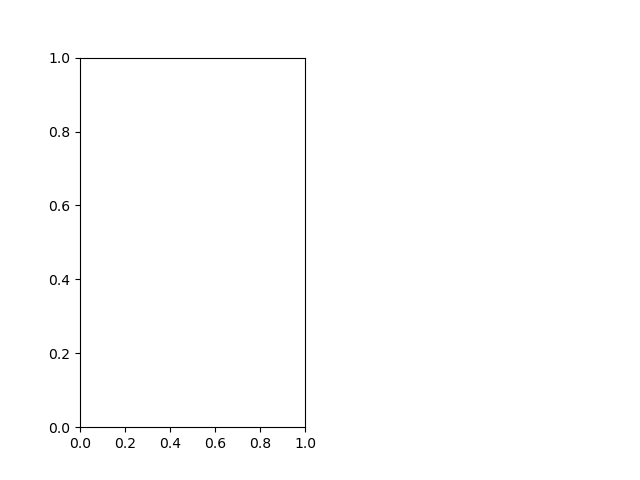

In [735]:
# farfield result visualization, skip for now

center = np.unravel_index(np.argmax(intensity_farfield), np.shape(intensity_farfield)) 
intensity_farfield_b3_24_18fov_rectangle_200nm = intensity_farfield.copy()
#print(np.shape(intensity_farfield_b3_36_18fov_trapezoid_inv))
if False: 
    intensity_farfield_control[center[0]-400 : center[0]+400, 
                          center[1]-50 : center[1]+50] = 0

plt.figure()
plt.subplot(121)
plt.imshow(np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV_inv)#.transpose()
           , 
           extent=[np.min(qx_ax), np.max(qx_ax), 
                   np.min(qy_ax), np.max(qy_ax)], vmin=-1, vmax=2    )
# plt.xlim([-0.05, 0.05])
#plt.ylim([-0.1, 1.0])
plt.xlabel('q [nm-1]'); plt.ylabel('q [nm-1]');
ax = plt.gca()
ax.set_aspect(1.0)
plt.colorbar()

plt.subplot(122)
plt.imshow(np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degx)#.transpose()
           , 
           #extent=[np.min(ax_ax), np.max(ax_ax), 
           #        np.min(ay_ax), np.max(ay_ax)], vmin=-1, vmax=2    
          )
# plt.xlim([-0.05, 0.05])
#plt.ylim([-0.1, 2.0])
plt.xlabel('Angle [deg]'); plt.ylabel('Angle [deg]');
ax = plt.gca()
ax.set_aspect(1.0)
plt.colorbar()

plt.tight_layout()


In [515]:
(np.arange(np.shape(intensity_farfield)[0]) - np.shape(intensity_farfield)[0]/2)

array([-1500., -1499., -1498., ...,  1497.,  1498.,  1499.])

In [104]:
P = np.shape(sample)[0]

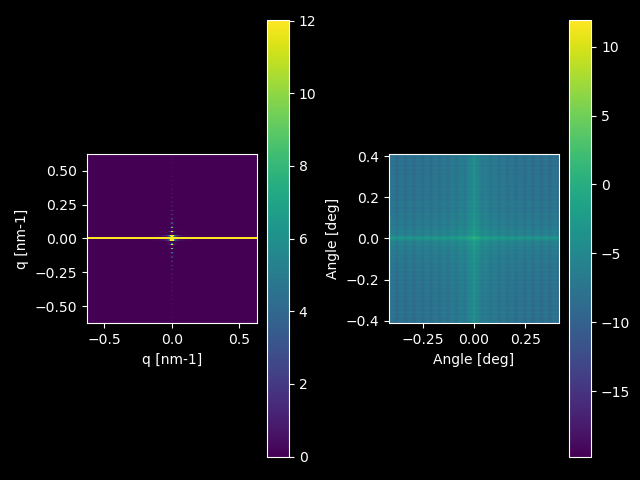

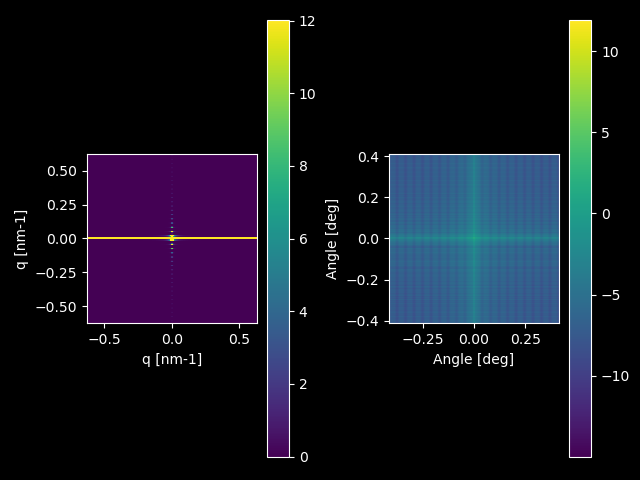

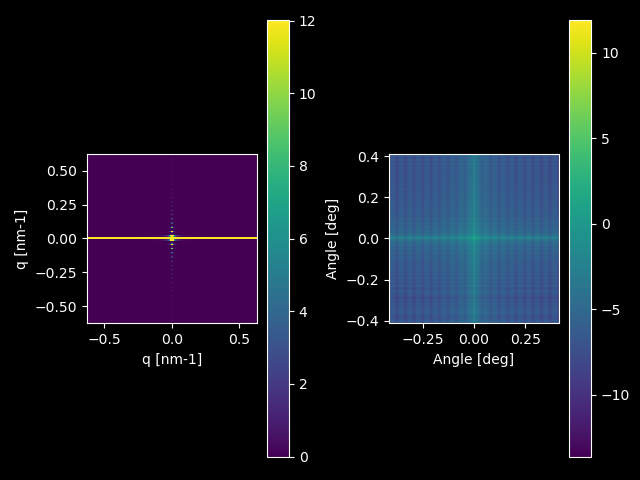

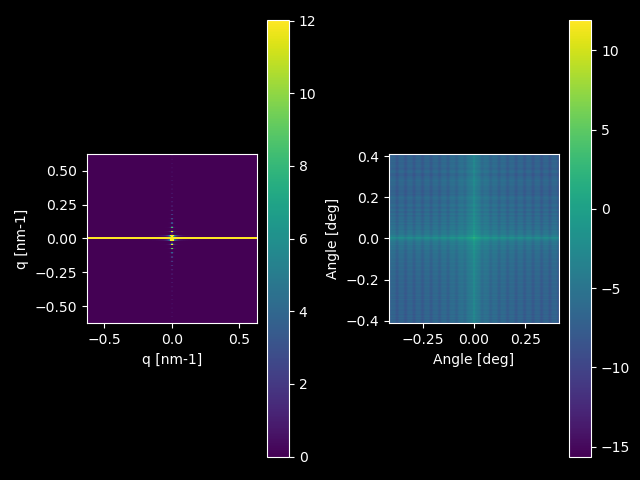

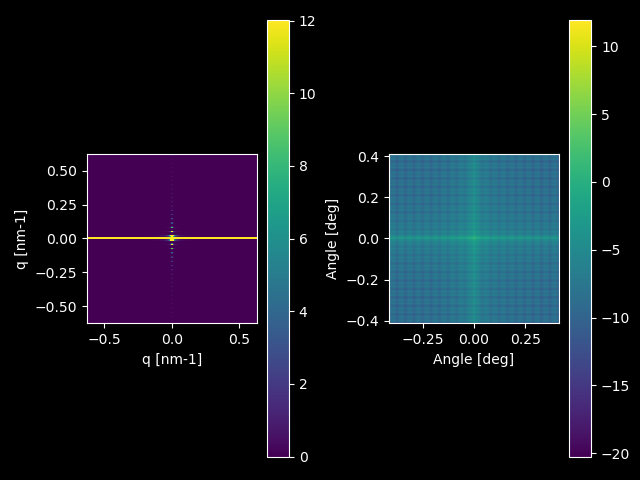

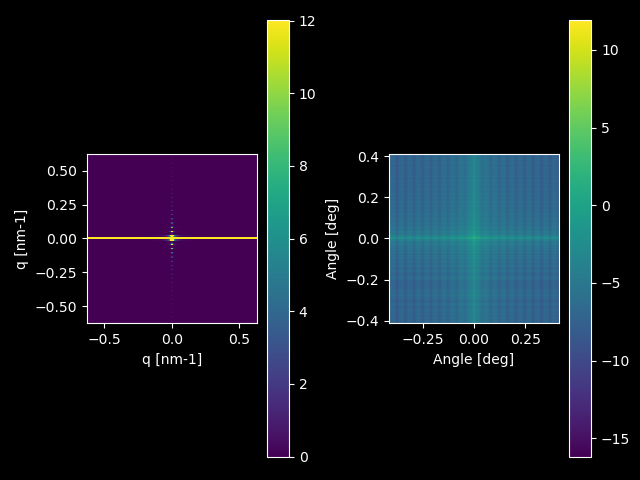

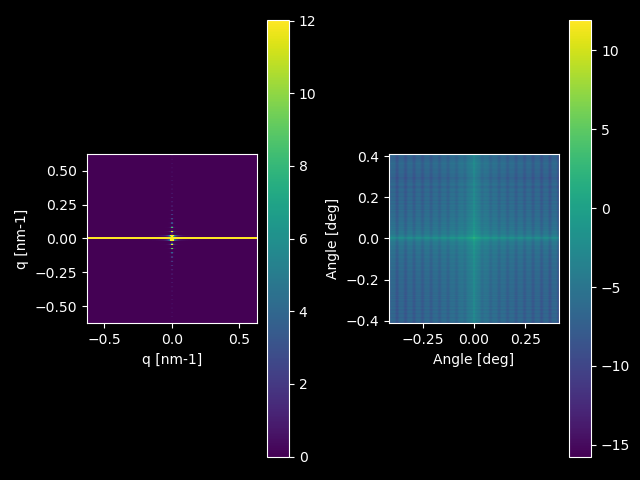

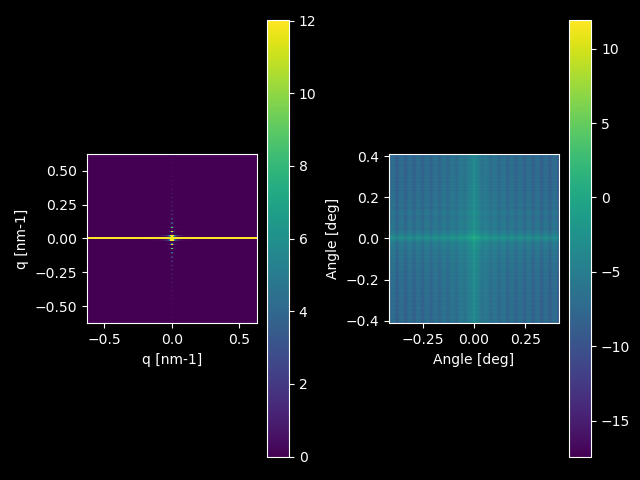

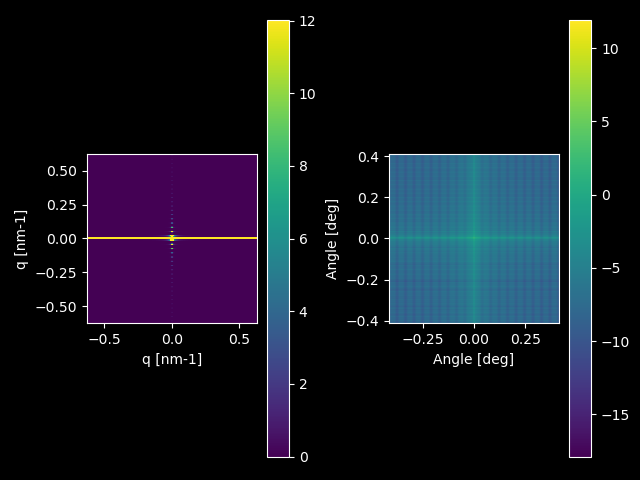

In [370]:
# farfield result visualization, skip for now (batch) -1.75 - 1.75 rectangular
plotname2_1_75 = []
for a,b,c in list(zip(farfield2,qang2,yang2)):
    center = np.unravel_index(np.argmax(a), np.shape(a)) 
    
    intensity_farfield_b3_24_18fov = a.copy()
    plotname2_1_75.append(intensity_farfield_b3_24_18fov)
    #print(np.shape(intensity_farfield_b3_36_18fov_trapezoid_inv))
    if False: 
        intensity_farfield_control[center[0]-400 : center[0]+400, 
                              center[1]-50 : center[1]+50] = 0
    
    plt.figure()
    plt.subplot(121)
    plt.imshow((intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(b), np.max(b), 
                       np.min(c), np.max(c)]  
              ,vmin = 0, vmax = 12)
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 1.0])
    plt.xlabel('q [nm-1]'); plt.ylabel('q [nm-1]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.subplot(122)
    plt.imshow(np.log10(intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(np.rad2deg(np.arctan(b / wave_vec))), np.max(np.rad2deg(np.arctan(b / wave_vec))), 
                       np.min(np.rad2deg(np.arctan(c / wave_vec))), np.max(np.rad2deg(np.arctan(c / wave_vec)))]   
              )
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 2.0])
    plt.xlabel('Angle [deg]'); plt.ylabel('Angle [deg]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.tight_layout()
    #plt.close()


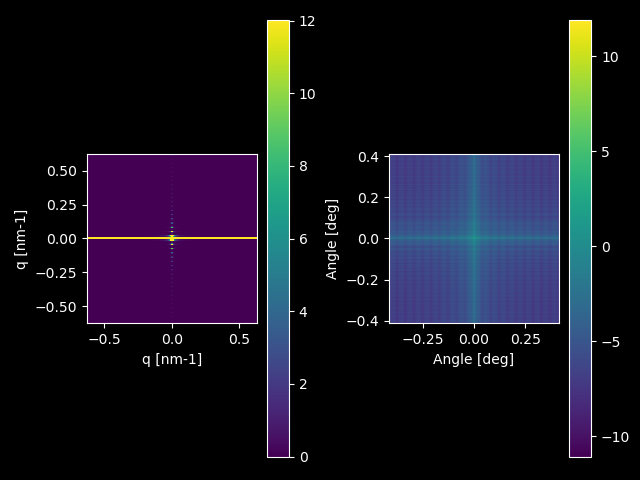

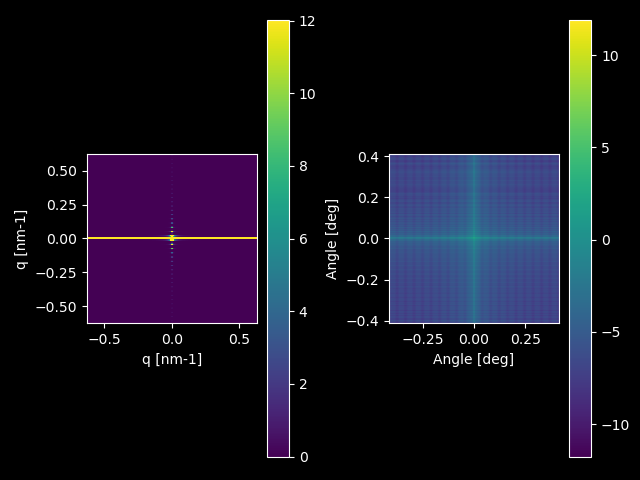

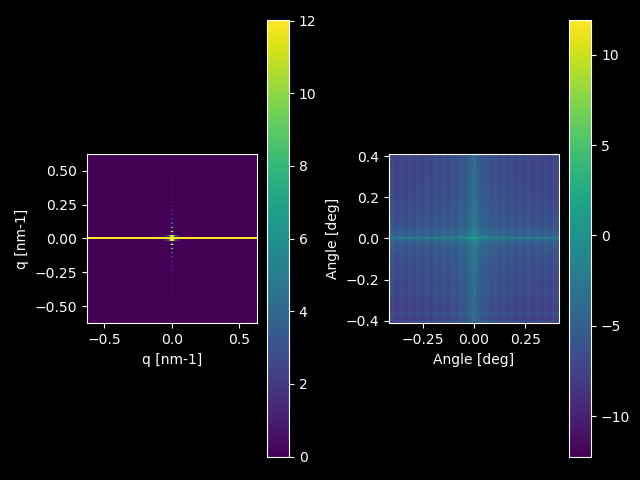

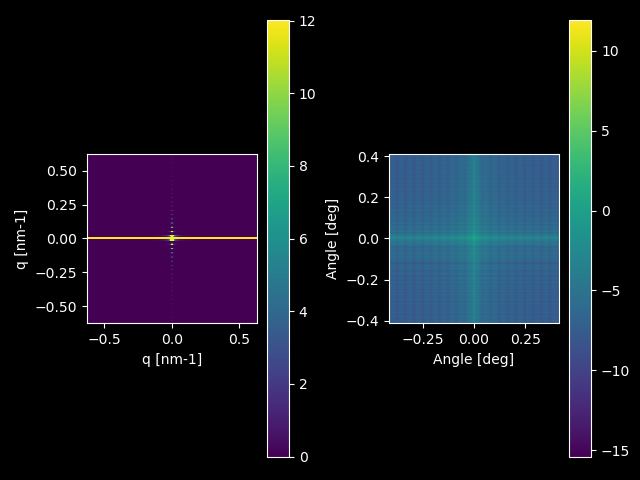

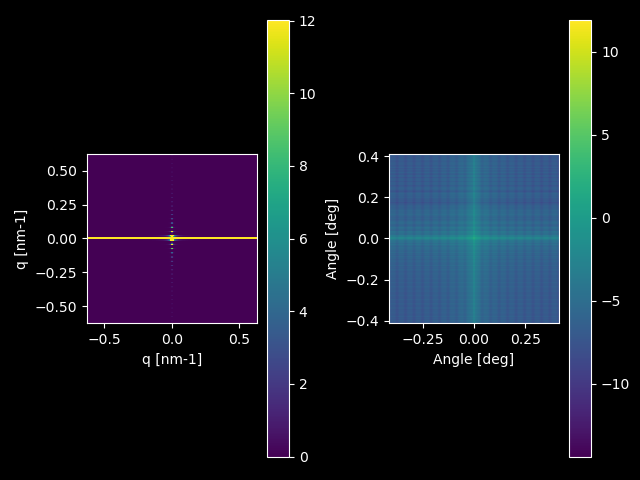

...

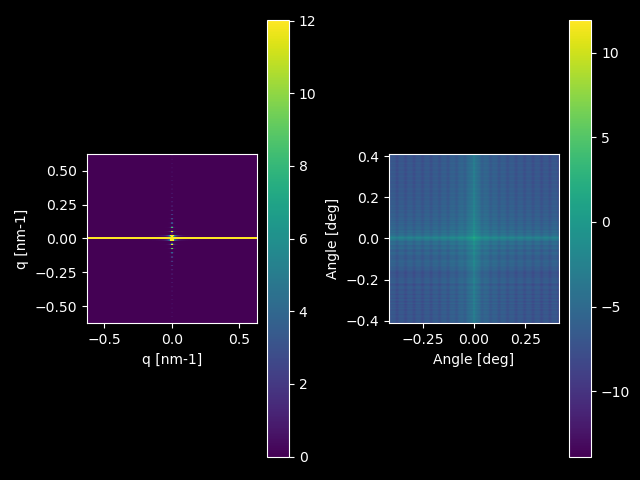

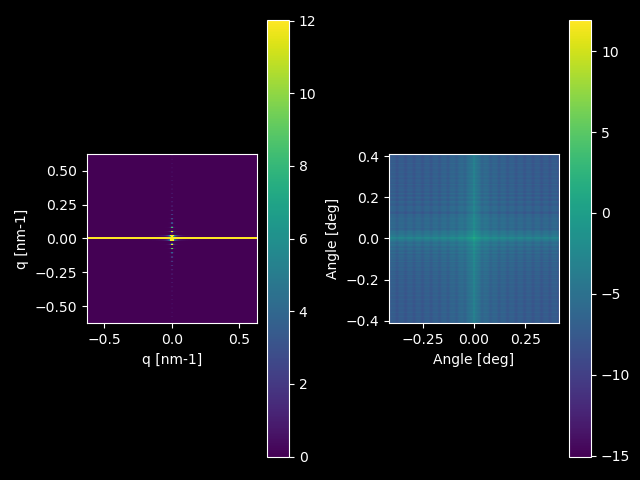

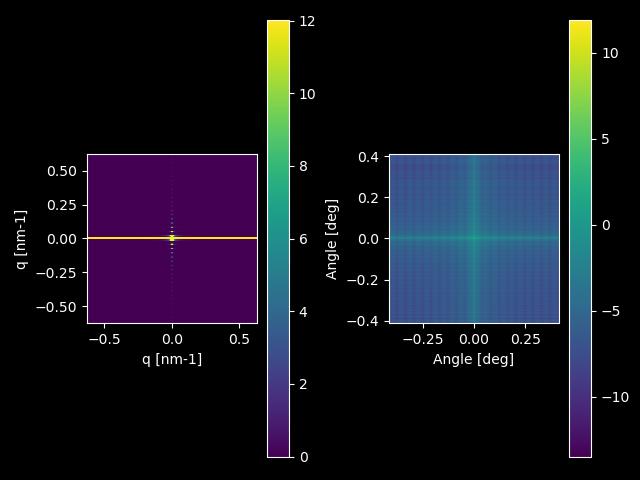

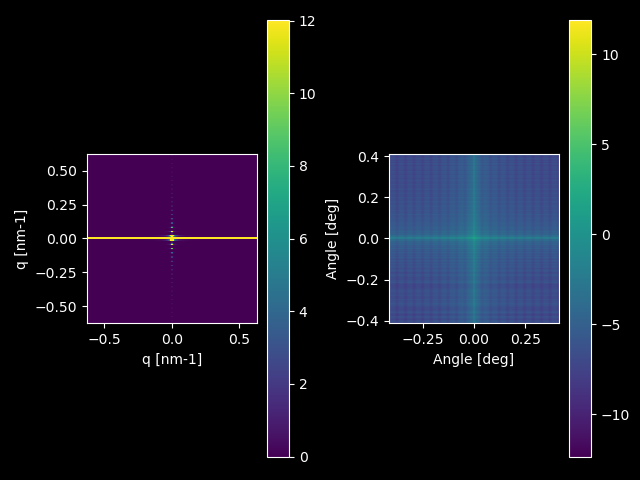

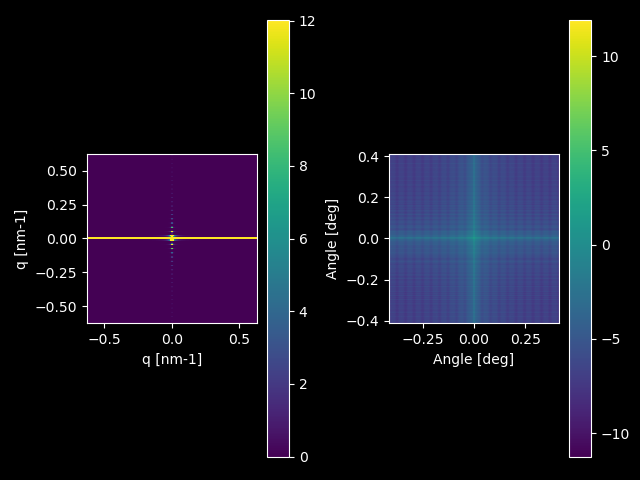

In [453]:
# farfield result visualization, skip for now (batch) -17.5 - 17.5 rectangular
plotname2_17_5 = []
for a,b,c in list(zip(farfield3,qang3,yang3)):
    center = np.unravel_index(np.argmax(a), np.shape(a)) 
    
    intensity_farfield_b3_24_18fov = a.copy()
    plotname2_17_5.append(intensity_farfield_b3_24_18fov)
    #print(np.shape(intensity_farfield_b3_36_18fov_trapezoid_inv))
    if False: 
        intensity_farfield_control[center[0]-400 : center[0]+400, 
                              center[1]-50 : center[1]+50] = 0
    
    plt.figure()
    plt.subplot(121)
    plt.imshow((intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(b), np.max(b), 
                       np.min(c), np.max(c)]  
              ,vmin = 0, vmax = 12)
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 1.0])
    plt.xlabel('q [nm-1]'); plt.ylabel('q [nm-1]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.subplot(122)
    plt.imshow(np.log10(intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(np.rad2deg(np.arctan(b / wave_vec))), np.max(np.rad2deg(np.arctan(b / wave_vec))), 
                       np.min(np.rad2deg(np.arctan(c / wave_vec))), np.max(np.rad2deg(np.arctan(c / wave_vec)))]   
              )
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 2.0])
    plt.xlabel('Angle [deg]'); plt.ylabel('Angle [deg]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.tight_layout()
    #plt.close()


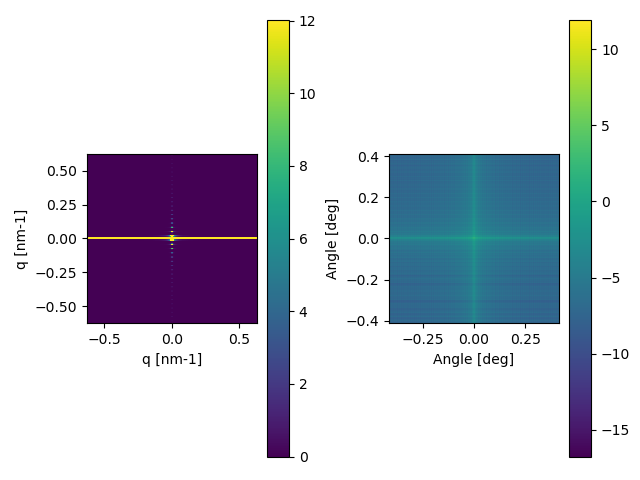

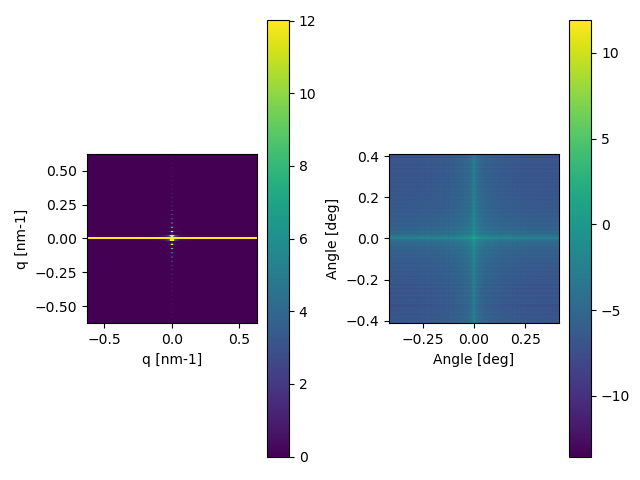

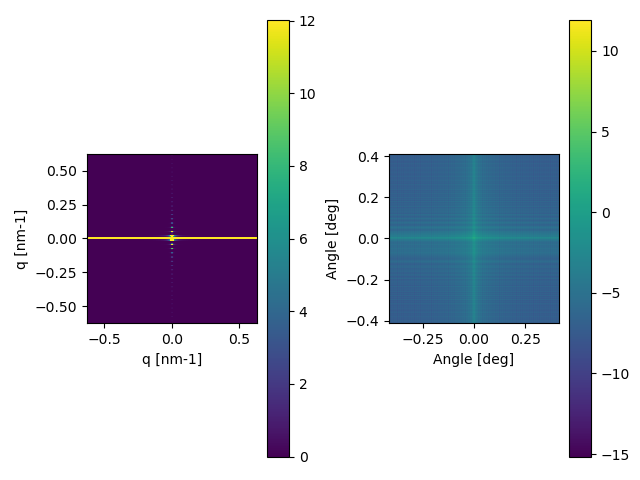

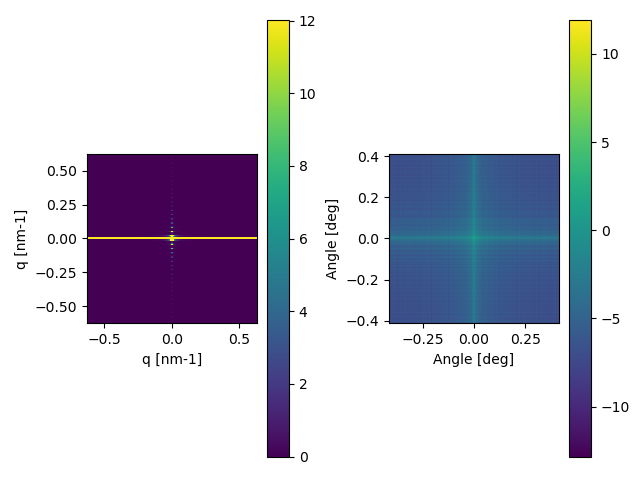

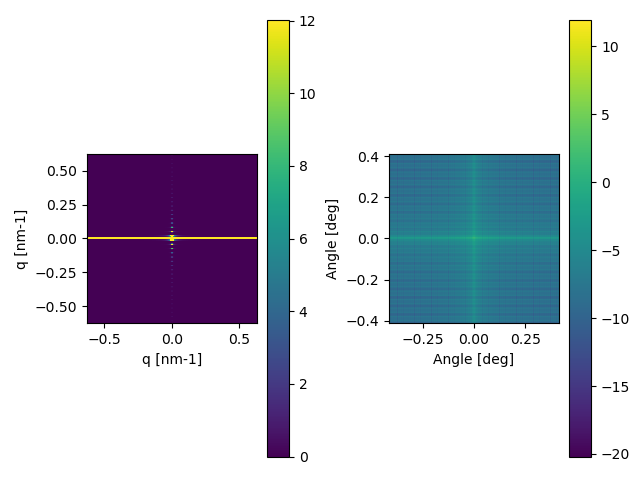

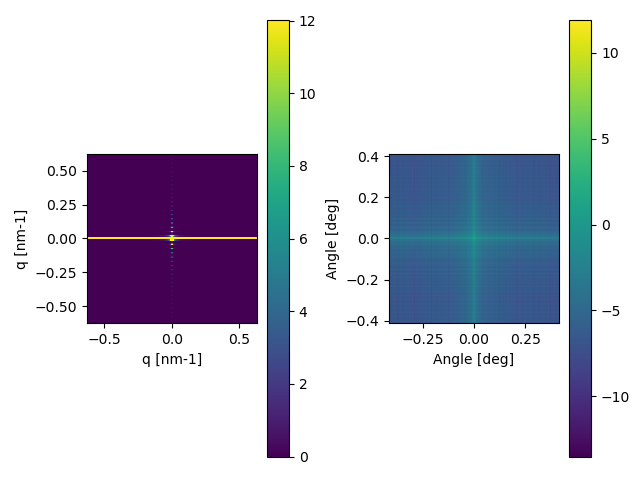

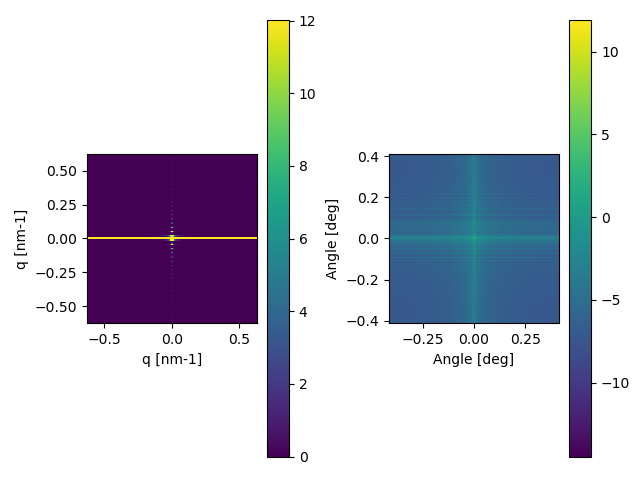

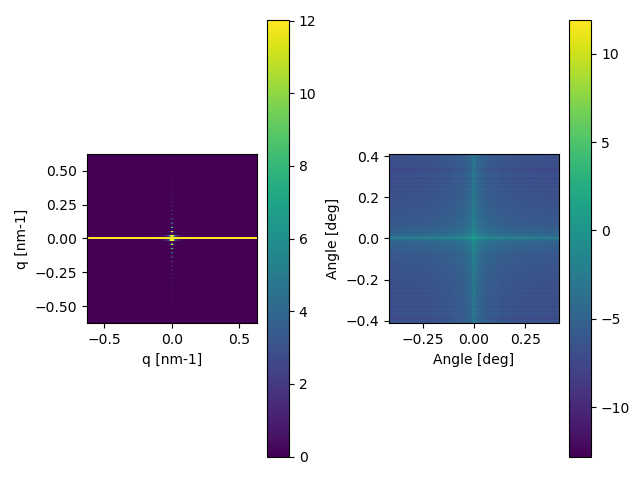

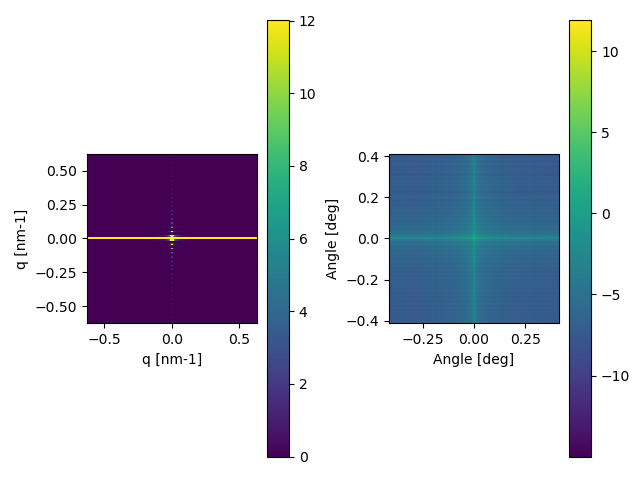

In [64]:
# farfield result visualization, skip for now (batch) -30 deg - 30 deg rectangular
plotname2_30 = []
for a,b,c in list(zip(farfield4,qang4,yang4)):
    center = np.unravel_index(np.argmax(a), np.shape(a)) 
    
    intensity_farfield_b3_24_18fov = a.copy()
    plotname2_30.append(intensity_farfield_b3_24_18fov)
    #print(np.shape(intensity_farfield_b3_36_18fov_trapezoid_inv))
    if False: 
        intensity_farfield_control[center[0]-400 : center[0]+400, 
                              center[1]-50 : center[1]+50] = 0
    
    plt.figure()
    plt.subplot(121)
    plt.imshow((intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(b), np.max(b), 
                       np.min(c), np.max(c)]  
              ,vmin = 0, vmax = 12)
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 1.0])
    plt.xlabel('q [nm-1]'); plt.ylabel('q [nm-1]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.subplot(122)
    plt.imshow(np.log10(intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(np.rad2deg(np.arctan(b / wave_vec))), np.max(np.rad2deg(np.arctan(b / wave_vec))), 
                       np.min(np.rad2deg(np.arctan(c / wave_vec))), np.max(np.rad2deg(np.arctan(c / wave_vec)))]   
              )
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 2.0])
    plt.xlabel('Angle [deg]'); plt.ylabel('Angle [deg]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.tight_layout()
    #plt.close()


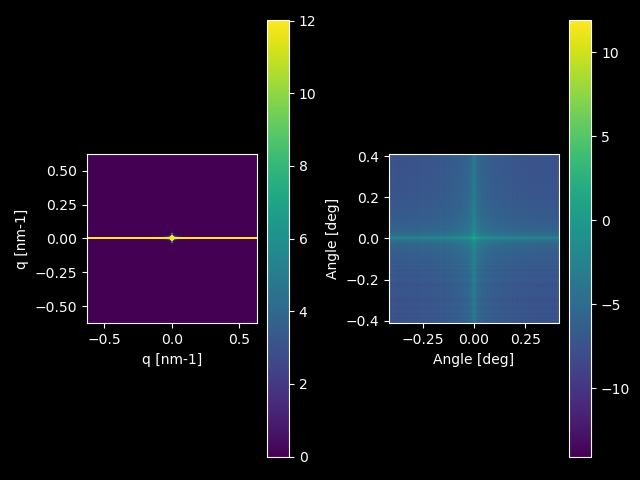

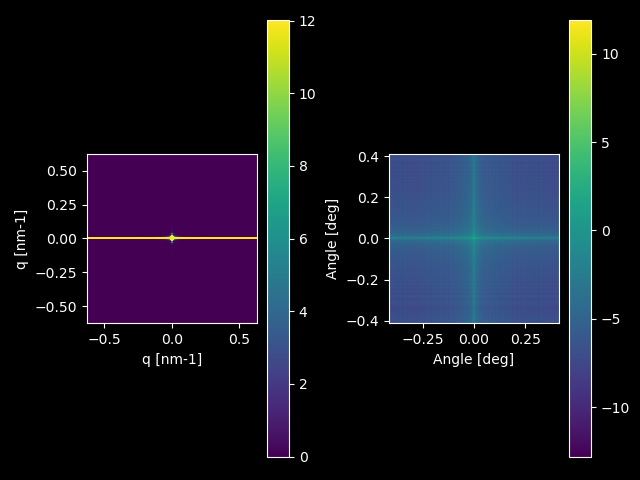

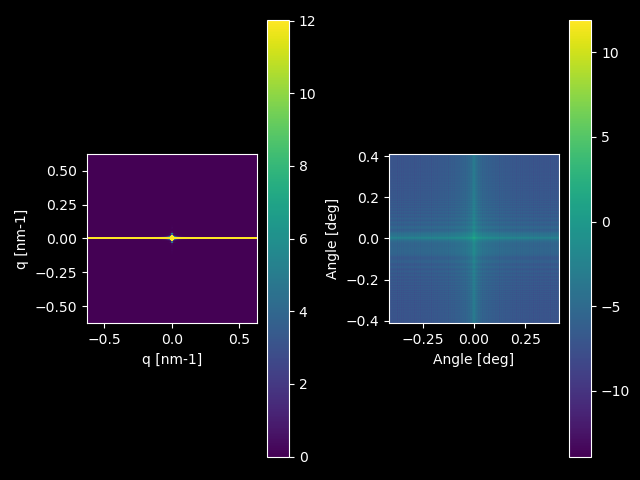

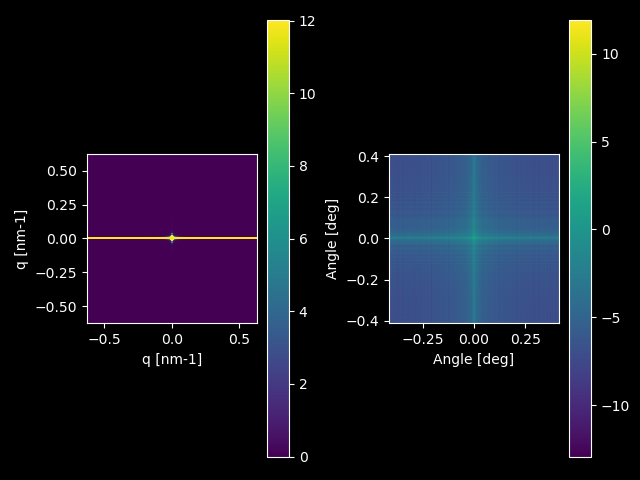

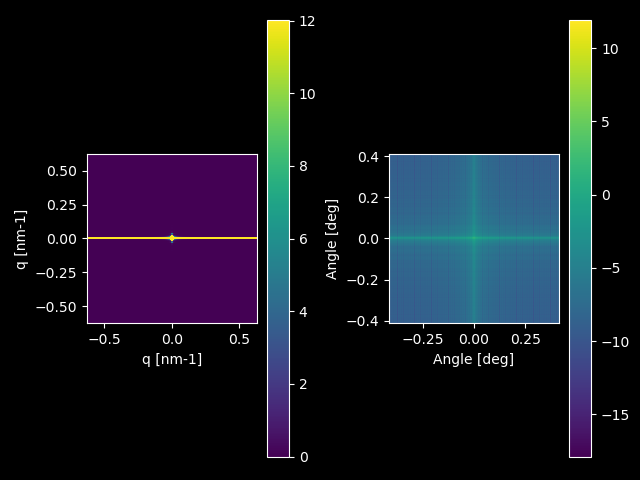

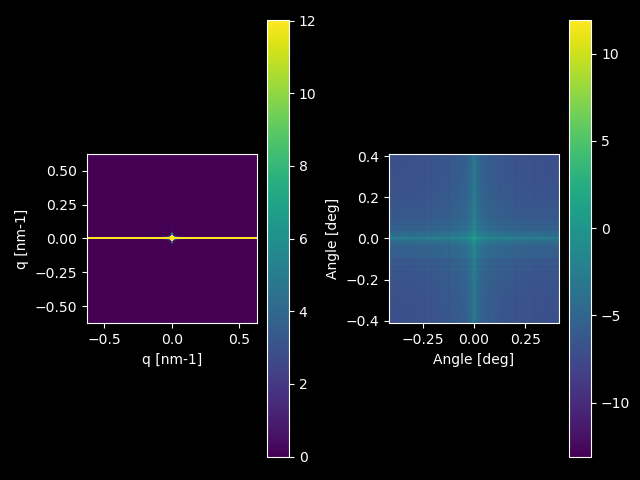

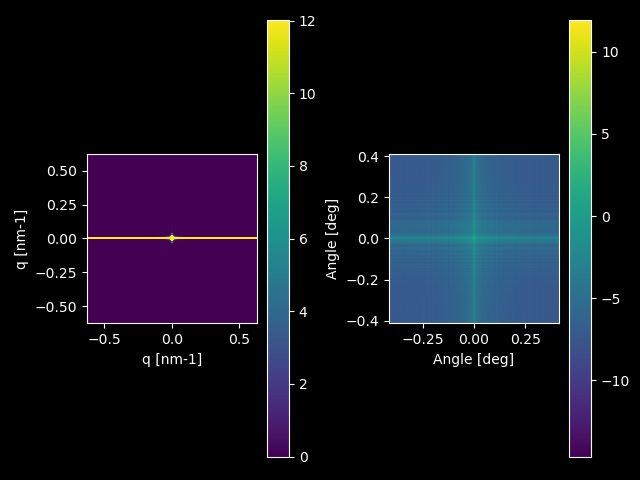

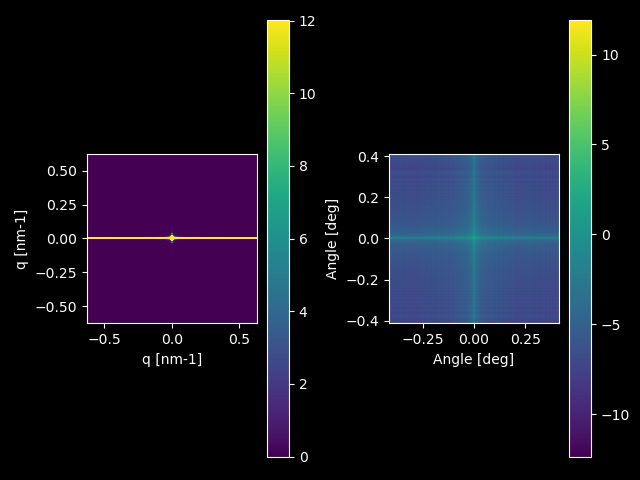

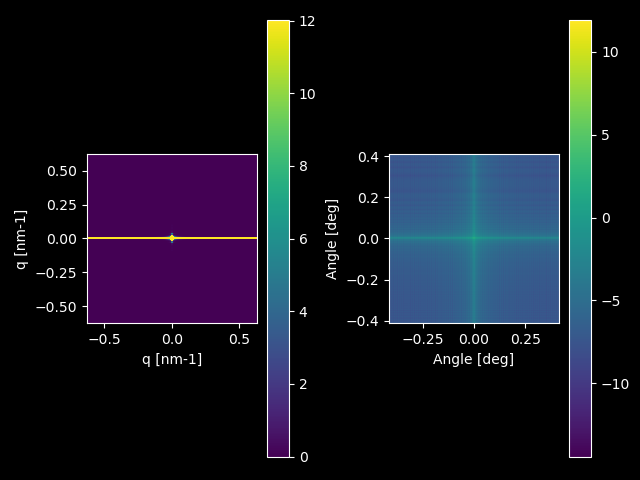

In [97]:
# farfield result visualization, skip for now (batch) -30 deg - 30 deg trapezoid
plotname2_30_trap = []
for a,b,c in list(zip(farfield5,qang5,yang5)):
    center = np.unravel_index(np.argmax(a), np.shape(a)) 
    
    intensity_farfield_b3_24_18fov = a.copy()
    plotname2_30_trap.append(intensity_farfield_b3_24_18fov)
    #print(np.shape(intensity_farfield_b3_36_18fov_trapezoid_inv))
    if False: 
        intensity_farfield_control[center[0]-400 : center[0]+400, 
                              center[1]-50 : center[1]+50] = 0
    
    plt.figure()
    plt.subplot(121)
    plt.imshow((intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(b), np.max(b), 
                       np.min(c), np.max(c)]  
              ,vmin = 0, vmax = 12)
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 1.0])
    plt.xlabel('q [nm-1]'); plt.ylabel('q [nm-1]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.subplot(122)
    plt.imshow(np.log10(intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(np.rad2deg(np.arctan(b / wave_vec))), np.max(np.rad2deg(np.arctan(b / wave_vec))), 
                       np.min(np.rad2deg(np.arctan(c / wave_vec))), np.max(np.rad2deg(np.arctan(c / wave_vec)))]   
              )
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 2.0])
    plt.xlabel('Angle [deg]'); plt.ylabel('Angle [deg]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.tight_layout()
    #plt.close()


MovieWriter ffmpeg unavailable; using Pillow instead.


IndexError: list index out of range

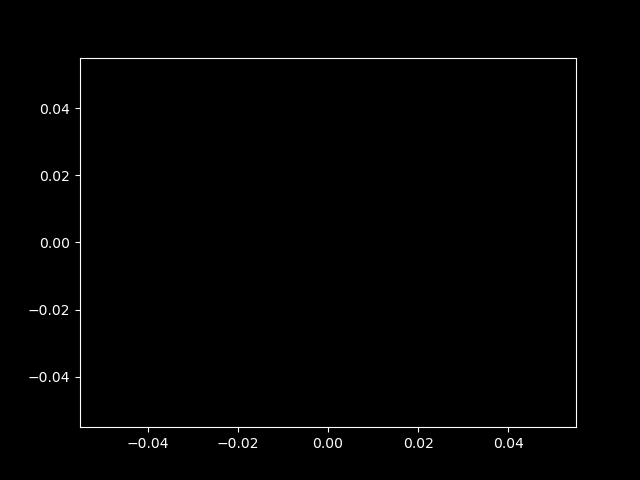

In [144]:
animfig = plt.figure()
count = 0
order1 = []
#for a,b in zip(yang,plotname2):
def building(i):
    a = yang[i]
    b = plotname2[i]
    maxi = np.argmax(plotname2[i],axis = 0)[1]
    #print(yang)
    test.set(a,np.log10(b)[5000,:])
    #ani = plt.plot(a,np.log10(b)[5000,:],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
    count += 1
    order1.append([ani,])

test = plt.plot([],[],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
#ani = plt.plot(a,np.log10(b)[5000,:],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))

out1d_anim2 = anim.FuncAnimation(animfig,building,frames = len(plotname2))
out1d_anim2.save('test.mp4')

In [137]:
order1[1]

[[<matplotlib.lines.Line2D at 0x1511facc6b10>]]

In [131]:
len(order1)

14

In [54]:
np.save('output0_1_trapezoid_1_1_400nm.npy',plotname2) #-0.1 - 0.1 - 20 intervals - rectangle

In [418]:
np.save('output_1_11_rectangle_1_1_400nm.npy',plotname2)

In [115]:
out_rec_1_7_400 = plotname2

In [112]:
np.save('output0_1_trapezoid_1_1_400nm_farfield.npy',[np.r_[x[(int(x.shape[0]/2) - 100):(int(x.shape[0]/2)+100),:]] for x in farfield2])

In [111]:
farfield2[0].shape[0]/2

5000.0

In [110]:
[np.r_[farfield2[0][(farfield2[0].shape[0]/2):6000,:]]]

TypeError: slice indices must be integers or None or have an __index__ method

In [ ]:
np.save('output_0_1_20.npy',plotname2) #-0.1 - 0.1 - 20 intervals

In [55]:
np.save('qang_0_1_20_trapezoid_1_1_400nm.npy',qang2)

In [414]:
np.save('qang_1_11_rectangle_1_1_400nm.npy',qang2)

In [415]:
qang1_11_400nm_rec = qang2 #qang - -1-1,11points,400nm,rectangle

In [56]:
np.save('yang_0_1_20_trapezoid_1_1_400nm.npy',yang2)

In [417]:
np.save('yang_1_11_rectangle_1_1_400nm.npy',yang2)

In [416]:
yang1_11_400nm_rec = yang2

In [273]:
plotimport = np.load(open('output0_1_rectangle_1_1_400nm.npy','rb'))

In [145]:
check[0].max()

NameError: name 'check' is not defined

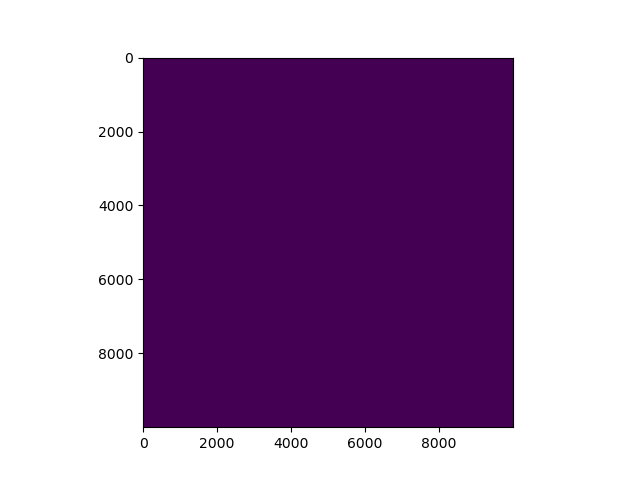

In [443]:
ax11 = plt.figure().add_subplot()
plt.imshow(check[10].reshape(plotname2[0].shape[0],plotname2[0].shape[1]))
plt.show()

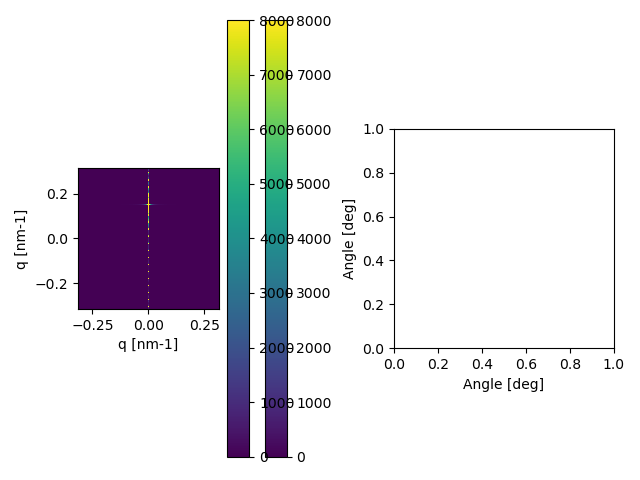

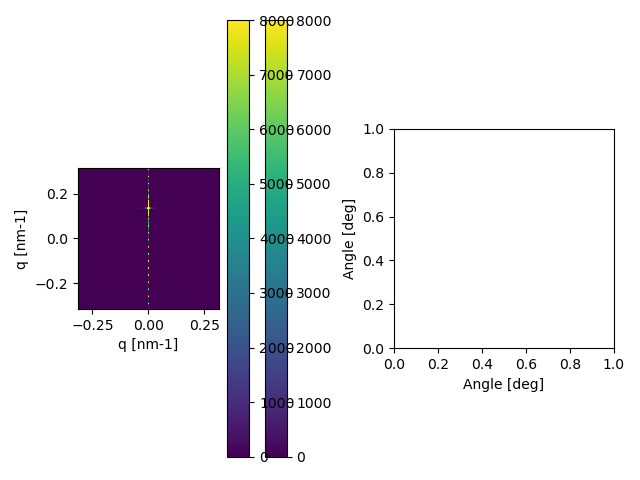

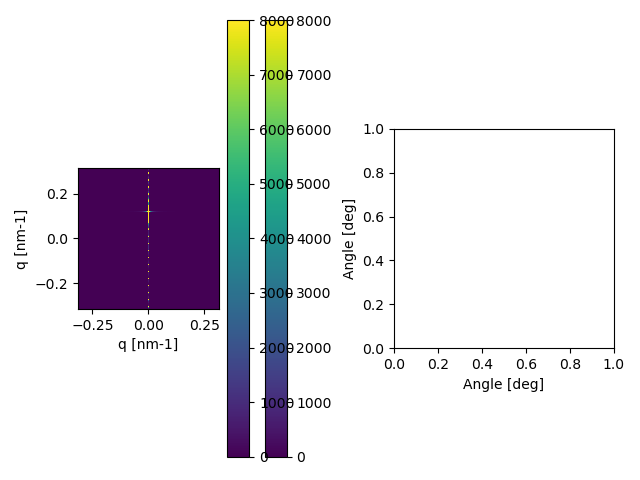

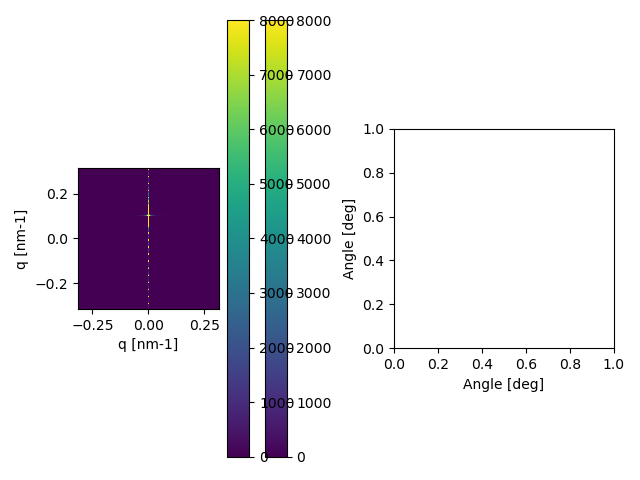

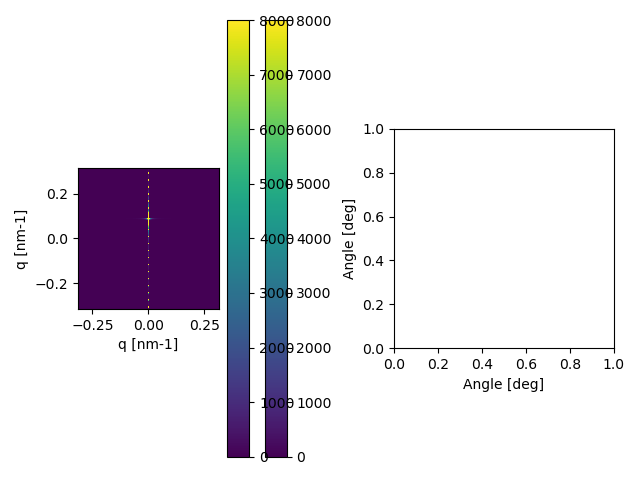

...

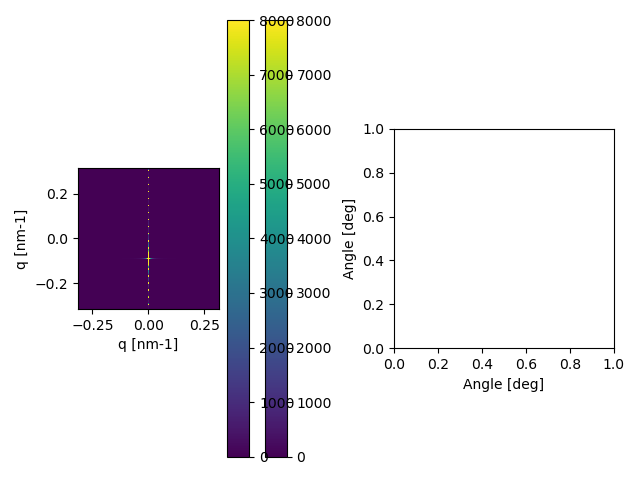

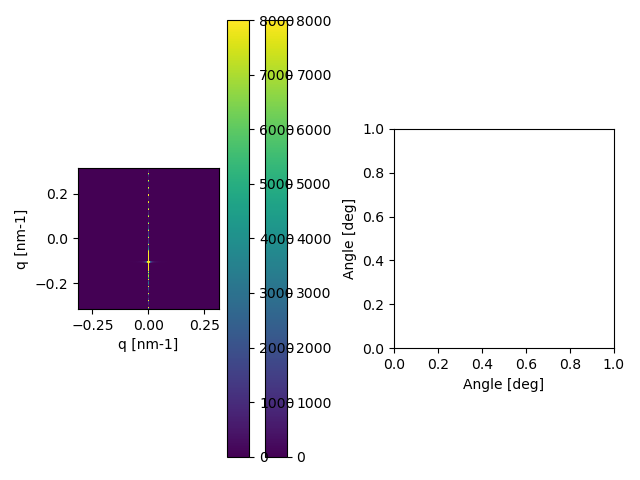

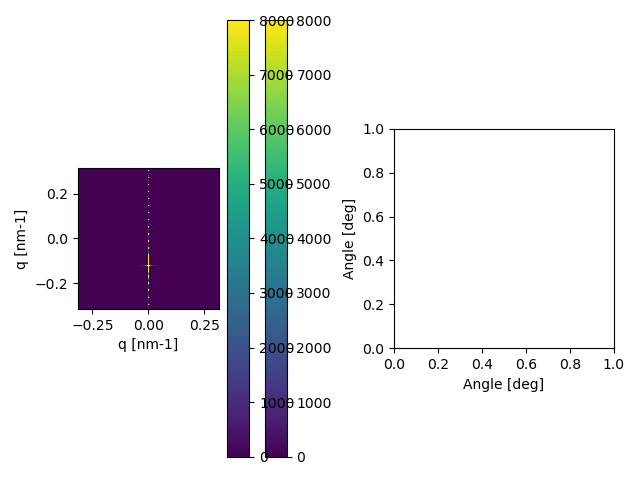

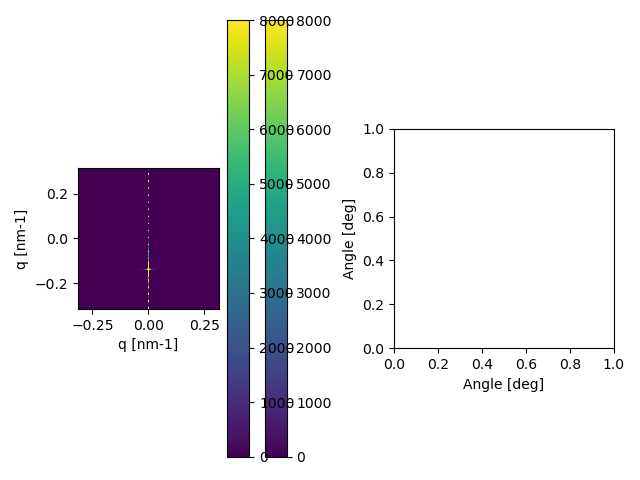

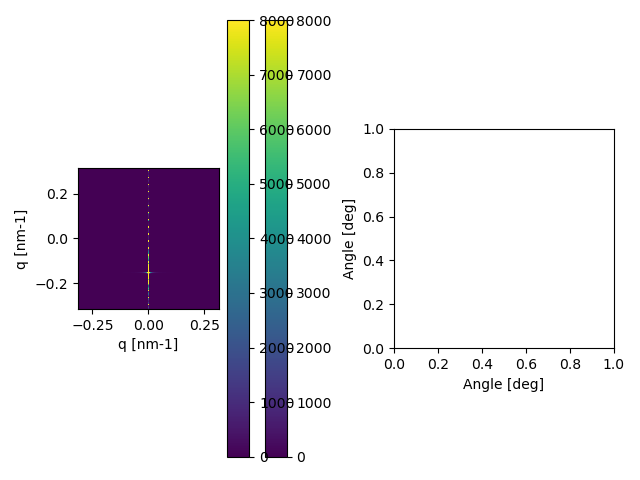

In [274]:
# farfield result visualization, skip for now (batch)
#plotname2 = []
for a,b,c in list(zip(plotimport,qang,yang)):
    center = np.unravel_index(np.argmax(a), np.shape(a)) 
    
    intensity_farfield_b3_24_18fov = a.copy()
    #plotname2.append(intensity_farfield_b3_24_18fov)
    #print(np.shape(intensity_farfield_b3_36_18fov_trapezoid_inv))
    if False: 
        intensity_farfield_control[center[0]-400 : center[0]+400, 
                              center[1]-50 : center[1]+50] = 0
    
    plt.figure()
    plt.subplot(121)
    plt.imshow((intensity_farfield_b3_24_18fov).transpose()
               , 
               extent=[np.min(b), np.max(b), 
                       np.min(c), np.max(c)]  
              ,vmin = 0, vmax = 8000)
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 1.0])
    plt.xlabel('q [nm-1]'); plt.ylabel('q [nm-1]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.subplot(122)
    #plt.imshow(np.log10(intensity_farfield_b3_24_18fov).transpose()
    #           , 
    #           extent=[np.min(np.rad2deg(np.arctan(b / wave_vec))), np.max(np.rad2deg(np.arctan(b / wave_vec))), 
    #                   np.min(np.rad2deg(np.arctan(c / wave_vec))), np.max(np.rad2deg(np.arctan(c / wave_vec)))]   
    #          )
    # plt.xlim([-0.05, 0.05])
    #plt.ylim([-0.1, 2.0])
    plt.xlabel('Angle [deg]'); plt.ylabel('Angle [deg]');
    ax = plt.gca()
    ax.set_aspect(1.0)
    plt.colorbar()
    
    plt.tight_layout()
    #plt.close()


[-0.1]
9
[Text(-0.65, 0, '−0.65'), Text(-0.52, 0, '−0.52'), Text(-0.39, 0, '−0.39'), Text(-0.26, 0, '−0.26'), Text(-0.13, 0, '−0.13'), Text(0.0, 0, '0.00'), Text(0.13, 0, '0.13'), Text(0.26, 0, '0.26'), Text(0.39, 0, '0.39'), Text(0.5199999999999999, 0, '0.52'), Text(0.65, 0, '0.65')]
[Text(0, -0.75, '−0.75'), Text(0, -0.5, '−0.50'), Text(0, -0.25, '−0.25'), Text(0, 0.0, '0.00'), Text(0, 0.25, '0.25'), Text(0, 0.5, '0.50'), Text(0, 0.75, '0.75')]


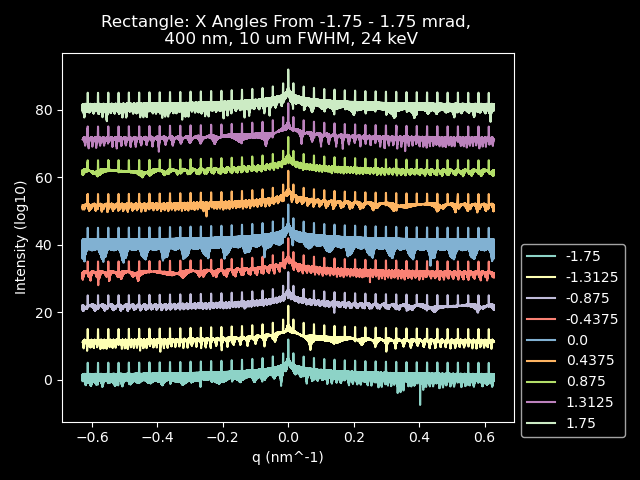

In [343]:
ax_anim = plt.figure().add_subplot()
print(np.arange(-0.1,0.1,20))
count = 0
order1 = []
for a,b in zip(yang,plotname2):
    maxi = np.argmax(b,axis = 0)[1]
    #order1.append(a[maxi])
    #print(yang)
    plt.plot(a,np.log10(b)[5000,:] + count*10,label = str(np.round(x_ang[count],2)*1.75))
    #ani = plt.plot(a,np.log10(b)[5000,:],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
    count += 1
    order1.append(ani)
print(count)
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5) #Use this
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_8_18fov[1500,:]),label = '200 nm',alpha = 1)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_16_18fov[1500,:]),label = '400 nm',alpha = 0.3)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1[1500,:]),label = '1 keV',alpha = 0.9)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_8[1500,:]),label = '1.8 keV',alpha = 0.7)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_9[1500,:]),label = '1.9 keV',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_xy_0_5[1150,:]),label = '1:3 - both X and Y rotated 0.5 deg',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rectangle_1_1_25z_14_7keV_8px[1000,:]),label = '1:1 control',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rect_cross_5px[1500,:]),label = 'Trapezoid - Rectangular Cross-section',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_0_5degx[750,:]),label = '1:1 trapezoid slope 1 0.5 deg x',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_0_5y[1000,:]),label = '1:1 trapezoid slope 1 0.5 deg y',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z[1000,:]),label = '1:1 trapezoid slope 1 5 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_9keV[1000,:])+20,label = '1:1 trapezoid slope 1 1.9 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_8keV[1000,:])+10,label = '1:1 trapezoid slope 1 1.8 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV[1000,:]),label = '1:1 trapezoid slope 1 25 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degxy[200,:])+20,label = '1:1 trapezoid 5 px z 0.5 deg xy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degx[200,:])+30,label = '1:1 trapezoid 5 px z 0.5 degx',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degy[1000,:])+20,label = '1:1 trapezoid 5 px z 0.5 degy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV[1000,:]) + 10,label = '1:1 trapezoid 5 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV_inv[1000,:]),label = '1:1 trapezoid slope 1 Inverted',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_alt[1500,:]),label = '1:1 trapezoid slope 1 calculated',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3_extend[1500,:]),label = '1:1 trapezoid slope 3 taller',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3[1500,:]),label = '1:1 trapezoid slope 3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_inv[1500,:]),label = '1:1 trapezoid inv',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:])+10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov[1500,:])+20,label = '1:3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_5[1500,:])+30,label = '1:5',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_1[1500,:]) + 10,label = '1:1',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:]) + 10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_32_18fov[1500,:]),label = '800 nm',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_40_18fov[1500,:]),label = '1000 nm',alpha = 0.3)
#plt.plot(yang2[6],np.log10(plotname2[6][5000,:]),label = '5 deg x-axis',alpha = 1)
#plt.plot(yang2[6],np.log10(plotnameori[6][5000,:]),label = '5 deg y-axis',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_5degy[:,500]),label = '5 deg y-axis',alpha = 0.5)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_40[:,500])+120,label = '1000 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_48[:,500])+150,label = '1200 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5)
xlabs = ax.get_xticklabels()
ylabs = ax.get_yticklabels()
print(xlabs)
print(ylabs)
#labx = np.round(yang,2)
#laby = np.round(np.linspace(-(temp.shape[1])*wave_grid_step[1]/2 - (temp.shape[1])*wave_grid_step[1]/(len(xlabs)-2), (temp.shape[1])*wave_grid_step[1]/2,len(xlabs)),1)
#ax.set_xticks(labx)
#ax.set_yticklabels(laby)
plt.ylabel('Intensity (log10)')
plt.xlabel('q (nm^-1)')
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.13))
plt.legend(bbox_to_anchor = (1.0,0.5))
plt.title('Rectangle: X Angles From -1.75 - 1.75 mrad, \n 400 nm, 10 um FWHM, 24 keV')
plt.tight_layout()
plt.show()

[-0.1]
15
[Text(-0.52, 0, '−0.52'), Text(-0.39, 0, '−0.39'), Text(-0.26, 0, '−0.26'), Text(-0.13, 0, '−0.13'), Text(0.0, 0, '0.00'), Text(0.13, 0, '0.13'), Text(0.26, 0, '0.26'), Text(0.39, 0, '0.39'), Text(0.52, 0, '0.52')]
[Text(0, -0.6000000000000001, '−0.6'), Text(0, -0.4000000000000001, '−0.4'), Text(0, -0.20000000000000007, '−0.2'), Text(0, 0.0, '0.0'), Text(0, 0.19999999999999996, '0.2'), Text(0, 0.3999999999999999, '0.4'), Text(0, 0.6000000000000001, '0.6')]


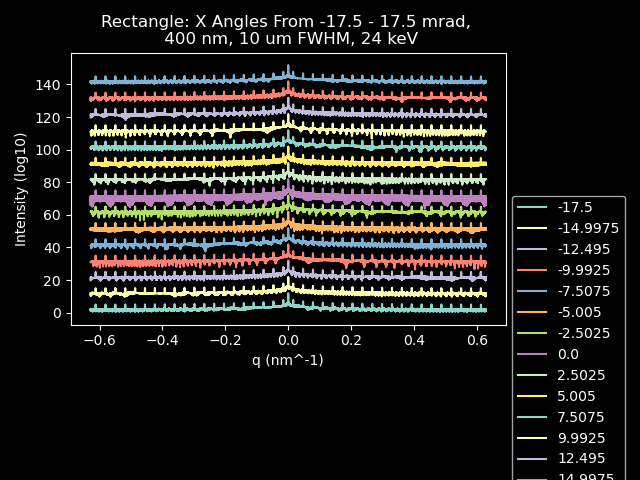

In [493]:
ax_anim_1 = plt.figure().add_subplot()
print(np.arange(-0.1,0.1,20))
count = 0
order2 = []
x_ang_17 = np.linspace(-10,10,15)
for a,b in zip(yang3,plotname2_17_5):
    maxi = np.argmax(b,axis = 0)[1]
    #order1.append(a[maxi])
    #print(yang)
    plt.plot(a,np.log10(b)[5000,:] + count*10,label = str(np.round(x_ang_17[count],2)*1.75))
    #ani = plt.plot(a,np.log10(b)[5000,:],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
    count += 1
    #order2.append(ani)
print(count)
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5) #Use this
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_8_18fov[1500,:]),label = '200 nm',alpha = 1)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_16_18fov[1500,:]),label = '400 nm',alpha = 0.3)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1[1500,:]),label = '1 keV',alpha = 0.9)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_8[1500,:]),label = '1.8 keV',alpha = 0.7)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_9[1500,:]),label = '1.9 keV',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_xy_0_5[1150,:]),label = '1:3 - both X and Y rotated 0.5 deg',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rectangle_1_1_25z_14_7keV_8px[1000,:]),label = '1:1 control',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rect_cross_5px[1500,:]),label = 'Trapezoid - Rectangular Cross-section',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_0_5degx[750,:]),label = '1:1 trapezoid slope 1 0.5 deg x',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_0_5y[1000,:]),label = '1:1 trapezoid slope 1 0.5 deg y',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z[1000,:]),label = '1:1 trapezoid slope 1 5 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_9keV[1000,:])+20,label = '1:1 trapezoid slope 1 1.9 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_8keV[1000,:])+10,label = '1:1 trapezoid slope 1 1.8 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV[1000,:]),label = '1:1 trapezoid slope 1 25 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degxy[200,:])+20,label = '1:1 trapezoid 5 px z 0.5 deg xy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degx[200,:])+30,label = '1:1 trapezoid 5 px z 0.5 degx',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degy[1000,:])+20,label = '1:1 trapezoid 5 px z 0.5 degy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV[1000,:]) + 10,label = '1:1 trapezoid 5 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV_inv[1000,:]),label = '1:1 trapezoid slope 1 Inverted',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_alt[1500,:]),label = '1:1 trapezoid slope 1 calculated',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3_extend[1500,:]),label = '1:1 trapezoid slope 3 taller',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3[1500,:]),label = '1:1 trapezoid slope 3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_inv[1500,:]),label = '1:1 trapezoid inv',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:])+10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov[1500,:])+20,label = '1:3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_5[1500,:])+30,label = '1:5',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_1[1500,:]) + 10,label = '1:1',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:]) + 10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_32_18fov[1500,:]),label = '800 nm',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_40_18fov[1500,:]),label = '1000 nm',alpha = 0.3)
#plt.plot(yang2[6],np.log10(plotname2[6][5000,:]),label = '5 deg x-axis',alpha = 1)
#plt.plot(yang2[6],np.log10(plotnameori[6][5000,:]),label = '5 deg y-axis',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_5degy[:,500]),label = '5 deg y-axis',alpha = 0.5)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_40[:,500])+120,label = '1000 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_48[:,500])+150,label = '1200 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5)
xlabs = ax.get_xticklabels()
ylabs = ax.get_yticklabels()
print(xlabs)
print(ylabs)
#labx = np.round(yang,2)
#laby = np.round(np.linspace(-(temp.shape[1])*wave_grid_step[1]/2 - (temp.shape[1])*wave_grid_step[1]/(len(xlabs)-2), (temp.shape[1])*wave_grid_step[1]/2,len(xlabs)),1)
#ax.set_xticks(labx)
#ax.set_yticklabels(laby)
plt.ylabel('Intensity (log10)')
plt.xlabel('q (nm^-1)')
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.13))
plt.legend(bbox_to_anchor = (1.0,0.5))
plt.title('Rectangle: X Angles From -17.5 - 17.5 mrad, \n 400 nm, 10 um FWHM, 24 keV') #Actually 17.2 keV
plt.tight_layout()
plt.show()

[-0.1]
9
[Text(-0.5, 0, '−0.50'), Text(-0.25, 0, '−0.25'), Text(0.0, 0, '0.00'), Text(0.25, 0, '0.25'), Text(0.5, 0, '0.50')]
[Text(0, -0.6000000000000001, '−0.6'), Text(0, -0.4000000000000001, '−0.4'), Text(0, -0.20000000000000007, '−0.2'), Text(0, 0.0, '0.0'), Text(0, 0.19999999999999996, '0.2'), Text(0, 0.3999999999999999, '0.4'), Text(0, 0.6000000000000001, '0.6')]


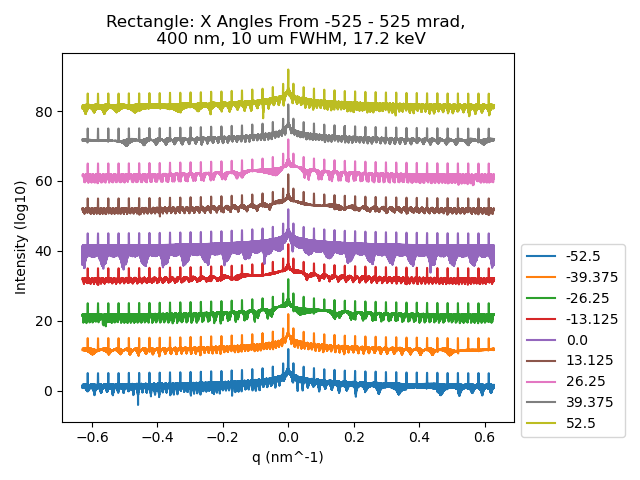

In [65]:
ax_anim_2 = plt.figure().add_subplot()
print(np.arange(-0.1,0.1,20))
count = 0
order2 = []
#x_ang_17 = np.linspace(-10,10,15)
for a,b in zip(yang4,plotname2_30):
    maxi = np.argmax(b,axis = 0)[1]
    #order1.append(a[maxi])
    #print(yang)
    plt.plot(a,np.log10(b)[5000,:] + count*10,label = str(np.round(x_ang[count],2)*1.75))
    #ani = plt.plot(a,np.log10(b)[5000,:],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
    count += 1
    #order2.append(ani)
print(count)
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5) #Use this
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_8_18fov[1500,:]),label = '200 nm',alpha = 1)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_16_18fov[1500,:]),label = '400 nm',alpha = 0.3)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1[1500,:]),label = '1 keV',alpha = 0.9)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_8[1500,:]),label = '1.8 keV',alpha = 0.7)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_9[1500,:]),label = '1.9 keV',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_xy_0_5[1150,:]),label = '1:3 - both X and Y rotated 0.5 deg',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rectangle_1_1_25z_14_7keV_8px[1000,:]),label = '1:1 control',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rect_cross_5px[1500,:]),label = 'Trapezoid - Rectangular Cross-section',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_0_5degx[750,:]),label = '1:1 trapezoid slope 1 0.5 deg x',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_0_5y[1000,:]),label = '1:1 trapezoid slope 1 0.5 deg y',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z[1000,:]),label = '1:1 trapezoid slope 1 5 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_9keV[1000,:])+20,label = '1:1 trapezoid slope 1 1.9 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_8keV[1000,:])+10,label = '1:1 trapezoid slope 1 1.8 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV[1000,:]),label = '1:1 trapezoid slope 1 25 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degxy[200,:])+20,label = '1:1 trapezoid 5 px z 0.5 deg xy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degx[200,:])+30,label = '1:1 trapezoid 5 px z 0.5 degx',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degy[1000,:])+20,label = '1:1 trapezoid 5 px z 0.5 degy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV[1000,:]) + 10,label = '1:1 trapezoid 5 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV_inv[1000,:]),label = '1:1 trapezoid slope 1 Inverted',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_alt[1500,:]),label = '1:1 trapezoid slope 1 calculated',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3_extend[1500,:]),label = '1:1 trapezoid slope 3 taller',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3[1500,:]),label = '1:1 trapezoid slope 3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_inv[1500,:]),label = '1:1 trapezoid inv',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:])+10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov[1500,:])+20,label = '1:3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_5[1500,:])+30,label = '1:5',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_1[1500,:]) + 10,label = '1:1',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:]) + 10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_32_18fov[1500,:]),label = '800 nm',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_40_18fov[1500,:]),label = '1000 nm',alpha = 0.3)
#plt.plot(yang2[6],np.log10(plotname2[6][5000,:]),label = '5 deg x-axis',alpha = 1)
#plt.plot(yang2[6],np.log10(plotnameori[6][5000,:]),label = '5 deg y-axis',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_5degy[:,500]),label = '5 deg y-axis',alpha = 0.5)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_40[:,500])+120,label = '1000 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_48[:,500])+150,label = '1200 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5)
xlabs = ax.get_xticklabels()
ylabs = ax.get_yticklabels()
print(xlabs)
print(ylabs)
#labx = np.round(yang,2)
#laby = np.round(np.linspace(-(temp.shape[1])*wave_grid_step[1]/2 - (temp.shape[1])*wave_grid_step[1]/(len(xlabs)-2), (temp.shape[1])*wave_grid_step[1]/2,len(xlabs)),1)
#ax.set_xticks(labx)
#ax.set_yticklabels(laby)
plt.ylabel('Intensity (log10)')
plt.xlabel('q (nm^-1)')
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.13))
plt.legend(bbox_to_anchor = (1.0,0.5))
plt.title('Rectangle: X Angles From -525 - 525 mrad, \n 400 nm, 10 um FWHM, 17.2 keV') #17.2 keV Actually
plt.tight_layout()
plt.show()

[-0.1]
9
[Text(-0.52, 0, '−0.52'), Text(-0.39, 0, '−0.39'), Text(-0.26, 0, '−0.26'), Text(-0.13, 0, '−0.13'), Text(0.0, 0, '0.00'), Text(0.13, 0, '0.13'), Text(0.26, 0, '0.26'), Text(0.39, 0, '0.39'), Text(0.52, 0, '0.52')]
[Text(0, -0.6000000000000001, '−0.6'), Text(0, -0.4000000000000001, '−0.4'), Text(0, -0.20000000000000007, '−0.2'), Text(0, 0.0, '0.0'), Text(0, 0.19999999999999996, '0.2'), Text(0, 0.3999999999999999, '0.4'), Text(0, 0.6000000000000001, '0.6')]


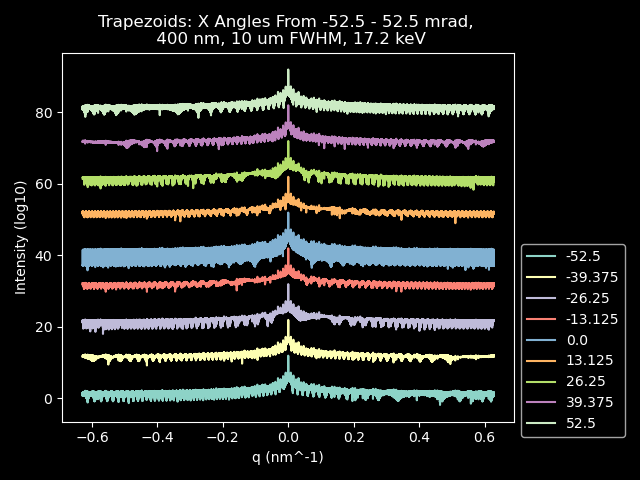

In [66]:
ax_anim_2_trap = plt.figure().add_subplot()
print(np.arange(-0.1,0.1,20))
count = 0
order2 = []
#x_ang_17 = np.linspace(-10,10,15)
for a,b in zip(yang5,plotname2_30_trap):
    maxi = np.argmax(b,axis = 0)[1]
    #order1.append(a[maxi])
    #print(yang)
    plt.plot(a,np.log10(b)[5000,:] + count*10,label = str(np.round(x_ang[count],2)*1.75))
    #ani = plt.plot(a,np.log10(b)[5000,:],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
    count += 1
    #order2.append(ani)
print(count)
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5) #Use this
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_8_18fov[1500,:]),label = '200 nm',alpha = 1)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_16_18fov[1500,:]),label = '400 nm',alpha = 0.3)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1[1500,:]),label = '1 keV',alpha = 0.9)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_8[1500,:]),label = '1.8 keV',alpha = 0.7)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_9[1500,:]),label = '1.9 keV',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_xy_0_5[1150,:]),label = '1:3 - both X and Y rotated 0.5 deg',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rectangle_1_1_25z_14_7keV_8px[1000,:]),label = '1:1 control',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rect_cross_5px[1500,:]),label = 'Trapezoid - Rectangular Cross-section',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_0_5degx[750,:]),label = '1:1 trapezoid slope 1 0.5 deg x',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_0_5y[1000,:]),label = '1:1 trapezoid slope 1 0.5 deg y',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z[1000,:]),label = '1:1 trapezoid slope 1 5 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_9keV[1000,:])+20,label = '1:1 trapezoid slope 1 1.9 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_8keV[1000,:])+10,label = '1:1 trapezoid slope 1 1.8 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV[1000,:]),label = '1:1 trapezoid slope 1 25 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degxy[200,:])+20,label = '1:1 trapezoid 5 px z 0.5 deg xy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degx[200,:])+30,label = '1:1 trapezoid 5 px z 0.5 degx',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degy[1000,:])+20,label = '1:1 trapezoid 5 px z 0.5 degy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV[1000,:]) + 10,label = '1:1 trapezoid 5 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV_inv[1000,:]),label = '1:1 trapezoid slope 1 Inverted',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_alt[1500,:]),label = '1:1 trapezoid slope 1 calculated',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3_extend[1500,:]),label = '1:1 trapezoid slope 3 taller',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3[1500,:]),label = '1:1 trapezoid slope 3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_inv[1500,:]),label = '1:1 trapezoid inv',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:])+10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov[1500,:])+20,label = '1:3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_5[1500,:])+30,label = '1:5',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_1[1500,:]) + 10,label = '1:1',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:]) + 10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_32_18fov[1500,:]),label = '800 nm',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_40_18fov[1500,:]),label = '1000 nm',alpha = 0.3)
#plt.plot(yang2[6],np.log10(plotname2[6][5000,:]),label = '5 deg x-axis',alpha = 1)
#plt.plot(yang2[6],np.log10(plotnameori[6][5000,:]),label = '5 deg y-axis',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_5degy[:,500]),label = '5 deg y-axis',alpha = 0.5)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_40[:,500])+120,label = '1000 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_48[:,500])+150,label = '1200 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5)
xlabs = ax.get_xticklabels()
ylabs = ax.get_yticklabels()
print(xlabs)
print(ylabs)
#labx = np.round(yang,2)
#laby = np.round(np.linspace(-(temp.shape[1])*wave_grid_step[1]/2 - (temp.shape[1])*wave_grid_step[1]/(len(xlabs)-2), (temp.shape[1])*wave_grid_step[1]/2,len(xlabs)),1)
#ax.set_xticks(labx)
#ax.set_yticklabels(laby)
plt.ylabel('Intensity (log10)')
plt.xlabel('q (nm^-1)')
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.13))
plt.legend(bbox_to_anchor = (1.0,0.5))
plt.title('Trapezoids: X Angles From -52.5 - 52.5 mrad, \n 400 nm, 10 um FWHM, 17.2 keV')
plt.tight_layout()
plt.show()

In [ ]:
ax = plt.figure().add_subplot()
print(np.arange(-0.1,0.1,20))
count = 0
for a,b in zip(yang,plotimport):
    maxi = np.argmax(b,axis = 0)[0]
    #print(yang)
    plt.plot(a,np.log10(b)[5000,:],label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
    count += 1
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5) #Use this
#plt.plot(qx_ax,np.log10(intensity_farfield_b[:,700]),label = 'Small bridge')
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_8_18fov[1500,:]),label = '200 nm',alpha = 1)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_16_18fov[1500,:]),label = '400 nm',alpha = 0.3)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1[1500,:]),label = '1 keV',alpha = 0.9)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_8[1500,:]),label = '1.8 keV',alpha = 0.7)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_9[1500,:]),label = '1.9 keV',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_xy_0_5[1150,:]),label = '1:3 - both X and Y rotated 0.5 deg',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rectangle_1_1_25z_14_7keV_8px[1000,:]),label = '1:1 control',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_rect_cross_5px[1500,:]),label = 'Trapezoid - Rectangular Cross-section',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_0_5degx[750,:]),label = '1:1 trapezoid slope 1 0.5 deg x',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_0_5y[1000,:]),label = '1:1 trapezoid slope 1 0.5 deg y',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z[1000,:]),label = '1:1 trapezoid slope 1 5 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_9keV[1000,:])+20,label = '1:1 trapezoid slope 1 1.9 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_1_8keV[1000,:])+10,label = '1:1 trapezoid slope 1 1.8 keV Energy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV[1000,:]),label = '1:1 trapezoid slope 1 25 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degxy[200,:])+20,label = '1:1 trapezoid 5 px z 0.5 deg xy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degx[200,:])+30,label = '1:1 trapezoid 5 px z 0.5 degx',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV_0_5degy[1000,:])+20,label = '1:1 trapezoid 5 px z 0.5 degy',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV[1000,:]) + 10,label = '1:1 trapezoid 5 px z',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV_inv[1000,:]),label = '1:1 trapezoid slope 1 Inverted',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_trapezoid_slope1_alt[1500,:]),label = '1:1 trapezoid slope 1 calculated',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3_extend[1500,:]),label = '1:1 trapezoid slope 3 taller',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_slope3[1500,:]),label = '1:1 trapezoid slope 3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_36_18fov_trapezoid_inv[1500,:]),label = '1:1 trapezoid inv',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:])+10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov[1500,:])+20,label = '1:3',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_5[1500,:])+30,label = '1:5',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_1[1500,:]) + 10,label = '1:1',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_1_2[1500,:]) + 10,label = '1:2',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_32_18fov[1500,:]),label = '800 nm',alpha = 0.5)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_40_18fov[1500,:]),label = '1000 nm',alpha = 0.3)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_5degx[1500,:]),label = '5 deg x-axis',alpha = 1)
#plt.plot(qy_ax,np.log10(intensity_farfield_b3_24_18fov_5degy[850,:]),label = '5 deg y-axis',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_5degy[:,500]),label = '5 deg y-axis',alpha = 0.5)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_40[:,500])+120,label = '1000 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_b3_48[:,500])+150,label = '1200 mn',alpha = 1)
#plt.plot(qx_ax,np.log10(intensity_farfield_control[:,700]),label = 'Control',alpha = 0.5)
xlabs = ax.get_xticklabels()
ylabs = ax.get_yticklabels()
print(xlabs)
print(ylabs)
labx = np.round(yang,2)
#laby = np.round(np.linspace(-(temp.shape[1])*wave_grid_step[1]/2 - (temp.shape[1])*wave_grid_step[1]/(len(xlabs)-2), (temp.shape[1])*wave_grid_step[1]/2,len(xlabs)),1)
#ax.set_xticks(labx)
#ax.set_yticklabels(laby)
plt.ylabel('Intensity (log10)')
plt.xlabel('q (nm^-1)')
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.13))
plt.legend(bbox_to_anchor = (1.0,0.5))
plt.title('Rectangle: Y Angles From -0.1 - 0.1 deg, \n 400 nm, 18.25 FWHM, 17 keV')
plt.tight_layout()
plt.show()

In [147]:
order1

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0]

2607


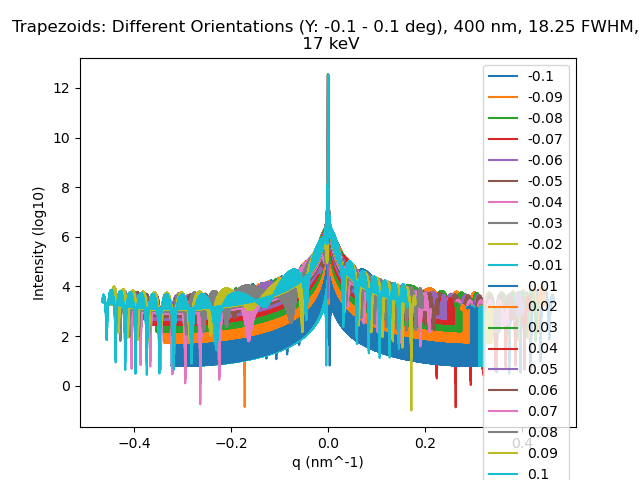

In [431]:
#INtegrate to get the pattern across q_ay
ax = plt.figure().add_subplot()
count = 0
print(np.argmax(plotname2[0],axis = 1)[0])
for a,b in zip(yang,plotname):
    #print(yang)
    #print(np.argmax(a))
    plt.plot(a - a[np.argmax(b,axis = 1)[0]],np.log10(np.sum(b,axis = 0)),label = str(np.round(np.linspace(-0.1,0.1,20)[count],2)))
    count += 1
#matsum = np.log10(np.sum(intensity_farfield_b3_24_18fov_1_2_rectangle_8px,axis = 0))
#matsum1 = np.log10(np.sum(intensity_farfield_b3_24_18fov_2_1_rectangle_8px,axis = 0))
#matsum2 = np.log10(np.sum(intensity_farfield_b3_24_18fov_trapezoid_slope1,axis = 0))
#matsum3 = np.log10(np.sum(intensity_farfield_b3_24_18fov_trapezoid_slope1_25z_14_7keV,axis = 0))
#matsum4 = np.log10(np.sum(intensity_farfield_b3_24_18fov_trapezoid_5z_14_7keV,axis = 0))
#plt.plot(qy_ax,matsum,label = '1:2 sum',alpha = 0.5)
#plt.plot(qy_ax,matsum1,label = '2:1 sum',alpha = 0.5)
#plt.plot(qy_ax,matsum2,label = 'Trapezoid Slope 1 sum',alpha = 0.5)
#plt.plot(qy_ax,matsum3,label = 'Trapezoid Slope 1 25 px z',alpha = 0.5)
#plt.plot(qy_ax,matsum4,label = 'Trapezoid Slope 1 5 px z',alpha = 0.5)
plt.title('Trapezoids: Different Orientations (Y: -0.1 - 0.1 deg), 400 nm, 18.25 FWHM, \n 17 keV')
plt.xlabel('q (nm^-1)')
plt.ylabel('Intensity (log10)')
plt.legend()
plt.show()

In [347]:
contourmat = np.log10(sum(plotname))
contourmat

array([[-17.35410692, -13.71624062, -13.15585373, ..., -12.87476811,
        -13.15150187, -13.70796006],
       [-17.37943945, -13.71597021, -13.15550098, ..., -12.87442871,
        -13.15111466, -13.70756426],
       [-17.35685391, -13.71556254, -13.15514733, ..., -12.87405675,
        -13.15078929, -13.70720698],
       ...,
       [-17.37898296, -13.71729026, -13.15688725, ..., -12.87582073,
        -13.15257905, -13.70876995],
       [-17.3584498 , -13.71701928, -13.15657551, ..., -12.8754706 ,
        -13.15217388, -13.7087842 ],
       [-17.3809357 , -13.71663353, -13.15619026, ..., -12.87512615,
        -13.15184039, -13.70815985]])

In [356]:
contourmat

array([[-17.35410692, -13.71624062, -13.15585373, ..., -12.87476811,
        -13.15150187, -13.70796006],
       [-17.37943945, -13.71597021, -13.15550098, ..., -12.87442871,
        -13.15111466, -13.70756426],
       [-17.35685391, -13.71556254, -13.15514733, ..., -12.87405675,
        -13.15078929, -13.70720698],
       ...,
       [-17.37898296, -13.71729026, -13.15688725, ..., -12.87582073,
        -13.15257905, -13.70876995],
       [-17.3584498 , -13.71701928, -13.15657551, ..., -12.8754706 ,
        -13.15217388, -13.7087842 ],
       [-17.3809357 , -13.71663353, -13.15619026, ..., -12.87512615,
        -13.15184039, -13.70815985]])

ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 0 with shape (2048, 3000) and arg 2 with shape (2000, 3000).

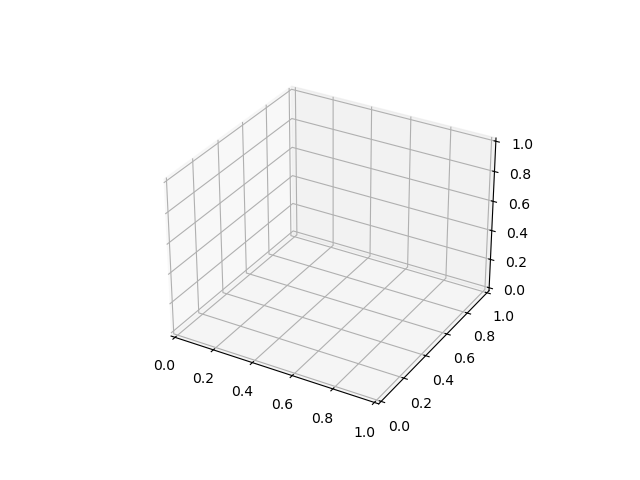

In [75]:
import matplotlib
ax = plt.figure().add_subplot(projection = '3d')
count = 0
for i in np.arange(len(plotname)):
    if count%5 == 0:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        x,y = np.meshgrid(qang[i],yang[i])
        zcol = np.c_[-1000:1000]
        zplane = np.repeat(zcol,repeats = 3000,axis = 1)
        zcol = np.sin(np.deg2rad(y_list[i]))*zplane
    #z = x**0 + y**0
        zcolor = plotname[i].reshape(x.shape)
        mini,maxi = np.log10(plotname[i].min()),np.log10(plotname[i].max())
    #print(maxi)
        norm =matplotlib.colors.Normalize(mini,maxi)
        m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        colors = m.to_rgba(np.log10(zcolor))
    #print(x.shape)
    #print(y.shape)
        ax.plot_surface(x,y,zcol,facecolors = colors)
    count += 1
#plt.contourf(yang[0],qang[0],np.log10(plotname[0]))
#plt.contourf(yang[1],qang[1],np.log10(plotname[1]))
#plt.contourf(yang[2],qang[2],np.log10(plotname[2]))
#plt.contourf(yang[3],qang[3],np.log10(plotname[4]))
#plt.contourf(yang[0],qang[0],np.log10(plotname[5]))
#plt.contourf(yang[1],qang[1],np.log10(plotname[6]))
#plt.contourf(yang[2],qang[2],np.log10(plotname[7]))
plt.show()

In [ ]:
ax = plt.figure().add_subplot()
count = 0
for i in np.arange(len(plotname)):
    if count%1 == 0:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
        zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
        #zcolor = plotname[i].reshape(x.shape)
        z2 = plotname[i][:,1000].reshape(qang[i].shape)
        mini,maxi = (plotname[i].min()),(plotname[i].max())
    #print(maxi)
        norm =matplotlib.colors.Normalize(mini,maxi)
        m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        colors = m.to_rgba(((z2)))
        points = np.array([zcol,zcol2]).T.reshape(-1,1,2)
        segments = np.concatenate([points[:-1],points[1:]],axis = 1)
        linec = matplotlib.collections.LineCollection(segments,cmap = 'viridis')
        linec.set_array(zcol2)
        ax.add_collection(linec)
        ax.set_xlim(zcol.min(),zcol.max())
        ax.set_ylim(zcol2.min(),zcol2.max())
    #print(x.shape)
    #print(y.shape)
        #ax.scatter(zcol,zcol2,facecolor = colors,s = 5)
    count += 1

In [619]:
plotname[0].shape
#np.argmax(plotname[0])
qang[0][5000]

0.0

In [269]:
plottrap = np.load(open('output0_1_trapezoid_1_1_400nm.npy','rb'))

IndexError: index 5 is out of bounds for axis 0 with size 5

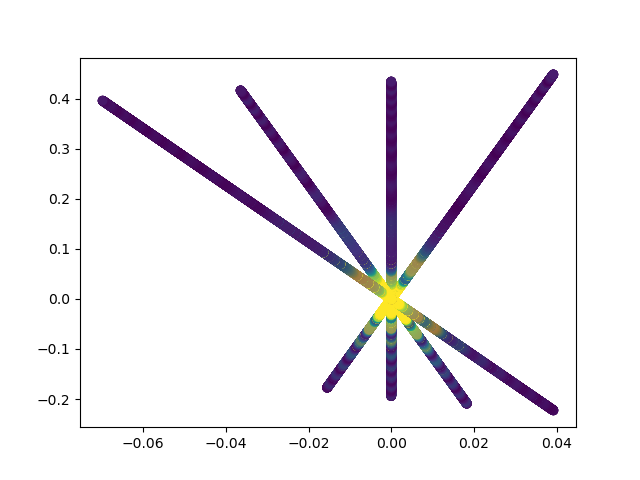

In [272]:
import matplotlib #trapezoids
ax7 = plt.figure().add_subplot()
count = 0
ressub7 = []
#print((x_ang))
totint = []
plotname = plottrap
yang = yang
qang = qang
#mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
#norm =matplotlib.colors.Normalize(mini,maxi)
#mini2,maxi2 = (plotname[0].min()),(plotname[0].max())
    #print(maxi)
#norm2 =matplotlib.colors.Normalize(mini2,maxi2)
#print(len(plotname) - 1)
for i in np.arange(0,len(plotname)):
    #if 32 > count > -11:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
   #     zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
   #     zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
    #    zcolor = plotname[i][:,1000].reshape(qang[i].shape)
     #   mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
      #  norm =matplotlib.colors.Normalize(mini,maxi)
       # m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        #colors = m.to_rgba(np.log10(zcolor))
        #res.append([zcol,zcol2,colors])
    maxix = np.argmax(plotname[i],axis = 1)[0]
    #print(maxix)
    #zcol = qang[i]*np.cos(np.deg2rad(-x_ang[i])) - yang[i][2500]*np.sin(np.deg2rad(-x_ang[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
    #zcol2 = qang[i]*np.sin(np.deg2rad(-x_ang[i])) + yang[i][2500]*np.cos(np.deg2rad(-x_ang[i]))
#ax = beta?
    zcol2_2 = yang[i] - yang[i][maxix]
    #print(len(zcol2_2))
    qy = np.zeros((len(yang[i])))
    #print(qy.shape)
    #print(yang[i].shape)
    #zcol_2 = zcol - np.median(zcol)
    if x_ang[i] < 10:
        #zcol = qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    else:
        #zcol = (qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = (qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = (zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    #if x_ang[i] < 0:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #else:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #zcol_2 = zcol - 0#zcol[0]
    #zcol2_2 = zcol2 - 0#zcol2[0]
    #print(zcol2_2[0])
    #z = x**0 + y**0
    zcolor = plotname[i][5000,:].reshape(yang[i].shape)
    #print(plotname[i][5000,:].max())
    #print(zcol_2)
    #print(zcolor.shape)
    mini,maxi = (plotname[i].min()),(plotname[i].max())
    mini2,maxi2 = np.log10(plotname[i].min()),np.log10(plotname[i].max())
    #print(maxi)
    norm3 =matplotlib.colors.Normalize(mini,maxi)
    norm4 =matplotlib.colors.Normalize(mini2,maxi2)
    #m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
    m4 = cm.ScalarMappable(norm = norm4,cmap = 'viridis')
    m3 = cm.ScalarMappable(norm = norm3,cmap = 'viridis')
    colors = m3.to_rgba((zcolor))
    colors2 = m4.to_rgba(np.log10(zcolor))
    if count == 0:
        #print(yang[i])
        #print(plotname[i][5000,:])
        ressub7 = np.asarray([zcol,zcol2,zcolor])
        totint = np.asarray([qy,yang[i],zcolor])
        #print(totint.shape)
    else:
        ressub7 = np.concatenate((ressub7,[zcol,zcol2,zcolor]),axis = 1)#((zcolor-np.min(zcolor))/(np.max(zcolor) - np.min(zcolor))
        totint = np.concatenate((totint,[qy,yang[i],zcolor]),axis = 1)
    #print(x.shape)
    #print(y.shape)
        ax7.scatter(zcol2,zcol,c = zcolor,facecolors = colors,vmin = 0, vmax = 10000)
    count += 1
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
plt.tight_layout()

In [ ]:
import matplotlib #larger rotations (-30 - 30)
ax7 = plt.figure().add_subplot()
count = 0
ressub7 = []
#print((x_ang))
totint = []
plotname = plotname2
yang = yang2
qang = qang2
#mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
#norm =matplotlib.colors.Normalize(mini,maxi)
#mini2,maxi2 = (plotname[0].min()),(plotname[0].max())
    #print(maxi)
#norm2 =matplotlib.colors.Normalize(mini2,maxi2)
#print(len(plotname) - 1)
for i in np.arange(0,len(plotname)):
    #if 32 > count > -11:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
   #     zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
   #     zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
    #    zcolor = plotname[i][:,1000].reshape(qang[i].shape)
     #   mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
      #  norm =matplotlib.colors.Normalize(mini,maxi)
       # m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        #colors = m.to_rgba(np.log10(zcolor))
        #res.append([zcol,zcol2,colors])
    maxix = np.argmax(plotname[i],axis = 1)[0]
    #print(maxix)
    #zcol = qang[i]*np.cos(np.deg2rad(-x_ang[i])) - yang[i][2500]*np.sin(np.deg2rad(-x_ang[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
    #zcol2 = qang[i]*np.sin(np.deg2rad(-x_ang[i])) + yang[i][2500]*np.cos(np.deg2rad(-x_ang[i]))
#ax = beta?
    zcol2_2 = yang[i]# - yang[i][maxix]
    #print(len(zcol2_2))
    qy = np.zeros((len(yang[i])))
    #print(qy.shape)
    #print(yang[i].shape)
    #zcol_2 = zcol - np.median(zcol)
    if x_ang[i] < 10:
        print(x_ang[i])
        #zcol = qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        print(zcol2[0])
    else:
        #zcol = (qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = (qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = (zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    #if x_ang[i] < 0:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #else:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #zcol_2 = zcol - 0#zcol[0]
    #zcol2_2 = zcol2 - 0#zcol2[0]
    #print(zcol2_2[0])
    #z = x**0 + y**0
    zcolor = plotname[i][5000,:].reshape(yang[i].shape)
    #print(plotname[i][5000,:].max())
    #print(zcol_2)
    #print(zcolor.shape)
    mini,maxi = (plotname[i].min()),(plotname[i].max())
    mini2,maxi2 = np.log10(plotname[i].min()),np.log10(plotname[i].max())
    #print(maxi)
    norm3 =matplotlib.colors.Normalize(mini,maxi)
    norm4 =matplotlib.colors.Normalize(mini2,maxi2)
    #m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
    m4 = cm.ScalarMappable(norm = norm4,cmap = 'viridis')
    m3 = cm.ScalarMappable(norm = norm3,cmap = 'viridis')
    colors = m3.to_rgba((zcolor))
    colors2 = m4.to_rgba(np.log10(zcolor))
    if count == 0:
        #print(yang[i])
        #print(plotname[i][5000,:])
        ressub8 = np.asarray([zcol,zcol2,zcolor])
        totint = np.asarray([qy,yang[i],zcolor])
        #print(totint.shape)
    else:
        ressub8 = np.concatenate((ressub8,[zcol,zcol2,zcolor]),axis = 1)#((zcolor-np.min(zcolor))/(np.max(zcolor) - np.min(zcolor))
        totint = np.concatenate((totint,[qy,yang[i],zcolor]),axis = 1)
    #print(x.shape)
    #print(y.shape)
        ax7.scatter(zcol2,zcol,c = zcolor,facecolors = colors,vmin = 0, vmax = 10000)
    count += 1
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
plt.tight_layout()

-1.0
-0.010966767046871308
-0.75
-0.008225257982877727
-0.5
-0.005483592321828603
-0.25
-0.0027418222610861016
0.0
0.0
0.25
0.0027418222610861016
0.5
0.005483592321828603
0.75
0.008225257982877727
1.0
0.010966767046871308


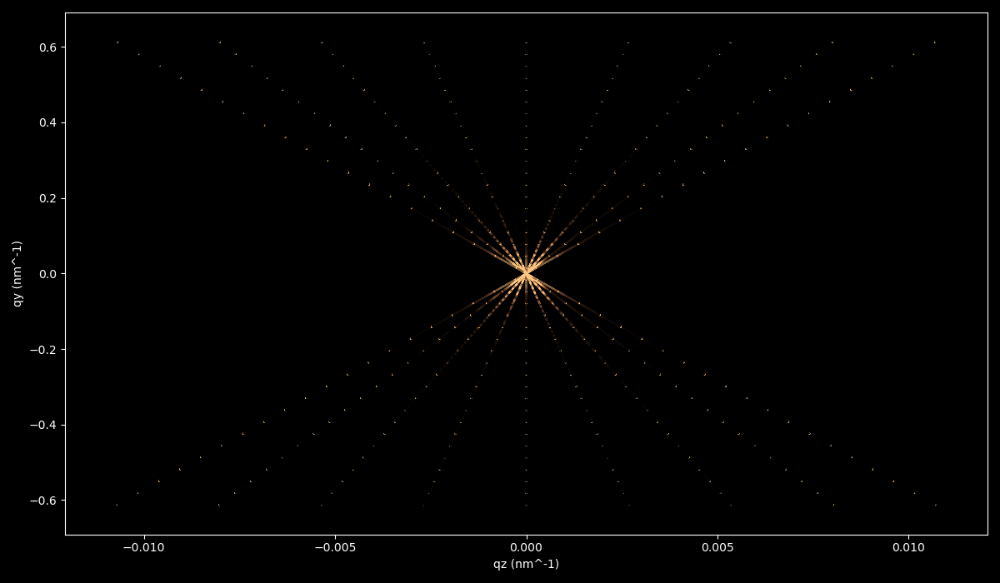

In [337]:
import matplotlib #larger rotations (-1 - 1 deg)
ax7 = plt.figure(figsize = (12,7)).add_subplot()
count = 0
ressub7 = []
#print((x_ang))
totint = []
plotname = plotname2
yang = yang2
qang = qang2
#mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
#norm =matplotlib.colors.Normalize(mini,maxi)
#mini2,maxi2 = (plotname[0].min()),(plotname[0].max())
    #print(maxi)
#norm2 =matplotlib.colors.Normalize(mini2,maxi2)
#print(len(plotname) - 1)
for i in np.arange(0,len(plotname)):
    #if 32 > count > -11:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
   #     zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
   #     zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
    #    zcolor = plotname[i][:,1000].reshape(qang[i].shape)
     #   mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
      #  norm =matplotlib.colors.Normalize(mini,maxi)
       # m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        #colors = m.to_rgba(np.log10(zcolor))
        #res.append([zcol,zcol2,colors])
    maxix = np.argmax(plotname[i],axis = 1)[0]
    #print(maxix)
    #zcol = qang[i]*np.cos(np.deg2rad(-x_ang[i])) - yang[i][2500]*np.sin(np.deg2rad(-x_ang[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
    #zcol2 = qang[i]*np.sin(np.deg2rad(-x_ang[i])) + yang[i][2500]*np.cos(np.deg2rad(-x_ang[i]))
#ax = beta?
    zcol2_2 = yang[i]# - yang[i][maxix]
    #print(len(zcol2_2))
    qy = np.zeros((len(yang[i])))
    #print(qy.shape)
    #print(yang[i].shape)
    #zcol_2 = zcol - np.median(zcol)
    if x_ang[i] < 10:
        print(x_ang[i])
        #zcol = qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        print(zcol2[0])
    else:
        #zcol = (qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = (qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = (zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    #if x_ang[i] < 0:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #else:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #zcol_2 = zcol - 0#zcol[0]
    #zcol2_2 = zcol2 - 0#zcol2[0]
    #print(zcol2_2[0])
    #z = x**0 + y**0
    zcolor = plotname[i][5000,:].reshape(yang[i].shape)
    #print(plotname[i][5000,:].max())
    #print(zcol_2)
    #print(zcolor.shape)
    mini,maxi = (plotname[i].min()),(plotname[i].max())
    mini2,maxi2 = np.log10(plotname[i].min()),np.log10(plotname[i].max())
    #print(maxi)
    norm3 =matplotlib.colors.Normalize(mini,maxi)
    norm4 =matplotlib.colors.Normalize(mini2,maxi2)
    #m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
    m4 = cm.ScalarMappable(norm = norm4,cmap = 'copper')
    m3 = cm.ScalarMappable(norm = norm3,cmap = 'copper')
    colors = m3.to_rgba((zcolor))
    colors2 = m4.to_rgba(np.log10(zcolor))
    if count == 0:
        #print(yang[i])
        #print(plotname[i][5000,:])
        ressub1 = np.asarray([zcol,zcol2,zcolor])
        totint = np.asarray([qy,yang[i],zcolor])
        #print(totint.shape)
    else:
        ressub1 = np.concatenate((ressub1,[zcol,zcol2,zcolor]),axis = 1)#((zcolor-np.min(zcolor))/(np.max(zcolor) - np.min(zcolor))
        totint = np.concatenate((totint,[qy,yang[i],zcolor]),axis = 1)
    #print(x.shape)
    #print(y.shape)
    ax7.scatter(zcol2,zcol,c = zcolor,facecolors = colors,vmin = 0, vmax = 4500,s = 0.1,cmap = 'copper')
    count += 1
plt.style.use('dark_background')
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
plt.tight_layout()

-30.0
-0.31419068442742204
-27.0
-0.2852791716734312
-24.0
-0.25558572853939554
-21.0
-0.2251917426889795
-18.0
-0.19418052192473914
-15.0
-0.16263706584722565
-12.0
-0.13064783287698875
-9.0
-0.09830050327805555
-6.0
-0.06568373883242139
-3.0
-0.032886939824268276
0.0
0.0
3.0
0.032886939824268276
6.0
0.06568373883242139
9.0
0.09830050327805555


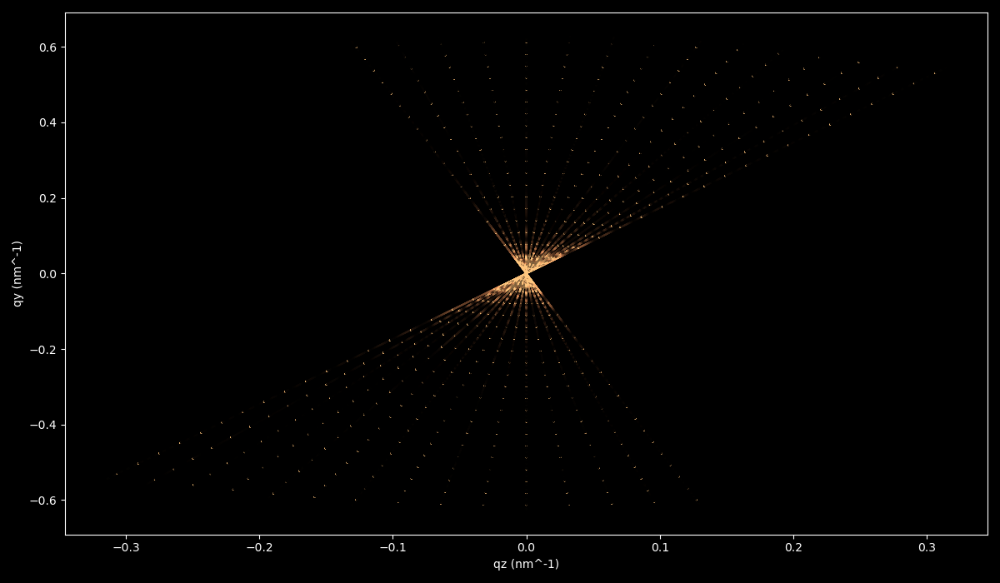

In [499]:
import matplotlib #larger rotations (-1 - 1 deg)
ax17_5 = plt.figure(figsize = (12,7)).add_subplot()
count = 0
ressub7 = []
#print((x_ang))
totint = []
plotname = plotname2_17_5
yang = yang3
qang = qang3
#mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
#norm =matplotlib.colors.Normalize(mini,maxi)
#mini2,maxi2 = (plotname[0].min()),(plotname[0].max())
    #print(maxi)
#norm2 =matplotlib.colors.Normalize(mini2,maxi2)
#print(len(plotname) - 1)
for i in np.arange(0,len(plotname)):
    #if 32 > count > -11:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
   #     zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
   #     zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
    #    zcolor = plotname[i][:,1000].reshape(qang[i].shape)
     #   mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
      #  norm =matplotlib.colors.Normalize(mini,maxi)
       # m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        #colors = m.to_rgba(np.log10(zcolor))
        #res.append([zcol,zcol2,colors])
    maxix = np.argmax(plotname[i],axis = 1)[0]
    #print(maxix)
    #zcol = qang[i]*np.cos(np.deg2rad(-x_ang[i])) - yang[i][2500]*np.sin(np.deg2rad(-x_ang[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
    #zcol2 = qang[i]*np.sin(np.deg2rad(-x_ang[i])) + yang[i][2500]*np.cos(np.deg2rad(-x_ang[i]))
#ax = beta?
    zcol2_2 = yang[i]# - yang[i][maxix]
    #print(len(zcol2_2))
    qy = np.zeros((len(yang[i])))
    #print(qy.shape)
    #print(yang[i].shape)
    #zcol_2 = zcol - np.median(zcol)
    if x_ang[i] < 10:
        print(x_ang[i])
        #zcol = qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        print(zcol2[0])
    else:
        #zcol = (qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = (qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = (zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    #if x_ang[i] < 0:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #else:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #zcol_2 = zcol - 0#zcol[0]
    #zcol2_2 = zcol2 - 0#zcol2[0]
    #print(zcol2_2[0])
    #z = x**0 + y**0
    zcolor = plotname[i][5000,:].reshape(yang[i].shape)
    #print(plotname[i][5000,:].max())
    #print(zcol_2)
    #print(zcolor.shape)
    mini,maxi = (plotname[i].min()),(plotname[i].max())
    mini2,maxi2 = np.log10(plotname[i].min()),np.log10(plotname[i].max())
    #print(maxi)
    norm3 =matplotlib.colors.Normalize(mini,maxi)
    norm4 =matplotlib.colors.Normalize(mini2,maxi2)
    #m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
    m4 = cm.ScalarMappable(norm = norm4,cmap = 'copper')
    m3 = cm.ScalarMappable(norm = norm3,cmap = 'copper')
    colors = m3.to_rgba((zcolor))
    colors2 = m4.to_rgba(np.log10(zcolor))
    if count == 0:
        #print(yang[i])
        #print(plotname[i][5000,:])
        ressub10 = np.asarray([zcol,zcol2,zcolor])
        totint = np.asarray([qy,yang[i],zcolor])
        #print(totint.shape)
    else:
        ressub10 = np.concatenate((ressub10,[zcol,zcol2,zcolor]),axis = 1)#((zcolor-np.min(zcolor))/(np.max(zcolor) - np.min(zcolor))
        totint = np.concatenate((totint,[qy,yang[i],zcolor]),axis = 1)
    #print(x.shape)
    #print(y.shape)
    ax17_5.scatter(zcol2,zcol,c = zcolor,facecolors = colors,vmin = 0, vmax = 4500,s = 0.1,cmap = 'copper')
    count += 1
plt.style.use('dark_background')
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
plt.tight_layout()

-30.0
-0.31419068442742204
-22.5
-0.2404711390676453
-15.0
-0.16263706584722565
-7.5
-0.08202022733864653
0.0
0.0
7.5
0.08202022733864653


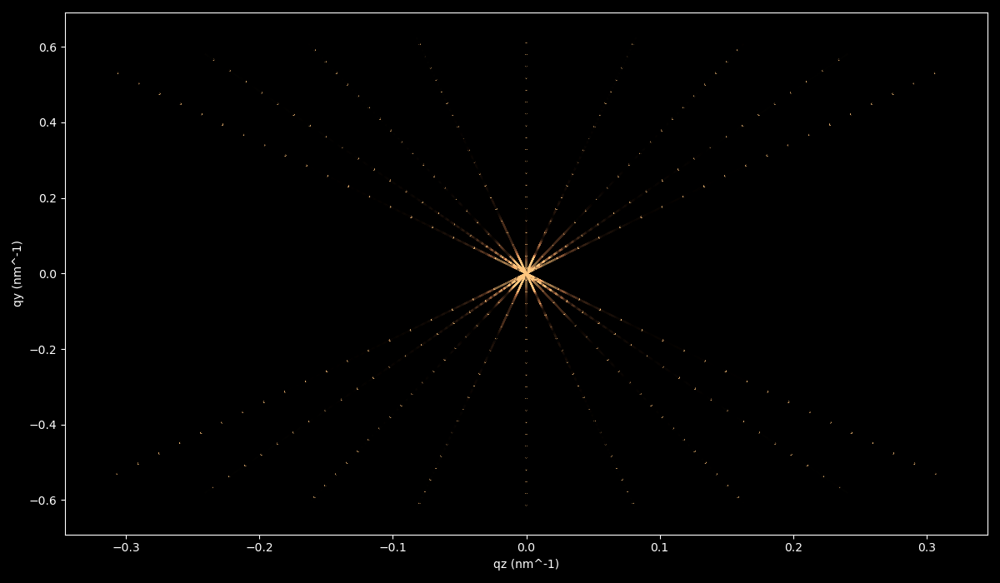

In [69]:
import matplotlib #larger rotations (-30 - 30 deg) - rectangle with tilt
ax30 = plt.figure(figsize = (12,7)).add_subplot()
count = 0
ressub7 = []
#print((x_ang))
totint = []
plotname = plotname2_30
yang = yang4
qang = qang4
#mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
#norm =matplotlib.colors.Normalize(mini,maxi)
#mini2,maxi2 = (plotname[0].min()),(plotname[0].max())
    #print(maxi)
#norm2 =matplotlib.colors.Normalize(mini2,maxi2)
#print(len(plotname) - 1)
for i in np.arange(0,len(plotname)):
    #if 32 > count > -11:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
   #     zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
   #     zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
    #    zcolor = plotname[i][:,1000].reshape(qang[i].shape)
     #   mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
      #  norm =matplotlib.colors.Normalize(mini,maxi)
       # m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        #colors = m.to_rgba(np.log10(zcolor))
        #res.append([zcol,zcol2,colors])
    maxix = np.argmax(plotname[i],axis = 1)[0]
    #print(maxix)
    #zcol = qang[i]*np.cos(np.deg2rad(-x_ang[i])) - yang[i][2500]*np.sin(np.deg2rad(-x_ang[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
    #zcol2 = qang[i]*np.sin(np.deg2rad(-x_ang[i])) + yang[i][2500]*np.cos(np.deg2rad(-x_ang[i]))
#ax = beta?
    zcol2_2 = yang[i]# - yang[i][maxix]
    #print(len(zcol2_2))
    qy = np.zeros((len(yang[i])))
    #print(qy.shape)
    #print(yang[i].shape)
    #zcol_2 = zcol - np.median(zcol)
    if x_ang[i] < 10:
        print(x_ang[i])
        #zcol = qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        print(zcol2[0])
    else:
        #zcol = (qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = (qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = (zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    #if x_ang[i] < 0:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #else:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #zcol_2 = zcol - 0#zcol[0]
    #zcol2_2 = zcol2 - 0#zcol2[0]
    #print(zcol2_2[0])
    #z = x**0 + y**0
    zcolor = plotname[i][5000,:].reshape(yang[i].shape)
    #print(plotname[i][5000,:].max())
    #print(zcol_2)
    #print(zcolor.shape)
    mini,maxi = (plotname[i].min()),(plotname[i].max())
    mini2,maxi2 = np.log10(plotname[i].min()),np.log10(plotname[i].max())
    #print(maxi)
    norm3 =matplotlib.colors.Normalize(mini,maxi)
    norm4 =matplotlib.colors.Normalize(mini2,maxi2)
    #m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
    m4 = cm.ScalarMappable(norm = norm4,cmap = 'copper')
    m3 = cm.ScalarMappable(norm = norm3,cmap = 'copper')
    colors = m3.to_rgba((zcolor))
    colors2 = m4.to_rgba(np.log10(zcolor))
    if count == 0:
        #print(yang[i])
        #print(plotname[i][5000,:])
        ressub30 = np.asarray([zcol,zcol2,zcolor])
        totint = np.asarray([qy,yang[i],zcolor])
        #print(totint.shape)
    else:
        ressub30 = np.concatenate((ressub30,[zcol,zcol2,zcolor]),axis = 1)#((zcolor-np.min(zcolor))/(np.max(zcolor) - np.min(zcolor))
        totint = np.concatenate((totint,[qy,yang[i],zcolor]),axis = 1)
    #print(x.shape)
    #print(y.shape)
    ax30.scatter(zcol2,zcol,c = zcolor,facecolors = colors,vmin = 0, vmax = 4500,s = 0.1,cmap = 'copper')
    count += 1
plt.style.use('dark_background')
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
plt.tight_layout()

-30.0
-0.31419068442742204
-22.5
-0.2404711390676453
-15.0
-0.16263706584722565
-7.5
-0.08202022733864653
0.0
0.0
7.5
0.08202022733864653


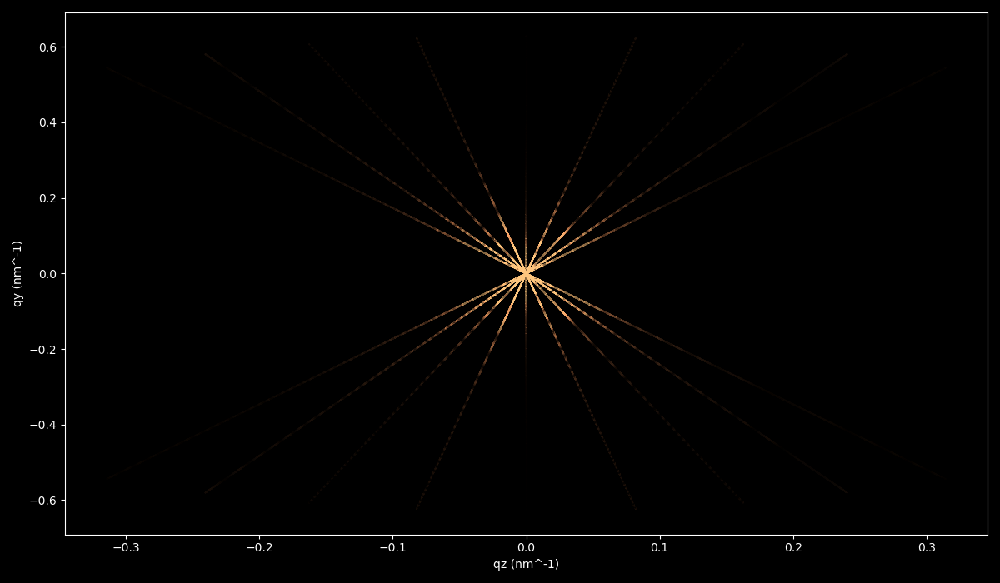

In [70]:
import matplotlib #larger rotations (-30 - 30 deg trapezoid)
ax30_trap = plt.figure(figsize = (12,7)).add_subplot()
count = 0
ressub7 = []
#print((x_ang))
totint = []
plotname = plotname2_30_trap
yang = yang5
qang = qang5
#mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
#norm =matplotlib.colors.Normalize(mini,maxi)
#mini2,maxi2 = (plotname[0].min()),(plotname[0].max())
    #print(maxi)
#norm2 =matplotlib.colors.Normalize(mini2,maxi2)
#print(len(plotname) - 1)
for i in np.arange(0,len(plotname)):
    #if 32 > count > -11:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
   #     zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
   #     zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
    #    zcolor = plotname[i][:,1000].reshape(qang[i].shape)
     #   mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
      #  norm =matplotlib.colors.Normalize(mini,maxi)
       # m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        #colors = m.to_rgba(np.log10(zcolor))
        #res.append([zcol,zcol2,colors])
    maxix = np.argmax(plotname[i],axis = 1)[0]
    #print(maxix)
    #zcol = qang[i]*np.cos(np.deg2rad(-x_ang[i])) - yang[i][2500]*np.sin(np.deg2rad(-x_ang[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
    #zcol2 = qang[i]*np.sin(np.deg2rad(-x_ang[i])) + yang[i][2500]*np.cos(np.deg2rad(-x_ang[i]))
#ax = beta?
    zcol2_2 = yang[i]# - yang[i][maxix]
    #print(len(zcol2_2))
    qy = np.zeros((len(yang[i])))
    #print(qy.shape)
    #print(yang[i].shape)
    #zcol_2 = zcol - np.median(zcol)
    if x_ang[i] < 10:
        print(x_ang[i])
        #zcol = qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        print(zcol2[0])
    else:
        #zcol = (qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        #zcol2 = (qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
        zcol = (zcol2_2*np.cos(np.deg2rad(-x_ang[i])) - qang[i][5000]*np.sin(np.deg2rad(-x_ang[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (zcol2_2*np.sin(np.deg2rad(-x_ang[i])) + qang[i][5000]*np.cos(np.deg2rad(-x_ang[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    #if x_ang[i] < 0:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #else:
    #    zcol2_2 = zcol2 - zcol2[maxix]
    #    zcol = zcol - zcol[maxix]
    #zcol_2 = zcol - 0#zcol[0]
    #zcol2_2 = zcol2 - 0#zcol2[0]
    #print(zcol2_2[0])
    #z = x**0 + y**0
    zcolor = plotname[i][5000,:].reshape(yang[i].shape)
    #print(plotname[i][5000,:].max())
    #print(zcol_2)
    #print(zcolor.shape)
    mini,maxi = (plotname[i].min()),(plotname[i].max())
    mini2,maxi2 = np.log10(plotname[i].min()),np.log10(plotname[i].max())
    #print(maxi)
    norm3 =matplotlib.colors.Normalize(mini,maxi)
    norm4 =matplotlib.colors.Normalize(mini2,maxi2)
    #m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
    m4 = cm.ScalarMappable(norm = norm4,cmap = 'copper')
    m3 = cm.ScalarMappable(norm = norm3,cmap = 'copper')
    colors = m3.to_rgba((zcolor))
    colors2 = m4.to_rgba(np.log10(zcolor))
    if count == 0:
        #print(yang[i])
        #print(plotname[i][5000,:])
        ressub30_trap = np.asarray([zcol,zcol2,zcolor])
        totint = np.asarray([qy,yang[i],zcolor])
        #print(totint.shape)
    else:
        ressub30_trap = np.concatenate((ressub30_trap,[zcol,zcol2,zcolor]),axis = 1)#((zcolor-np.min(zcolor))/(np.max(zcolor) - np.min(zcolor))
        totint = np.concatenate((totint,[qy,yang[i],zcolor]),axis = 1)
    #print(x.shape)
    #print(y.shape)
    ax30_trap.scatter(zcol2,zcol,c = zcolor,facecolors = colors,vmin = 0, vmax = 1000,s = 0.1,cmap = 'copper')
    count += 1
plt.style.use('dark_background')
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
plt.tight_layout()

In [ ]:
recyang = np.load(open('yang_0_1_20_rectangle_1_1_400nm.npy','rb'))
recqang = np.load(open('qang_0_1_20_rectangle_1_1_400nm.npy','rb'))

Text(0, 0.5, 'qy (nm^-1)')

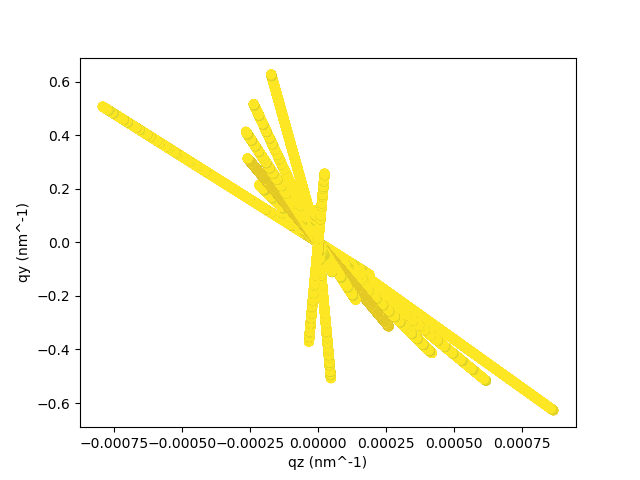

In [359]:
import matplotlib
#rectangle fins
ax7 = plt.figure().add_subplot()
count = 0
ressub20 = []
#print((x_ang))
totint = []
yang2 = yang2
qang2 = qang2
plotimport = plotnameori
#mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
#norm =matplotlib.colors.Normalize(mini,maxi)
#mini2,maxi2 = (plotname[0].min()),(plotname[0].max())
    #print(maxi)
#norm2 =matplotlib.colors.Normalize(mini2,maxi2)
#print(len(plotname) - 1)
for i in np.arange(0,len(plotimport)):
    #if 32 > count > -11:
#    plt.contourf(yang[i],np.log10(plotname[i]),qang[i])
        #x,y = np.meshgrid(qang[i],yang[i])
   #     zcol = yang[i][1000]*np.cos(np.deg2rad(y_list[i])) - qang[i]*np.sin(np.deg2rad(y_list[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
   #     zcol2 = yang[i][1000]*np.sin(np.deg2rad(y_list[i])) + qang[i]*np.cos(np.deg2rad(y_list[i]))
    #z = x**0 + y**0
    #    zcolor = plotname[i][:,1000].reshape(qang[i].shape)
     #   mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
    #print(maxi)
      #  norm =matplotlib.colors.Normalize(mini,maxi)
       # m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
        #colors = m.to_rgba(np.log10(zcolor))
        #res.append([zcol,zcol2,colors])
    maxix = np.argmax(plotimport[i],axis = 1)[0]
    #print(maxix)
    #zcol = qang[i]*np.cos(np.deg2rad(-x_ang[i])) - yang[i][2500]*np.sin(np.deg2rad(-x_ang[i]))
        #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
    #zcol2 = qang[i]*np.sin(np.deg2rad(-x_ang[i])) + yang[i][2500]*np.cos(np.deg2rad(-x_ang[i]))
#ax = beta?
    zcol2_2 = yang2[i] - yang2[i][maxix]
    #print(yang2[i][maxix])
    #print(len(zcol2_2))
    qy = np.zeros((len(yang2[i])))
    #print(qy.shape)
    #print(yang[i].shape)
    #zcol_2 = zcol - np.median(zcol)
    if x_ang2[i] < 0:
        zcol = qang[i][5000]*np.cos(np.deg2rad(-x_ang2[i])) - zcol2_2*np.sin(np.deg2rad(-x_ang2[i]))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = qang[i][5000]*np.sin(np.deg2rad(-x_ang2[i])) + zcol2_2*np.cos(np.deg2rad(-x_ang2[i]))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    else:
        zcol = (qang[i][5000]*np.cos(np.deg2rad(-x_ang2[i])) - zcol2_2*np.sin(np.deg2rad( -x_ang2[i])))
            #zplane = np.repeat(zcol,repeats = 4000,axis = 1)
        #print(len(zcol))
        zcol2 = (qang[i][5000]*np.sin(np.deg2rad(  -x_ang2[i])) + zcol2_2*np.cos(np.deg2rad( -x_ang2[i])))#qang[i][5000]*np.sin(np.deg2rad(x_ang[i]))+
    #if x_ang2[i] < 0:
    #    zcol2_2 = zcol2 - np.median(zcol2)
    #else:
     #   zcol2_2 = zcol2 - np.median(zcol2)
    #zcol_2 = zcol - 0#zcol[0]
    #zcol2_2 = zcol2 - 0#zcol2[0]
    #print(zcol2_2[0])
    #z = x**0 + y**0
    zcolor = plotname2[i][5000,:].reshape(yang2[i].shape)
    #print(plotname[i][5000,:].max())
    #print(zcol_2)
    #print(zcolor.shape)
    mini,maxi = (plotname2[i].min()),(plotname2[i].max())
    mini2,maxi2 = np.log10(plotname2[i].min()),np.log10(plotname2[i].max())
    #print(maxi)
    norm3 =matplotlib.colors.Normalize(mini,maxi)
    norm4 =matplotlib.colors.Normalize(mini2,maxi2)
    #m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
    m4 = cm.ScalarMappable(norm = norm4,cmap = 'viridis')
    m3 = cm.ScalarMappable(norm = norm3,cmap = 'viridis')
    colors = m3.to_rgba((zcolor))
    colors2 = m4.to_rgba(np.log10(zcolor))
    if count == 0:
        #print(yang[i])
        #print(plotname[i][5000,:])
        ressub20 = np.asarray([zcol,zcol2,zcolor])
        totint = np.asarray([qy,yang2[i],zcolor])
        #print(totint.shape)
    else:
        ressub20 = np.concatenate((ressub20,[zcol,zcol2,zcolor]),axis = 1)#((zcolor-np.min(zcolor))/(np.max(zcolor) - np.min(zcolor))
        totint = np.concatenate((totint,[qy,yang2[i],zcolor]),axis = 1)
    #print(x.shape)
    #print(y.shape)
        ax7.scatter(zcol,zcol2,c = zcolor,facecolor = colors,vmin = 0, vmax = 10000)
    count += 1
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')

In [676]:
yang[0]

array([-0.31419068, -0.31412785, -0.31406501, ...,  0.31400217,
        0.31406501,  0.31412785])

In [1]:
plt.imshow(totint)

NameError: name 'plt' is not defined

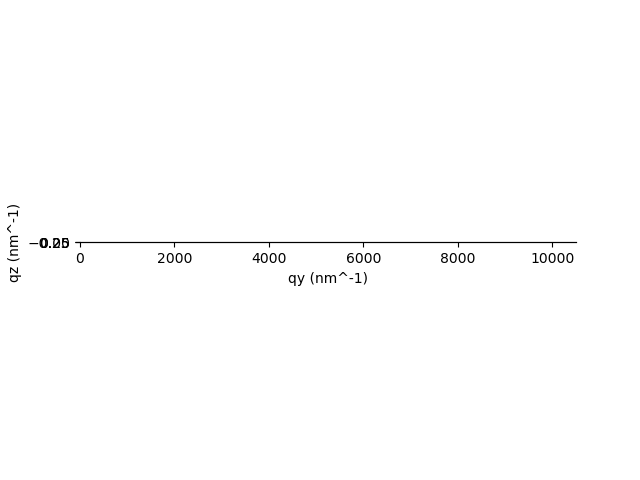

In [508]:
plt.plot(zcolor)
plt.show()

In [70]:
#reslow = ressub6#np.concatenate((ressub2,ressub3,ressub4,ressub5,ressub6),axis = 1)
#reshigh = ressub7
#reshigher = ressub8
#reshigh2 = ressub9
#reslow2 = ressub10
#reslow3 = ressub11
#res1 = np.concatenate((ressub11,ressub10,reslow,reshigh,reshigher,reshigh2),axis = 1)
res1 = ressub30
print(res1.shape)
heat,xedge,yedge = np.histogram2d(res1[0],res1[1], bins = 1000,weights = res1[2])
#heattest,xedge,yedge = np.histogram2d(res1[0],res1[1], bins = 100,weights = res1[2])
a = xedge
b = yedge
heatori = heat.reshape((len(xedge)-1,len(yedge)-1))
#heat,xedge,yedge = np.histogram2d(res1[0],res1[1], bins = 100,weights = res1[2])

(3, 90000)


In [88]:
heat
np.save('heat_0_1_20_trapezoid_1_1_1000bin.npy',heat)

In [338]:
np.save('res_rectangle_1_1_1.75_400nm_9.npy',ressub1)

In [66]:
heat

array([[6.71644116e+04, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 6.64070529e+04],
       [1.86288005e+04, 3.14314999e+06, 0.00000000e+00, ...,
        0.00000000e+00, 3.14265915e+06, 1.90057277e+04],
       [0.00000000e+00, 1.40076873e+05, 5.18336597e+03, ...,
        3.13994063e+03, 1.41762555e+05, 0.00000000e+00],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00]])

In [83]:
heatimport = np.load(open('heat_0_1_20_trapezoid_1_1_1000bin.npy','rb'))

In [84]:
heat = heatimport

In [85]:
ax,by = np.nonzero(heat)

In [304]:
[cx,dy] = np.nonzero(heat)

In [87]:
heat.shape
np.array(xedge[ax]).shape

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [209]:
coords = []
x = []
y = []
z = []
for i in np.arange(len(ax)):
    coords.append([xedge[ax[i]],yedge[by[i]],heat[ax[i],by[i]]])
    #coords = np.concatenate((np.asarray(xedge[ax]), np.asarray(yedge[by]),np.asarray(heat[np.nonzero(heat)])),axis = 1)
coords = np.sort(coords,axis = 0)
for m in coords:
    x.append(m[0])
    y.append(m[1])
    z.append(m[2])
coords = np.array([x,y,z])

In [305]:
visited = list(zip(cx,dy))

In [306]:
len(visited)

13804

In [49]:
totvisit = np.concatenate((visited,outbound))

ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 2 dimension(s) and the array at index 1 has 1 dimension(s)

In [297]:
len(totvisit)

9752

In [91]:
heat.shape
heat[1][2]

0.0

In [398]:
np.where(heat[80] == 0)

(array([99]),)

In [92]:
outbound = []
for i in np.arange(heat.shape[0]-1):
    #print(i)
        #print(j)
        #print(heat[i][j])
    if heat[heat.shape[0]-1][i] != 0:
        outbound.append((heat.shape[0]-1,i))

In [93]:
len(outbound)

2

In [94]:
outbound

[(999, 326), (999, 673)]

In [308]:
count = 0
for i in np.arange(100):#heat.shape[0]-1/2):
    #mini = np.min(np.where(heat.T[i] != 0))
    #maxi = np.max(np.where(heat.T[i] != 0))
    #print(mini)
    #print(maxi)
    for j in np.arange(100):#heat.shape[1]-1):
        #print(j)
        if (i,j) in visited:# or heat[heat.shape[0] - 1][j] == 0:
            continue
        else:#elif j in np.arange(mini,maxi):
            #print(i)
            #print(j)
            xrange = np.arange(i-1,i+2)
            yrange = np.arange(j-1,j+2)
            #print(xrange)
            x2 = [t for t in xrange if -1 < t < heat.shape[0]-1]
            y2 = [s for s in yrange if -1 < s < heat.shape[1]-1]#[np.where(-1<yrange<heat.shape[1])]
            coords = [(a,b) for a in x2 for b in y2]
            #print(coords)
            dat = [heat[int(a)][b] for a,b in coords]
            #print(dat)
            #print(coords)
            #print(x2)
            #print(coords)
            heat[int(i),j] = dat[dat != 0].mean()
            #print(heat[i,j])
            #    heat[i,j] = np.avg(surrounding)
            #    visited.append((i,j))
print(count)

0


In [80]:
xedge

array([-5.48256241e-04, -5.37290019e-04, -5.26323798e-04, -5.15357576e-04,
       -5.04391354e-04, -4.93425133e-04, -4.82458911e-04, -4.71492690e-04,
       -4.60526468e-04, -4.49560247e-04, -4.38594025e-04, -4.27627804e-04,
       -4.16661582e-04, -4.05695361e-04, -3.94729139e-04, -3.83762917e-04,
       -3.72796696e-04, -3.61830474e-04, -3.50864253e-04, -3.39898031e-04,
       -3.28931810e-04, -3.17965588e-04, -3.06999367e-04, -2.96033145e-04,
       -2.85066924e-04, -2.74100702e-04, -2.63134480e-04, -2.52168259e-04,
       -2.41202037e-04, -2.30235816e-04, -2.19269594e-04, -2.08303373e-04,
       -1.97337151e-04, -1.86370930e-04, -1.75404708e-04, -1.64438487e-04,
       -1.53472265e-04, -1.42506043e-04, -1.31539822e-04, -1.20573600e-04,
       -1.09607379e-04, -9.86411573e-05, -8.76749358e-05, -7.67087142e-05,
       -6.57424927e-05, -5.47762711e-05, -4.38100496e-05, -3.28438280e-05,
       -2.18776065e-05, -1.09113850e-05,  5.48365914e-08,  1.10210581e-05,
        2.19872797e-05,  

In [104]:
len(a)

201

In [107]:
xlim = np.linspace(res1[0].min(),res1[0].max())
ylim = np.linspace(res1[1].min(),res1[0].max())
xlim,ylim = np.meshgrid(xedge,yedge,indexing = 'ij',sparse = True)

In [118]:
gridint = RegularGridInterpolator((xedge[0:-1],yedge[0:-1]),heat,bounds_error = False)

In [239]:
gridint = griddata(np.array([coords[0],coords[1]]).T,coords[2],xi = (xlim,ylim),method = 'linear')

In [312]:
xlim = np.linspace(res1[0].min() - 0.3, res1[0].max() + 0.3)
ylim = np.linspace(res1[1].min(), res1[1].max())
xline,yline = np.meshgrid(a[0:-1],b[0:-1])

In [111]:
xline.shape

(200, 200)

In [100]:
len(col)
(a*b).shape

(201,)

In [313]:
interres = NearestNDInterpolator(list(zip(res1[0],res1[1])),res1[2])
col = interres(xline,yline)
col

array([[250.59101374,  14.25111773,  26.59102707, ..., 523.71466826,
         22.88465055,  56.43127293],
       [250.59101374,  14.25111773,  26.59102707, ..., 523.71466826,
         22.88465055,  56.43127293],
       [250.59101374,  14.25111773,  26.59102707, ..., 523.71466826,
         22.88465055,  56.43127293],
       ...,
       [624.6329209 ,  27.1655177 ,  14.78608189, ..., 256.32899792,
         25.63256294,  11.76738949],
       [624.6329209 ,  27.1655177 ,  14.78608189, ..., 256.32899792,
         25.63256294,  11.76738949],
       [624.6329209 ,  27.1655177 ,  14.78608189, ..., 256.32899792,
         25.63256294,  11.76738949]])

In [780]:
heat
col

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

In [781]:
xlim

array([[-0.30054831, -0.28828103, -0.27601376, ...,  0.27601376,
         0.28828103,  0.30054831],
       [-0.30054831, -0.28828103, -0.27601376, ...,  0.27601376,
         0.28828103,  0.30054831],
       [-0.30054831, -0.28828103, -0.27601376, ...,  0.27601376,
         0.28828103,  0.30054831],
       ...,
       [-0.30054831, -0.28828103, -0.27601376, ...,  0.27601376,
         0.28828103,  0.30054831],
       [-0.30054831, -0.28828103, -0.27601376, ...,  0.27601376,
         0.28828103,  0.30054831],
       [-0.30054831, -0.28828103, -0.27601376, ...,  0.27601376,
         0.28828103,  0.30054831]])

In [212]:
resint = gridint((xedge[0:-1],yedge[0:-1]))
resint.shape

(200,)

In [120]:

heat2,xedge2,yedge2 = np.histogram2d(xedge[0:-1],yedge[0:-1], bins = 100,weights = resint)

In [270]:
qang = np.load(open('qang_0_1_20_trapezoid_1_1_400nm.npy','rb'))

In [271]:
yang = np.load(open('yang_0_1_20_trapezoid_1_1_400nm.npy','rb'))

[ 0.0546  0.039   0.0234  0.0078 -0.0078 -0.0234 -0.039  -0.0546]
[-0.3142 -0.2244 -0.1347 -0.0449  0.0448  0.1346  0.2244  0.3141]
[Text(-200.0, 0, '−200'), Text(0.0, 0, '0'), Text(200.0, 0, '200'), Text(400.0, 0, '400'), Text(600.0, 0, '600'), Text(800.0, 0, '800'), Text(1000.0, 0, '1000')]


/tmp/ipykernel_2900817/1324286735.py:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax8.set_xticklabels(revy)
/tmp/ipykernel_2900817/1324286735.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax8.set_yticklabels(newx)


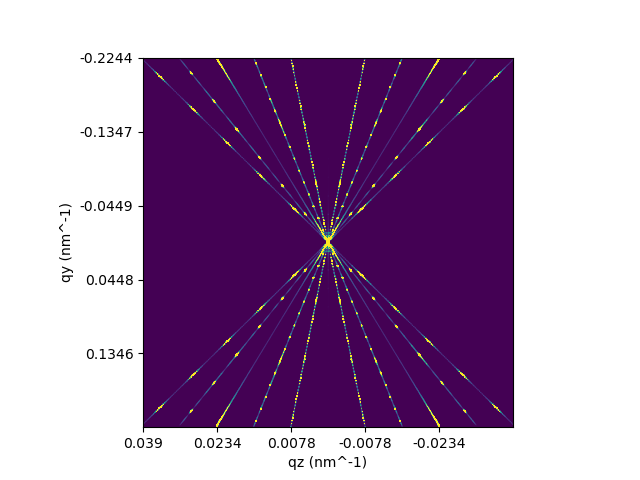

In [179]:
ax8 = plt.figure().add_subplot()
#ax8.set_aspect('equal',adjustable = 'box')
plt.imshow((heat+0.001),vmin = 0, vmax = 1000, interpolation = 'bilinear',origin = 'upper')
#plt.imshow(col)
#plt.imshow(np.log10(gridint+0.001))
#ax8.pcolormesh(res1)
#ax8.set_xlim(qang[0].min(),qang[0].max())
#ax8.set_ylim(yang[0].min(),yang[0].max())
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
#ax8.set_box_aspect(1)
xlabs = ax8.get_xticklabels()
ylabs = ax8.get_yticklabels()
newx = np.round(np.linspace(res1[0].min(),res1[0].max(),len(ylabs)+1),4)
newy = np.round(np.linspace(res1[1].min(),res1[1].max(),len(xlabs)+1),4)
revy = newy[::-1]
revx = newx[::-1]
print(revy)
print(newx)
print(xlabs)
ax8.set_xticklabels(revy)
ax8.set_yticklabels(newx)
#ax8.invert_yaxis()
#plt.colorbar()
#plt.axis('square')
plt.show()
#plt.tight_layout()
#-0.1 - 0.1 10 points

[ 0.011   0.0078  0.0047  0.0016 -0.0016 -0.0047 -0.0078 -0.011 ]
[-0.6284 -0.4489 -0.2693 -0.0898  0.0897  0.2692  0.4487  0.6283]
[Text(-200.0, 0, '−200'), Text(0.0, 0, '0'), Text(200.0, 0, '200'), Text(400.0, 0, '400'), Text(600.0, 0, '600'), Text(800.0, 0, '800'), Text(1000.0, 0, '1000')]


/tmp/ipykernel_3009550/2964569990.py:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax20.set_xticklabels(revy)
/tmp/ipykernel_3009550/2964569990.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax20.set_yticklabels(newx)


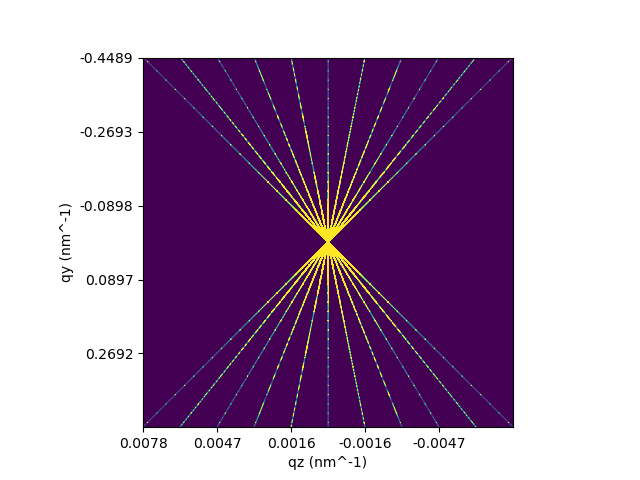

In [424]:
ax20 = plt.figure().add_subplot()
#ax8.set_aspect('equal',adjustable = 'box')
plt.imshow((heat+0.001),vmin = 0, vmax = 5e4, interpolation = 'bilinear',origin = 'upper')
#plt.imshow(col)
#plt.imshow(np.log10(gridint+0.001))
#ax8.pcolormesh(res1)
#ax8.set_xlim(qang[0].min(),qang[0].max())
#ax8.set_ylim(yang[0].min(),yang[0].max())
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
#ax8.set_box_aspect(1)
xlabs = ax20.get_xticklabels()
ylabs = ax20.get_yticklabels()
newx = np.round(np.linspace(res1[0].min(),res1[0].max(),len(ylabs)+1),4)
newy = np.round(np.linspace(res1[1].min(),res1[1].max(),len(xlabs)+1),4)
revy = newy[::-1]
revx = newx[::-1]
print(revy)
print(newx)
print(xlabs)
ax20.set_xticklabels(revy)
ax20.set_yticklabels(newx)
#ax8.invert_yaxis()
#plt.colorbar()
#plt.axis('square')
plt.show()
#plt.tight_layout()
#-1 - 1 10 points - [1000,5000]/rectangle

[ 0.011   0.0078  0.0047  0.0016 -0.0016 -0.0047 -0.0078 -0.011 ]
[-0.6284 -0.4489 -0.2693 -0.0898  0.0897  0.2692  0.4487  0.6283]
[Text(-200.0, 0, '−200'), Text(0.0, 0, '0'), Text(200.0, 0, '200'), Text(400.0, 0, '400'), Text(600.0, 0, '600'), Text(800.0, 0, '800'), Text(1000.0, 0, '1000')]


/tmp/ipykernel_806369/3811685188.py:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax20_1.set_xticklabels(revy)
/tmp/ipykernel_806369/3811685188.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax20_1.set_yticklabels(newx)


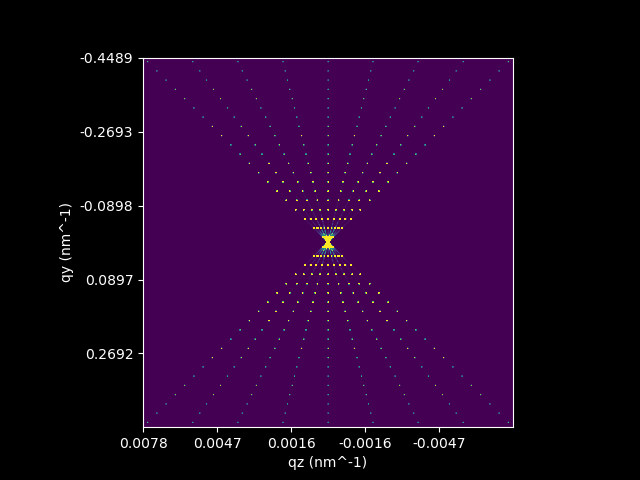

In [331]:
ax20_1 = plt.figure().add_subplot()
#ax8.set_aspect('equal',adjustable = 'box')
plt.imshow((heat+0.001),vmin = 0, vmax = 5e4, interpolation = 'bilinear',origin = 'upper')
#plt.imshow(col)
#plt.imshow(np.log10(gridint+0.001))
#ax8.pcolormesh(res1)
#ax8.set_xlim(qang[0].min(),qang[0].max())
#ax8.set_ylim(yang[0].min(),yang[0].max())
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
#ax8.set_box_aspect(1)
xlabs = ax20_1.get_xticklabels()
ylabs = ax20_1.get_yticklabels()
newx = np.round(np.linspace(res1[0].min(),res1[0].max(),len(ylabs)+1),4)
newy = np.round(np.linspace(res1[1].min(),res1[1].max(),len(xlabs)+1),4)
revy = newy[::-1]
revx = newx[::-1]
print(revy)
print(newx)
print(xlabs)
ax20_1.set_xticklabels(revy)
ax20_1.set_yticklabels(newx)
#ax8.invert_yaxis()
#plt.colorbar()
#plt.axis('square')
plt.show()
#plt.tight_layout()
#-1 - 1 7 points - [3000,5000]/rectangle - verify

In [ ]:
ax21 = plt.figure().add_subplot()
#ax8.set_aspect('equal',adjustable = 'box')
plt.imshow((heat+0.001),vmin = 0, vmax = 1e5, interpolation = 'bilinear',origin = 'upper')
#plt.imshow(col)
#plt.imshow(np.log10(gridint+0.001))
#ax8.pcolormesh(res1)
#ax8.set_xlim(qang[0].min(),qang[0].max())
#ax8.set_ylim(yang[0].min(),yang[0].max())
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
#ax8.set_box_aspect(1)
xlabs = ax21.get_xticklabels()
ylabs = ax21.get_yticklabels()
newx = np.round(np.linspace(res1[0].min(),res1[0].max(),len(ylabs)+1),4)
newy = np.round(np.linspace(res1[1].min(),res1[1].max(),len(xlabs)+1),4)
revy = newy[::-1]
revx = newx[::-1]
print(revy)
print(newx)
print(xlabs)
ax21.set_xticklabels(revy)
ax21.set_yticklabels(newx)
#ax8.invert_yaxis()
#plt.colorbar()
#plt.axis('square')
plt.show()
#plt.tight_layout()
#-10 - 10 10 points - [3000,5000]/trapezoid

[ 0.3142  0.2244  0.1347  0.0449 -0.0449 -0.1347 -0.2244 -0.3142]
[-0.6284 -0.4489 -0.2693 -0.0898  0.0897  0.2692  0.4487  0.6283]
[Text(-200.0, 0, '−200'), Text(0.0, 0, '0'), Text(200.0, 0, '200'), Text(400.0, 0, '400'), Text(600.0, 0, '600'), Text(800.0, 0, '800'), Text(1000.0, 0, '1000')]


/tmp/ipykernel_2372967/844064572.py:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax22.set_xticklabels(revy)
/tmp/ipykernel_2372967/844064572.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax22.set_yticklabels(newx)


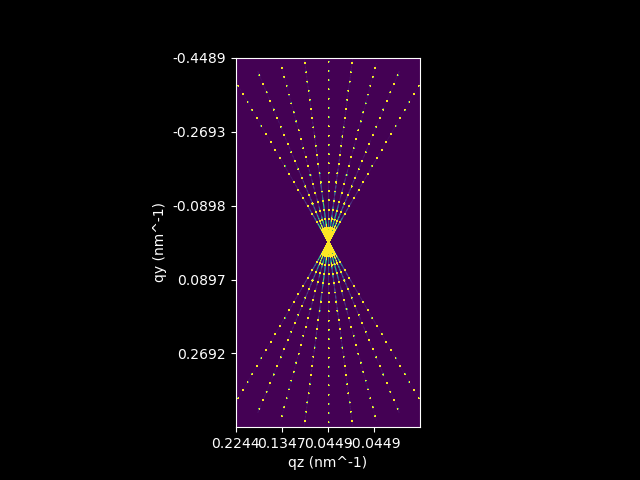

In [71]:
ax22 = plt.figure().add_subplot()
#ax8.set_aspect('equal',adjustable = 'box')
plt.imshow((heat+0.001),vmin = 0, vmax = 2500, interpolation = 'bilinear',origin = 'upper',aspect = '2')
#plt.imshow(col)
#plt.imshow(np.log10(gridint+0.001))
#ax8.pcolormesh(res1)
#ax8.set_xlim(qang[0].min(),qang[0].max())
#ax8.set_ylim(yang[0].min(),yang[0].max())
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
#ax8.set_box_aspect(1)
xlabs = ax22.get_xticklabels()
ylabs = ax22.get_yticklabels()
newx = np.round(np.linspace(res1[0].min(),res1[0].max(),len(ylabs)+1),4)
newy = np.round(np.linspace(res1[1].min(),res1[1].max(),len(xlabs)+1),4)
revy = newy[::-1]
revx = newx[::-1]
print(revy)
print(newx)
print(xlabs)
ax22.set_xticklabels(revy)
ax22.set_yticklabels(newx)
#ax8.invert_yaxis()
#plt.colorbar()
#plt.axis('square')
plt.show()
#plt.tight_layout()
#-40 - 40 9 points - [3000,5000]/trapezoid

[ 0.6274  0.4482  0.2689  0.0896 -0.0897 -0.2689 -0.4482 -0.6275]
[-0.0008 -0.0006 -0.0003 -0.0001  0.0002  0.0004  0.0006  0.0009]
[Text(-200.0, 0, '−200'), Text(0.0, 0, '0'), Text(200.0, 0, '200'), Text(400.0, 0, '400'), Text(600.0, 0, '600'), Text(800.0, 0, '800'), Text(1000.0, 0, '1000')]


/tmp/ipykernel_2900817/3002523370.py:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax20_2.set_xticklabels(revy)
/tmp/ipykernel_2900817/3002523370.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax20_2.set_yticklabels(newx)


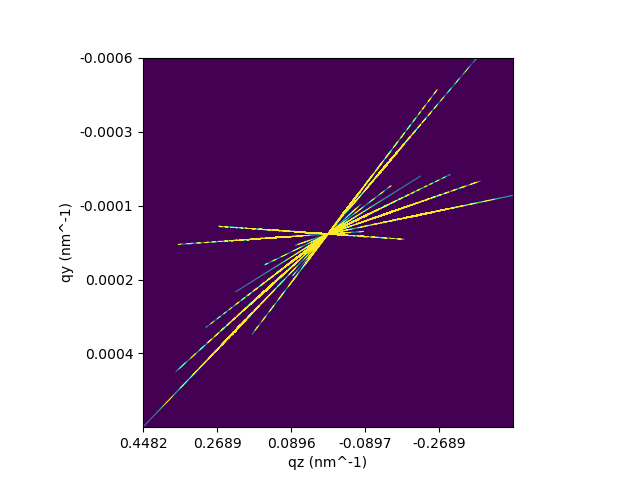

In [363]:
ax20_2 = plt.figure().add_subplot()
#ax8.set_aspect('equal',adjustable = 'box')
plt.imshow((heat+0.001),vmin = 0, vmax = 1.5e6, interpolation = 'bilinear',origin = 'upper')
#plt.imshow(col)
#plt.imshow(np.log10(gridint+0.001))
#ax8.pcolormesh(res1)
#ax8.set_xlim(qang[0].min(),qang[0].max())
#ax8.set_ylim(yang[0].min(),yang[0].max())
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
#ax8.set_box_aspect(1)
xlabs = ax20_2.get_xticklabels()
ylabs = ax20_2.get_yticklabels()
newx = np.round(np.linspace(res1[0].min(),res1[0].max(),len(ylabs)+1),4)
newy = np.round(np.linspace(res1[1].min(),res1[1].max(),len(xlabs)+1),4)
revy = newy[::-1]
revx = newx[::-1]
print(revy)
print(newx)
print(xlabs)
ax20_2.set_xticklabels(revy)
ax20_2.set_yticklabels(newx)
#ax8.invert_yaxis()
#plt.colorbar()
#plt.axis('square')
plt.show()
#plt.tight_layout()
#-0.1 - 0.1 10 points

In [65]:
x_ang

array([-40., -36., -32., -28., -24., -20., -16., -12.,  -8.,  -4.,   0.,
         4.,   8.,  12.,  16.,  20.,  24.,  28.,  32.,  36.,  40.])

TypeError: Dimensions of C (1000, 1000) should be one smaller than X(100000) and Y(100000) while using shading='flat' see help(pcolormesh)

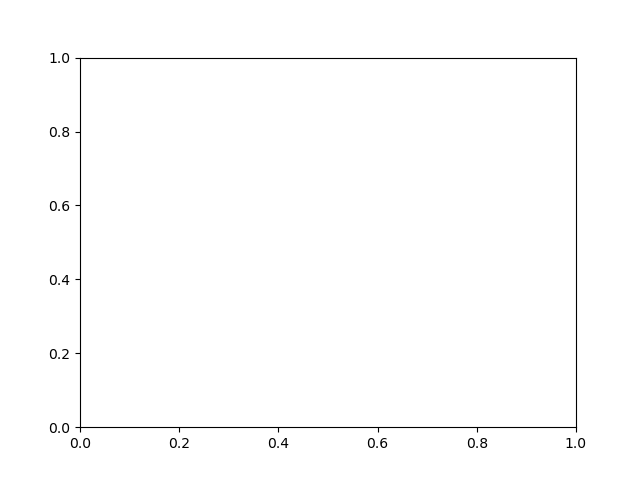

In [315]:
ax8 = plt.figure().add_subplot()
#ax8.set_aspect('equal',adjustable = 'box')
#plt.imshow((heat+0.001),vmin = 0, vmax = 1000, interpolation = 'bilinear',origin = 'upper')
#plt.imshow(col)
#plt.imshow(np.log10(gridint+0.001))
ax8.pcolormesh(res1[0],res1[2],col.reshape(1000,1000))
#ax8.set_xlim(qang[0].min(),qang[0].max())
#ax8.set_ylim(yang[0].min(),yang[0].max())
plt.xlabel('qz (nm^-1)')
plt.ylabel('qy (nm^-1)')
#ax8.set_box_aspect(1)
xlabs = ax8.get_xticklabels()
ylabs = ax8.get_yticklabels()
newx = np.round(np.linspace(res1[0].min(),res1[0].max(),len(ylabs)+1),4)
newy = np.round(np.linspace(res1[1].min(),res1[1].max(),len(xlabs)+1),4)
revy = newy[::-1]
revx = newx[::-1]
print(revy)
print(newx)
print(xlabs)
ax8.set_xticklabels(revy)
ax8.set_yticklabels(newx)
#ax8.invert_yaxis()
#plt.colorbar()
#plt.axis('square')
plt.show()
#plt.tight_layout()
#-1 - 1 10 points

In [85]:
zcol = np.c_[-1000:1000]

In [132]:
zplane = np.repeat(zcol,repeats = 4000,axis = 1)

In [133]:
zplane.shape

(2000, 4000)

In [ ]:
zcol = np.sin(np.deg2rad(-20))*zplane

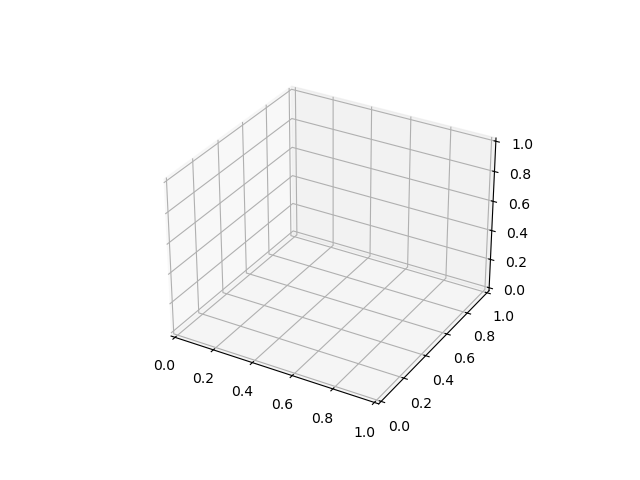

In [111]:
import matplotlib
ax = plt.figure().add_subplot(projection = '3d')
x,y = np.meshgrid(qang[0],yang[0])
zcolor = plotname[0].reshape(x.shape)
mini,maxi = zcolor.min(),zcolor.max()
norm = matplotlib.colors.Normalize(mini,maxi)
m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
color = m.to_rgba(zcolor)

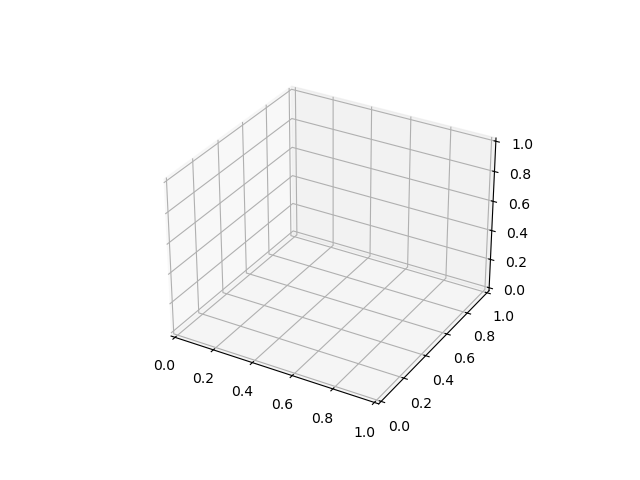

In [111]:
import matplotlib
ax = plt.figure().add_subplot(projection = '3d')
x,y = np.meshgrid(qang[0],yang[0])
zcolor = plotname[0].reshape(x.shape)
mini,maxi = zcolor.min(),zcolor.max()
norm = matplotlib.colors.Normalize(mini,maxi)
m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
color = m.to_rgba(zcolor)

[[0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 ...
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]]
[[0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 ...
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]]
[[0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 ...
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]]
[[0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 ...
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]
 [0.267004 0.004874 0.329415 1.      ]]
[[0.267004 0.004874 0.329415 1.      ]
 

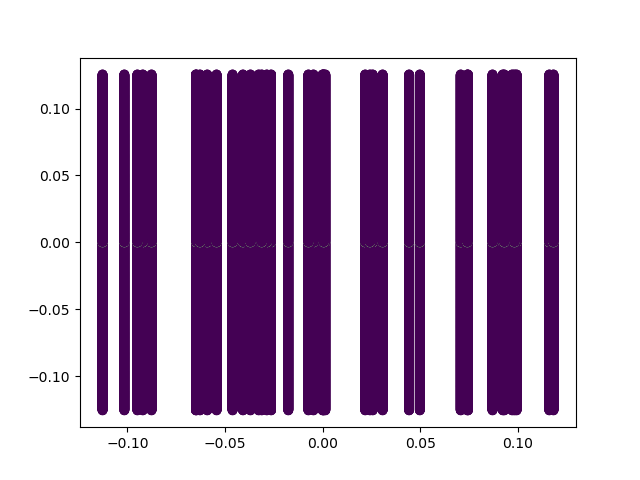

In [563]:
ax = plt.figure().add_subplot()
test = []
count = 0
for i in np.arange(len(plotname)):
    if count > -1:
        maxi = np.argmax(plotname[i],axis = 0)[0]
        x = np.asarray([qang[i][maxi]]*len(yang[i]))
        mini2,maxi2 = (plotname[i].min()),(plotname[i].max())
        #print(mini2)
        #print(maxi2)
    #print(maxi)
        norm2 =matplotlib.colors.Normalize(mini2,maxi2)
        m2 = cm.ScalarMappable(norm = norm2,cmap = 'viridis')

        scolor = m2.to_rgba((plotname[i][maxi,:]))
        print(scolor)
        #if count == 0:
        #    test = np.asarray([x,yang[i],np.log10([plotname[i][maxi,:]])])
        #else:
        #    np.concatenate((test,np.asarray([x,yang[i],np.log10([plotname[i][maxi,:]])])),axis = 1)
        #print(x)
        plt.scatter(x,yang[i],facecolors = scolor)
plt.show()

In [ ]:
print(len(test))

In [435]:
#res1 = np.concatenate((ressub1,ressub2),axis = 1)
#print(res1.shape)
#print(test.shape)
#print(test)
#test2 = np.asarray(test)
print(len(test))
heat,xedge,yedge = np.histogram2d(test2[0],test2[1], bins = 100,weights = test2[2])

41


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 3 dimensions. The detected shape was (2, 3, 2000) + inhomogeneous part.

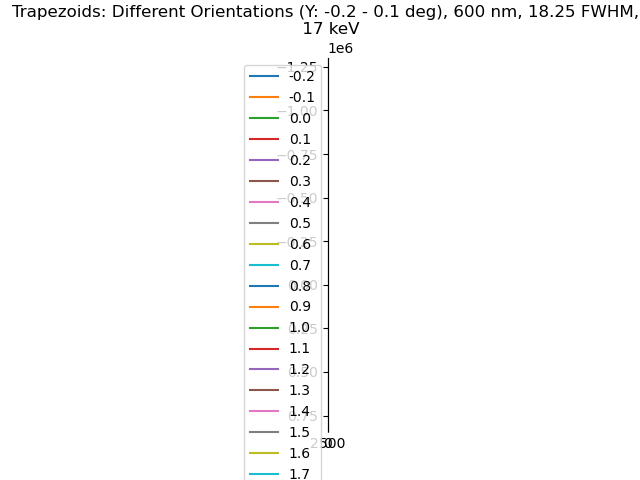

In [543]:
testft = np.fft.fftn(sample)
plt.plot(testft[75,:,:])
plt.show()

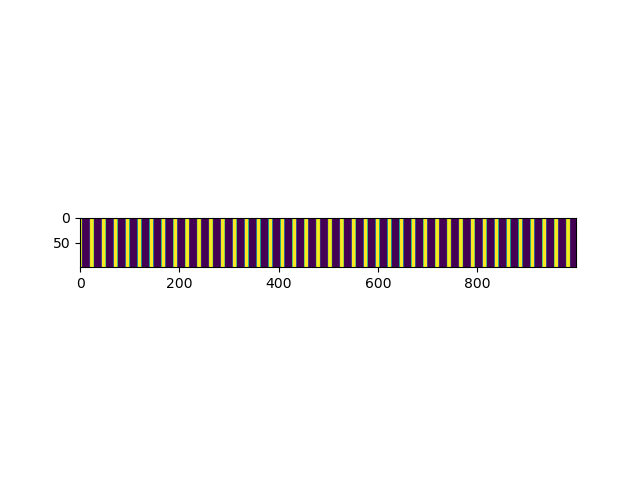

In [422]:
sample
ax3 = plt.figure().add_subplot()
plt.imshow(sample[60,:,:])
plt.show()

In [554]:
idx

72

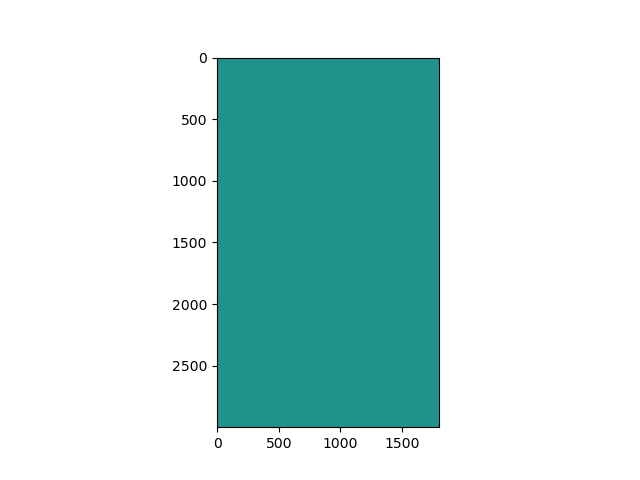

In [559]:
fig3 = plt.figure()
plt.imshow(np.fft.fftshift(testft[idx,:,:]).real)
plt.show()

In [169]:
mini,maxi = np.log10(plotname[0].min()),np.log10(plotname[0].max())
norm =matplotlib.colors.Normalize(mini,maxi)
m = cm.ScalarMappable(norm = norm,cmap = 'viridis')
colors = m.to_rgba(np.log10(zcolor))

## Result visualization

In [417]:
if True: 
    if flag_subonly: 
        print('Load wf_rec_subonly_*')
        wf_rec_amp = Read_tif(qtif[0])
        wf_rec_ph = Read_tif(angtif[0])
    else: 
        print('Load wf_rec_pillars_*')
        wf_rec_amp = Read_tif(qtif[0])
        wf_rec_ph = Read_tif(angtif[0])
else: 
    wf_rec_amp = np.abs(wf_rec)
    wf_rec_ph  = np.angle(wf_rec)
print(np.shape(wf_rec_amp))
print(np.shape(wf_rec_ph))
print(np.shape(sample))

Load wf_rec_pillars_*
(100, 1000, 10)
(100, 1000, 10)
(190, 100, 1000)


(100, 1000, 10)


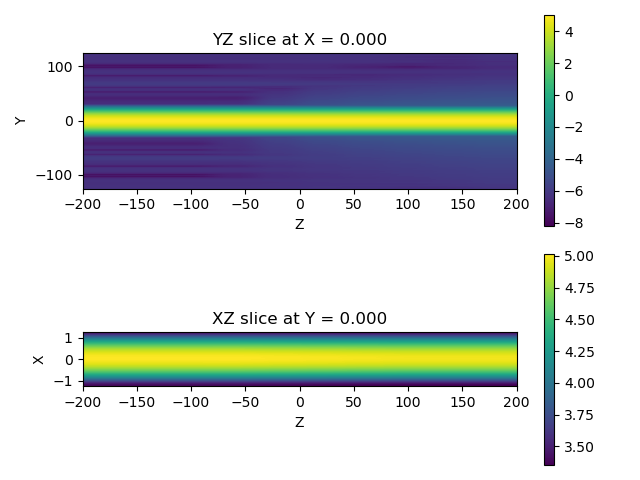

In [418]:
if True:   # 2D plot of wavefront 
    temp = wf_rec_amp
    lim_region = False
    plot_region = [-60, 60, -10, 10]
    print(temp.shape)
    plt.figure()#figsize=(10,4.5))
    plt.subplot(211)
    plt.imshow(np.log10(temp[50, :, :])#.transpose()
               , origin='lower', aspect = 0.5,
               extent=[-wave_prop_dist/1e3, wave_prop_dist/1e3, 
                       -np.shape(temp)[1]/2 * wave_grid_step[0] / 1e2, 
                        np.shape(temp)[1]/2 * wave_grid_step[0] / 1e2])
    if lim_region: 
        plt.axis(plot_region)
    plt.colorbar(); plt.title('YZ slice at X = %0.3f' %(gau_cen_offset[1]/1e3))
    plt.ylabel('Y'); plt.xlabel('Z')
    plt.tight_layout()
    plt.subplot(212)
    plt.imshow(np.log10(temp[:, int(np.shape(temp)[1]/2 + gau_cen_offset[0]/wave_grid_step[0]), :])#.transpose()
               , origin='lower', aspect = 20,
               extent=[-wave_prop_dist/1e3, wave_prop_dist/1e3, 
                       -np.shape(temp)[2]/2 * wave_grid_step[1] / 1e2, 
                        np.shape(temp)[2]/2 * wave_grid_step[1] / 1e2])
    if lim_region: 
        plt.axis(plot_region)
    plt.colorbar(); plt.title('XZ slice at Y = %0.3f' %(gau_cen_offset[0]/1e3))
    plt.ylabel('X'); plt.xlabel('Z')
    plt.tight_layout()
    del temp, plot_region, lim_region

[Text(-2.0, 0, '−2'), Text(0.0, 0, '0'), Text(2.0, 0, '2'), Text(4.0, 0, '4'), Text(6.0, 0, '6'), Text(8.0, 0, '8'), Text(10.0, 0, '10')]
[Text(0, -200.0, '−200'), Text(0, 0.0, '0'), Text(0, 200.0, '200'), Text(0, 400.0, '400'), Text(0, 600.0, '600'), Text(0, 800.0, '800'), Text(0, 1000.0, '1000')]


/tmp/ipykernel_3615966/1821799318.py:18: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labx)
/tmp/ipykernel_3615966/1821799318.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(laby)


IndexError: index 24 is out of bounds for axis 2 with size 10

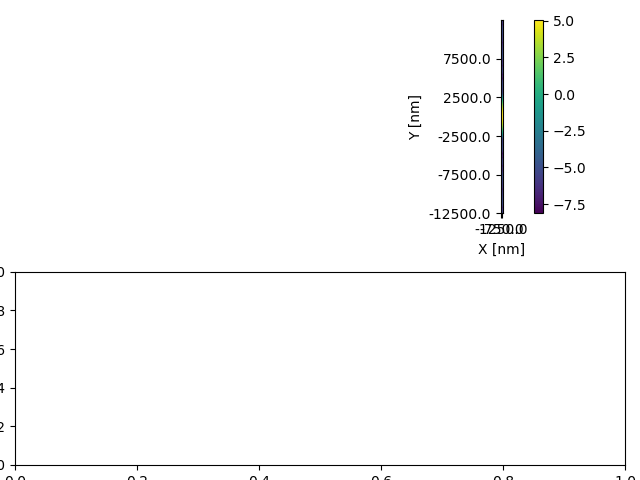

In [381]:
plt.figure()   # figsize = (12,3)
ax = plt.subplot(211)
temp = wf_rec_amp
plt.imshow(np.log10(temp[50, :, :])#.transpose()
           , origin='lower', aspect=1, 
               #extent=[-wave_prop_dist/1e3, wave_prop_dist/1e3, 
                #       -np.shape(temp)[2]/2 * wave_grid_step[1] / 1e2, 
                 #       np.shape(temp)[2]/2 * wave_grid_step[1] / 1e2]
          )
plt.ylabel('Y [nm]')
plt.xlabel('X [nm]')
xlabs = ax.get_xticklabels()
ylabs = ax.get_yticklabels()
print(xlabs)
print(ylabs)
labx = np.round(np.linspace(-(temp.shape[0])*wave_grid_step[0]/2 - temp.shape[0]*wave_grid_step[0]/(len(xlabs)-2), (temp.shape[0])*wave_grid_step[0]/2,len(xlabs)),1)
laby = np.round(np.linspace(-(temp.shape[1])*wave_grid_step[1]/2 - (temp.shape[1])*wave_grid_step[1]/(len(xlabs)-2), (temp.shape[1])*wave_grid_step[1]/2,len(xlabs)),1)
ax.set_xticklabels(labx)
ax.set_yticklabels(laby)
plt.colorbar();plt.tight_layout()

ax2 = plt.subplot(212)
temp = wf_rec_ph
plt.imshow((temp[:, :, 24])#.transpose(), origin='lower', 
               #extent=[-wave_prop_dist/1e3, wave_prop_dist/1e3, 
                #       -np.shape(temp)[2]/2 * wave_grid_step[1] / 1e2, 
                 #       np.shape(temp)[2]/2 * wave_grid_step[1] / 1e2]
          )
plt.ylabel('Y [nm]')
plt.xlabel('X [nm]')
xlabs = ax2.get_xticklabels()
ylabs = ax2.get_yticklabels()
print(xlabs)
print(ylabs)
ax2.set_xticklabels(labx)
ax2.set_yticklabels(laby)

plt.colorbar();plt.tight_layout()
plt.show()

In [9]:
result = Read_tif('result_ptychoscans_3c_nobs.tif')
print('result size: ', np.shape(result))
result_conv = Read_tif('result_ptychoscans_3c_nobs_conv.tif')
print('result_conv size: ', np.shape(result_conv))
sample_record = Read_tif('sample_record_ptychoscans_3c.tif')
print('sample_record size: ', np.shape(sample_record))

print('Total counts in result: %g' %np.sum(result[0,:,:]))
print('Total counts in result_conv: %g' %np.sum(result_conv[0,:,:]))
print('Ratio between the two: ', np.sum(result_conv[1,:,:])/np.sum(result[1,:,:]))

result size:  (29, 2000, 2000)
result_conv size:  (29, 2000, 2000)
sample_record size:  (29, 5001, 5001)
Total counts in result: 9.95922e+11
Total counts in result_conv: 9.95922e+11
Ratio between the two:  0.9999998736277518


In [27]:
result_conv = np.concatenate([np.concatenate([Read_tif('result_ptychoscans_nobs_conv-1.tif'), 
                                              Read_tif('result_ptychoscans_nobs_conv-2.tif')]), 
                              Read_tif('result_ptychoscans_nobs_conv-3.tif')])
print(np.shape(result_conv))
result_ref = Read_tif('result_ptychoscans_ref_nobs_conv.tif')

(29, 2000, 2000)


In [28]:
# result_ref = result_conv[:10,:,:].copy()
result_conv = np.random.poisson(result_conv)
# Save_tif(result_ref, 'result_ptychoscans_ref_nobs.tif', OverWrite=True)

In [29]:
for i in range(np.shape(result_conv)[0]): 
    temp = Array_radial_integration_2D(result_conv[i,:,:])
    if i == 0: 
        result_conv_intax = np.zeros((np.shape(result_conv)[0], np.size(temp['result'])))
        result_conv_int = np.zeros_like(result_conv_intax)
    result_conv_intax[i, :] = temp['bins'][:-1]
    result_conv_int[i, :] = temp['result']
for i in range(np.shape(result_ref)[0]): 
    temp = Array_radial_integration_2D(result_ref[i,:,:])
    if i == 0: 
        result_ref_intax = np.zeros((np.shape(result_ref)[0], np.size(temp['result'])))
        result_ref_int = np.zeros_like(result_ref_intax)
    result_ref_intax[i, :] = temp['bins'][:-1]
    result_ref_int[i, :] = temp['result']

result_conv_intdiff = np.zeros_like(result_conv_intax)
for i in range(10): 
    result_conv_intdiff[i, :]    = result_conv_int[i, :]    - result_ref_int[i, :]
    result_conv_intdiff[i+10, :] = result_conv_int[i+10, :] - result_ref_int[i, :]
    if i != 9: 
        result_conv_intdiff[i+20, :] = result_conv_int[i+20, :] - result_ref_int[i, :]

In [30]:
q_ax = result_conv_intax[0] / grid_size[1] / (farf_prop_size[1]-1) * bin_size[1] * 1000

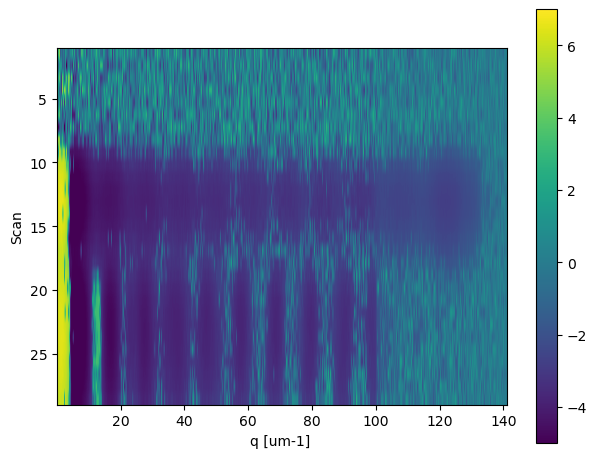

In [31]:
plt.figure()
temp = np.sign(result_conv_intdiff)*np.log10(1+np.abs(result_conv_intdiff))
plt.imshow(temp, extent=[np.min(q_ax), np.max(q_ax), 29, 1], aspect=4, vmin=-5, vmax=7)
plt.colorbar()
plt.xlabel('q [um-1] ')
plt.ylabel('Scan')
plt.tight_layout()